In [1]:
import cv2
import os
import numpy as np
from PIL import Image
  
# importing library for plotting
from matplotlib import pyplot as plt

scene="office"

path0="./out/"+scene+"/raw_cam2/"
dir_path=path0+'img3D/'
dir_path0=path0+'img/'

alphaH=3


times=[]
for path in os.listdir(dir_path0):
    # check if current path is a file
    if os.path.isfile(os.path.join(dir_path0, path)) and not '_' in path:
        times.append(path.replace('.jpg',''))
times.sort()
print(times)

['1687446214', '1687446215', '1687446216', '1687446217', '1687446218', '1687446219', '1687446220', '1687446221', '1687446222', '1687446223', '1687446224', '1687446225', '1687446226', '1687446227', '1687446228', '1687446229', '1687446230', '1687446231', '1687446232', '1687446233', '1687446234', '1687446235', '1687446236', '1687446237', '1687446238', '1687446239', '1687446240', '1687446241', '1687446242', '1687446243', '1687446244', '1687446245', '1687446246', '1687446247', '1687446248', '1687446249', '1687446250', '1687446254', '1687446255', '1687446256', '1687446257', '1687446258', '1687446259', '1687446260', '1687446261', '1687446262', '1687446263', '1687446264', '1687446265', '1687446266', '1687446267', '1687446268', '1687446269', '1687446270', '1687446271', '1687446272', '1687446273', '1687446274', '1687446275', '1687446276', '1687446277', '1687446278', '1687446279', '1687446280', '1687446281', '1687446282', '1687446283', '1687446284', '1687446285', '1687446286', '1687446287', '1687

In [2]:
import pandas as pd

import matplotlib.pyplot as plt


from tensorflow.keras.utils import img_to_array
from keras.applications.imagenet_utils import preprocess_input

def resizeAndPad(img, size, padColor=[192, 192, 192]):
    h, w = img.shape[:2]
    sh, sw = size

    # interpolation method
    if h > sh or w > sw:  # shrinking image
        interp = cv2.INTER_AREA
    else:  # stretching image
        interp = cv2.INTER_CUBIC

    # aspect ratio of image
    aspect = float(w) / h
    saspect = float(sw) / sh

    if (saspect > aspect) or ((saspect == 1) and (aspect <= 1)):  # new horizontal image
        new_h = sh
        new_w = np.round(new_h * aspect).astype(int)
        pad_horz = float(sw - new_w) / 2
        pad_left, pad_right = np.floor(pad_horz).astype(int), np.ceil(pad_horz).astype(int)
        pad_top, pad_bot = 0, 0

    elif (saspect < aspect) or ((saspect == 1) and (aspect >= 1)):  # new vertical image
        new_w = sw
        new_h = np.round(float(new_w) / aspect).astype(int)
        pad_vert = float(sh - new_h) / 2
        pad_top, pad_bot = np.floor(pad_vert).astype(int), np.ceil(pad_vert).astype(int)
        pad_left, pad_right = 0, 0

    # set pad color
    if len(img.shape) == 2 and not isinstance(padColor, (list, tuple, np.ndarray)):
        padColor = [padColor]

    # scale and pad
    scaled_img = cv2.resize(img, (new_w, new_h), interpolation=interp)

    # pad each channel separately
    padded_img = np.zeros((sh, sw, img.shape[2]), dtype=np.uint8)
    for i in range(img.shape[2]):
        padded_img[:, :, i] = np.pad(scaled_img[:, :, i], ((pad_top, pad_bot), (pad_left, pad_right)), mode='constant', constant_values=padColor[i])

    return padded_img


from tensorflow.keras.applications.resnet50 import ResNet50

model = ResNet50(weights='imagenet', include_top=False)

# Step 2: Load and preprocess your RGB image
def load_and_preprocess_image(img):
    #img = cv2.imread(image_path)
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    #img = cv2.resize(img, (224, 224))  # Resize to the input size required by ResNet50
    img = resizeAndPad(img,(224, 224))
    print("img.shape 1:",str(img.shape))
    plt.imshow(img)
    plt.show()    
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = preprocess_input(img)
    return img



# Step 3: Add the flatten layer to the model
from keras.layers import Flatten
from keras.models import Model

x = model.layers[-1].output
x = Flatten()(x)
model_flatten = Model(inputs=model.input, outputs=x)


def getH(img):
    input_img=load_and_preprocess_image(img)

    # Step 4: Pass the image through the model to get the flattened feature vector
    flattened_feature_vector = model_flatten.predict(input_img)

    # Display the shape of the flattened feature vector
    print("Shape of the flattened feature vector:", flattened_feature_vector.shape, flattened_feature_vector)
    return flattened_feature_vector



In [3]:
colors = ('b','g','r')
  
gray_zone=range(185,205)

def getH2(img):
    

    # find frequency of pixels in range 0-255
    # compute and plot the image histograms
    hrgb=[]
    for i,color in enumerate(colors):
        hist = cv2.calcHist([img],[i],None,[256],[0,256])
        hrgb.append(hist)
        for j in gray_zone:
            hist[j]=[0]
        #plt.plot(hist,color = color)
        #plt.show()
    hrgb=np.array(hrgb)
    return hrgb

In [4]:
from sklearn.metrics import mean_squared_error
import math
from numpy.linalg import norm
 
def sim(A,B):   
    A0=A.flatten()
    B0=B.flatten()
    #return np.dot(A0,B0)/(norm(A0)*norm(B0))
    return (mean_squared_error(A0, B0))

def closerH(usersH, h):
    iV=[]
    for ix,h2 in enumerate(usersH):
        iV.append(sim(h2,h))

    iV=np.array(iV)
    return iV

1687446214 ['./out/office/raw_cam2/img3D\\1687446214_10.jpg', './out/office/raw_cam2/img3D\\1687446214_11.jpg']
./out/office/raw_cam2/img/1687446214*10_person.jpg
img.shape 0: (71, 54, 3) 1.3148148148148149
bad image size: 1.3148148148148149
./out/office/raw_cam2/img/1687446214*11_person.jpg
img.shape 0: (187, 95, 3) 1.9684210526315788
new users: 2
img.shape 1: (224, 224, 3)


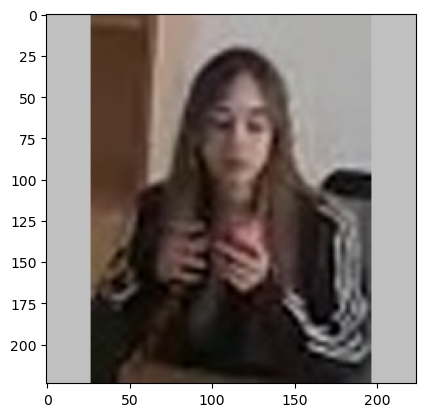

1/1 [==============================] - 1s 560ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([4., 4.])]
img.shape 1: (224, 224, 3)


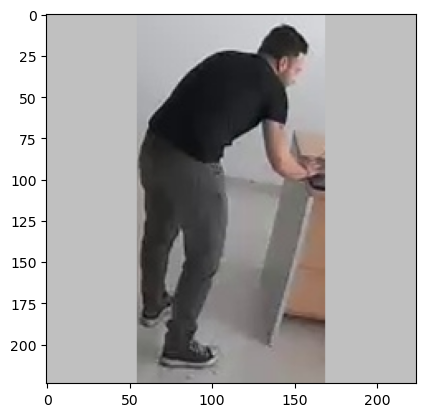

1/1 [==============================] - 0s 74ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([4., 4.]), array([4., 4.])]
[[4. 4.]
 [4. 4.]]
user: (0, 0) 4.0


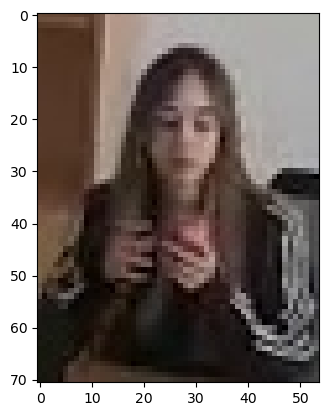

New user!
hs- [[1.e+05 1.e+05]
 [1.e+05 4.e+00]]
user: (1, 1) 4.0


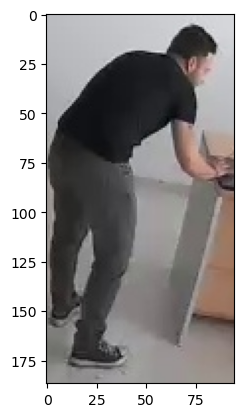

New user!
hs- [[100000. 100000.]
 [100000. 100000.]]
1687446215 ['./out/office/raw_cam2/img3D\\1687446215_10.jpg', './out/office/raw_cam2/img3D\\1687446215_11.jpg']
./out/office/raw_cam2/img/1687446215*10_person.jpg
img.shape 0: (70, 58, 3) 1.206896551724138
bad image size: 1.206896551724138
./out/office/raw_cam2/img/1687446215*11_person.jpg
img.shape 0: (186, 96, 3) 1.9375
new users: 0
img.shape 1: (224, 224, 3)


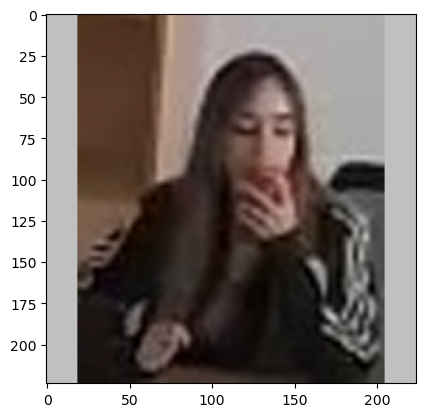

1/1 [==============================] - 0s 62ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.74868882, 4.12135792])]
img.shape 1: (224, 224, 3)


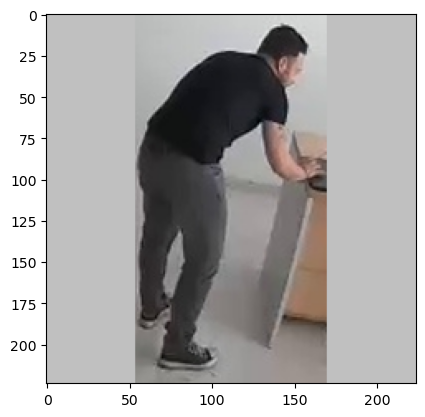

1/1 [==============================] - 0s 64ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.74868882, 4.12135792]), array([3.6202116 , 0.34625891])]
[[1.74868882 4.12135792]
 [3.6202116  0.34625891]]
user: (1, 1) 0.34625890851020813


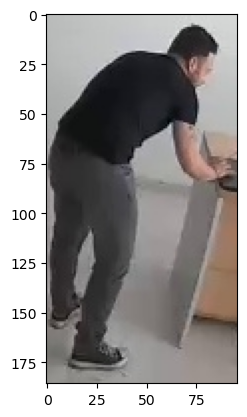

hs- [[1.74868882e+00 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05]]
user: (0, 0) 1.748688817024231


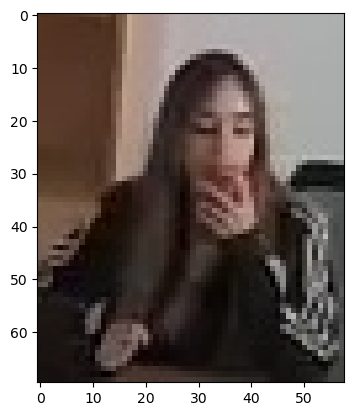

hs- [[100000. 100000.]
 [100000. 100000.]]
1687446216 ['./out/office/raw_cam2/img3D\\1687446216_10.jpg', './out/office/raw_cam2/img3D\\1687446216_11.jpg']
./out/office/raw_cam2/img/1687446216*10_person.jpg
img.shape 0: (71, 57, 3) 1.2456140350877194
bad image size: 1.2456140350877194
./out/office/raw_cam2/img/1687446216*11_person.jpg
img.shape 0: (186, 96, 3) 1.9375
new users: 0
img.shape 1: (224, 224, 3)


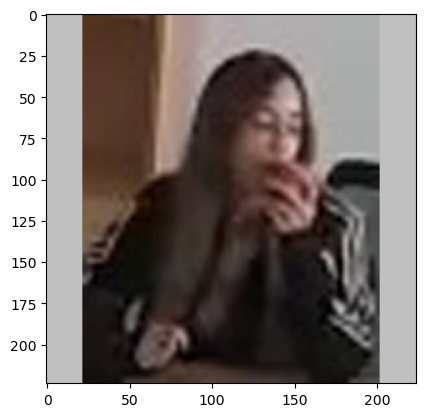

1/1 [==============================] - 0s 65ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.99583691, 3.84379292])]
img.shape 1: (224, 224, 3)


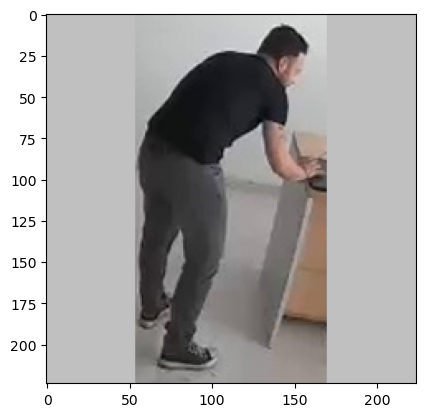

1/1 [==============================] - 0s 54ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.99583691, 3.84379292]), array([3.58631468, 0.0440403 ])]
[[0.99583691 3.84379292]
 [3.58631468 0.0440403 ]]
user: (1, 1) 0.04404030367732048


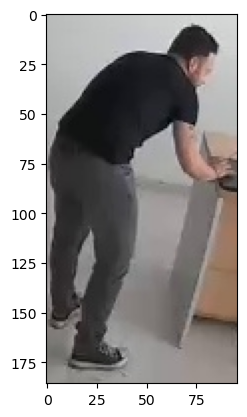

hs- [[9.95836914e-01 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05]]
user: (0, 0) 0.9958369135856628


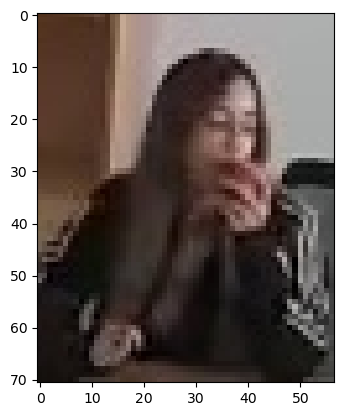

hs- [[100000. 100000.]
 [100000. 100000.]]
1687446217 ['./out/office/raw_cam2/img3D\\1687446217_12.jpg', './out/office/raw_cam2/img3D\\1687446217_13.jpg', './out/office/raw_cam2/img3D\\1687446217_5.jpg']
./out/office/raw_cam2/img/1687446217*12_person.jpg
img.shape 0: (75, 61, 3) 1.2295081967213115
bad image size: 1.2295081967213115
./out/office/raw_cam2/img/1687446217*13_person.jpg
img.shape 0: (186, 94, 3) 1.9787234042553192
./out/office/raw_cam2/img/1687446217*5_person.jpg
img.shape 0: (169, 66, 3) 2.5606060606060606
new users: 1
img.shape 1: (224, 224, 3)


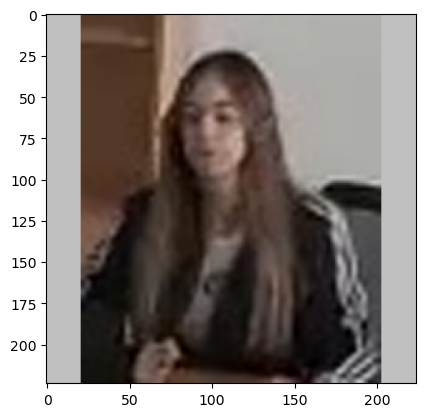

1/1 [==============================] - 0s 80ms/step
Shape of the flattened feature vector: (1, 100352) [[0.       0.       0.       ... 0.       0.       2.768578]]
[array([1.77702498, 3.66508865, 4.        ])]
img.shape 1: (224, 224, 3)


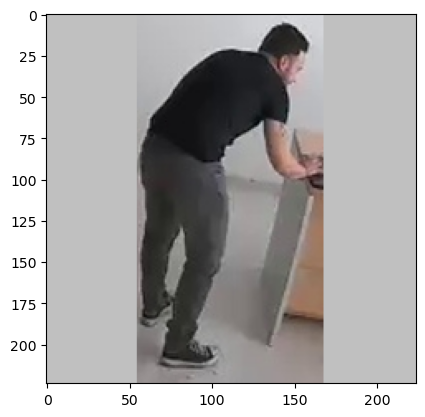

1/1 [==============================] - 0s 83ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.77702498, 3.66508865, 4.        ]), array([3.9399178 , 0.39637184, 4.        ])]
img.shape 1: (224, 224, 3)


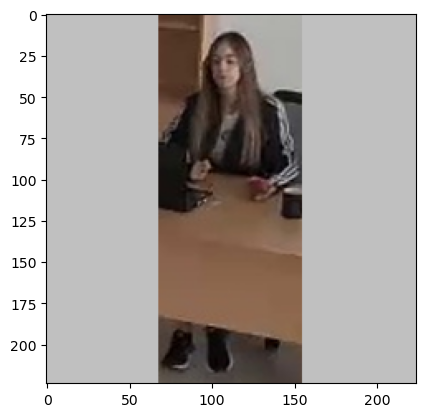

1/1 [==============================] - 0s 111ms/step
Shape of the flattened feature vector: (1, 100352) [[0.        0.        0.        ... 0.1351186 0.        0.       ]]
[array([1.77702498, 3.66508865, 4.        ]), array([3.9399178 , 0.39637184, 4.        ]), array([3.63061905, 3.61836672, 4.        ])]
[[1.77702498 3.66508865 4.        ]
 [3.9399178  0.39637184 4.        ]
 [3.63061905 3.61836672 4.        ]]
user: (1, 1) 0.39637184143066406


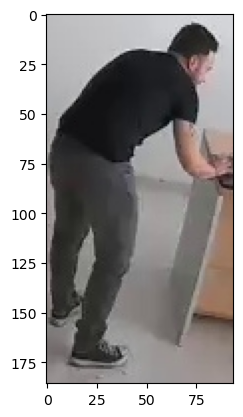

hs- [[1.77702498e+00 1.00000000e+05 4.00000000e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.63061905e+00 1.00000000e+05 4.00000000e+00]]
user: (0, 0) 1.7770249843597412


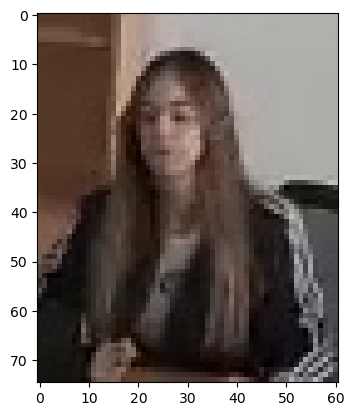

hs- [[1.e+05 1.e+05 1.e+05]
 [1.e+05 1.e+05 1.e+05]
 [1.e+05 1.e+05 4.e+00]]
user: (2, 2) 4.0


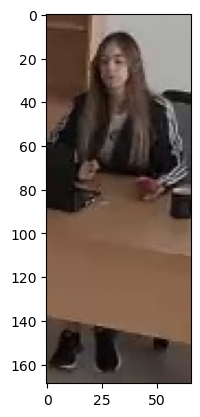

New user!
hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446218 ['./out/office/raw_cam2/img3D\\1687446218_11.jpg', './out/office/raw_cam2/img3D\\1687446218_3.jpg', './out/office/raw_cam2/img3D\\1687446218_9.jpg']
./out/office/raw_cam2/img/1687446218*11_person.jpg
img.shape 0: (185, 92, 3) 2.010869565217391
./out/office/raw_cam2/img/1687446218*3_person.jpg
img.shape 0: (171, 58, 3) 2.9482758620689653
./out/office/raw_cam2/img/1687446218*9_person.jpg
img.shape 0: (76, 52, 3) 1.4615384615384615
bad image size: 1.4615384615384615
new users: 0
img.shape 1: (224, 224, 3)


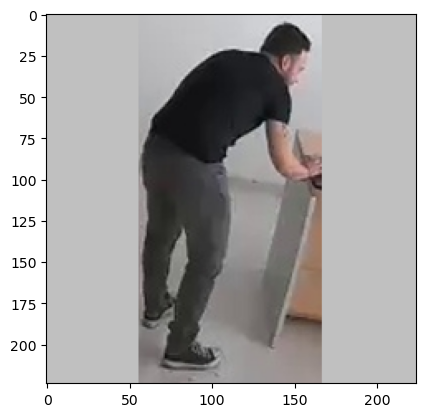

1/1 [==============================] - 0s 106ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.56555486, 0.21163857, 3.79328132])]
img.shape 1: (224, 224, 3)


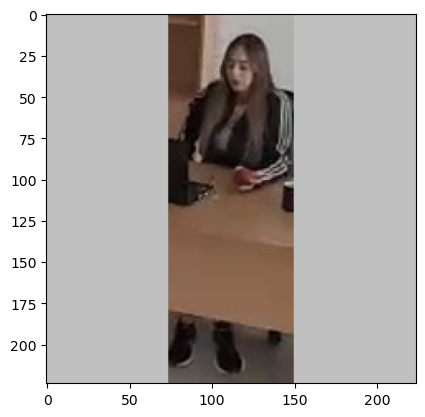

1/1 [==============================] - 0s 103ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.56555486, 0.21163857, 3.79328132]), array([2.94244552, 3.17849088, 1.06120062])]
img.shape 1: (224, 224, 3)


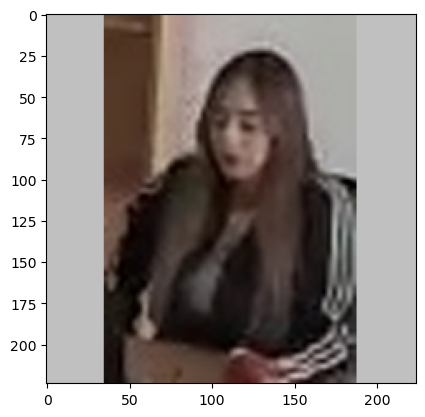

1/1 [==============================] - 0s 105ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.56555486, 0.21163857, 3.79328132]), array([2.94244552, 3.17849088, 1.06120062]), array([1.30915427, 3.90213323, 3.6123476 ])]
[[3.56555486 0.21163857 3.79328132]
 [2.94244552 3.17849088 1.06120062]
 [1.30915427 3.90213323 3.6123476 ]]
user: (0, 1) 0.21163856983184814


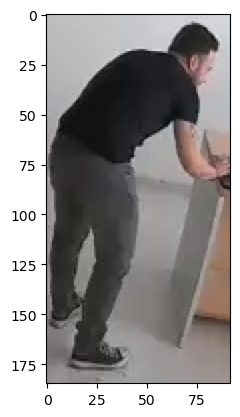

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [2.94244552e+00 1.00000000e+05 1.06120062e+00]
 [1.30915427e+00 1.00000000e+05 3.61234760e+00]]
user: (1, 2) 1.0612006187438965


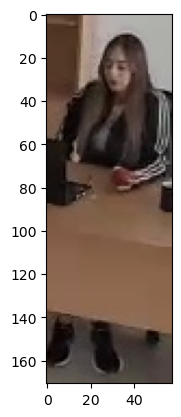

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.30915427e+00 1.00000000e+05 1.00000000e+05]]
user: (2, 0) 1.3091542720794678


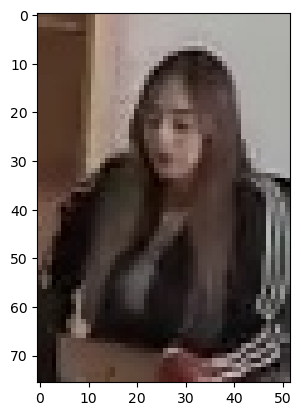

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446219 ['./out/office/raw_cam2/img3D\\1687446219_13.jpg', './out/office/raw_cam2/img3D\\1687446219_14.jpg']
./out/office/raw_cam2/img/1687446219*13_person.jpg
img.shape 0: (82, 48, 3) 1.7083333333333333
bad image size: 1.7083333333333333
./out/office/raw_cam2/img/1687446219*14_person.jpg
img.shape 0: (187, 96, 3) 1.9479166666666667
new users: -1
img.shape 1: (224, 224, 3)


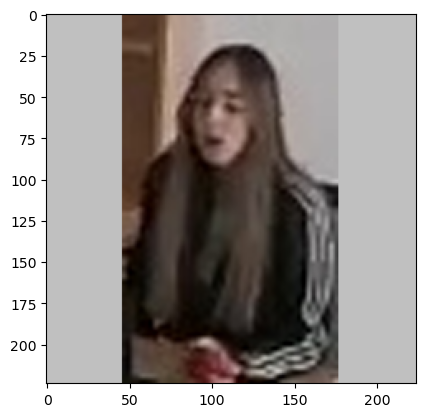

1/1 [==============================] - 0s 113ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.17216635, 3.59516835, 2.79670906])]
img.shape 1: (224, 224, 3)


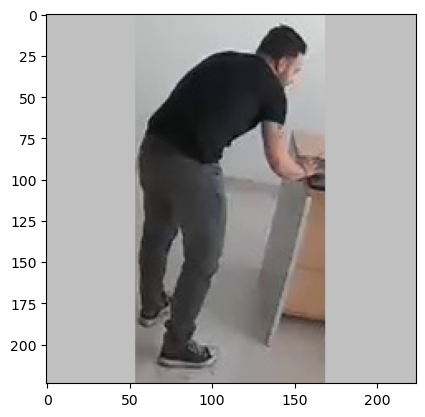

1/1 [==============================] - 0s 115ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.17216635, 3.59516835, 2.79670906]), array([3.60012317, 0.44691646, 3.16231203])]
[[1.17216635 3.59516835 2.79670906]
 [3.60012317 0.44691646 3.16231203]]
user: (1, 1) 0.44691646099090576


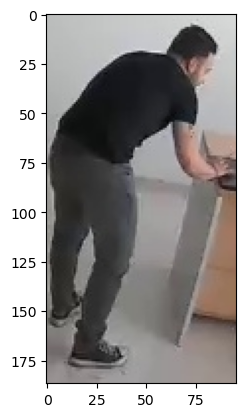

hs- [[1.17216635e+00 1.00000000e+05 2.79670906e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 1.172166347503662


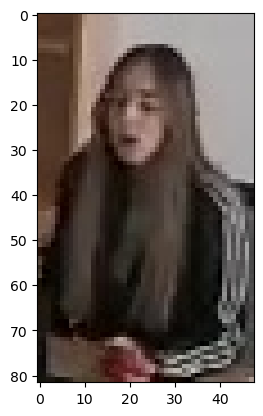

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446220 ['./out/office/raw_cam2/img3D\\1687446220_12.jpg', './out/office/raw_cam2/img3D\\1687446220_14.jpg']
./out/office/raw_cam2/img/1687446220*12_person.jpg
img.shape 0: (84, 60, 3) 1.4
bad image size: 1.4
./out/office/raw_cam2/img/1687446220*14_person.jpg
img.shape 0: (187, 95, 3) 1.9684210526315788
new users: -1
img.shape 1: (224, 224, 3)


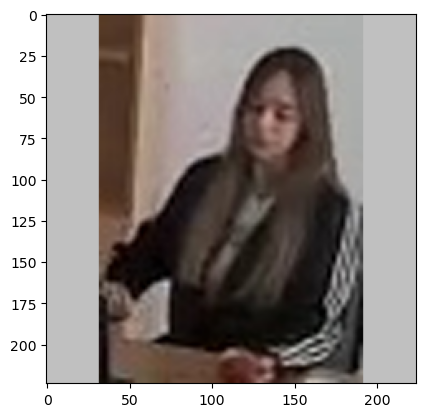

1/1 [==============================] - 0s 102ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.46366978, 3.85146761, 3.24323392])]
img.shape 1: (224, 224, 3)


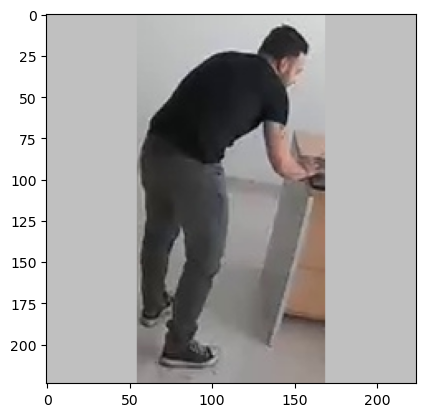

1/1 [==============================] - 0s 107ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.46366978, 3.85146761, 3.24323392]), array([3.40957403, 0.11383808, 3.15375805])]
[[1.46366978 3.85146761 3.24323392]
 [3.40957403 0.11383808 3.15375805]]
user: (1, 1) 0.1138380765914917


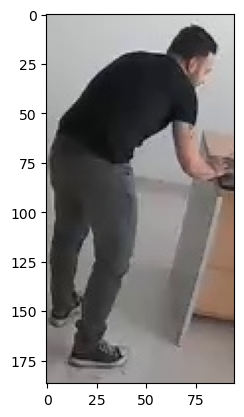

hs- [[1.46366978e+00 1.00000000e+05 3.24323392e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 1.463669776916504


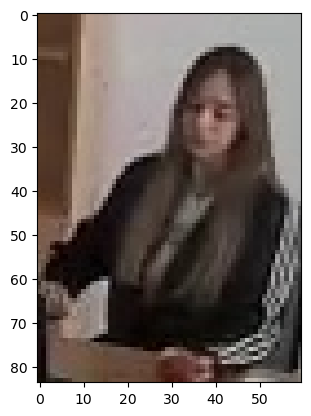

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446221 ['./out/office/raw_cam2/img3D\\1687446221_11.jpg', './out/office/raw_cam2/img3D\\1687446221_13.jpg']
./out/office/raw_cam2/img/1687446221*11_person.jpg
img.shape 0: (69, 69, 3) 1.0
bad image size: 1.0
./out/office/raw_cam2/img/1687446221*13_person.jpg
img.shape 0: (187, 95, 3) 1.9684210526315788
new users: -1
img.shape 1: (224, 224, 3)


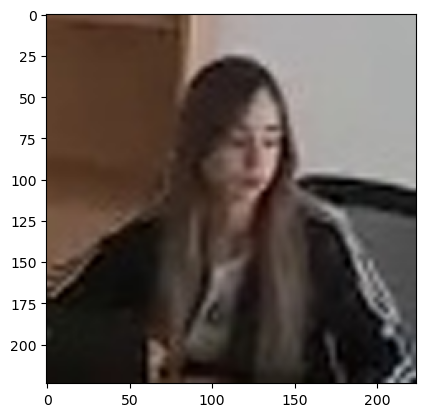

1/1 [==============================] - 0s 113ms/step
Shape of the flattened feature vector: (1, 100352) [[0.        0.        0.        ... 0.        2.8360116 0.       ]]
[array([2.85473061, 4.98342133, 4.32672071])]
img.shape 1: (224, 224, 3)


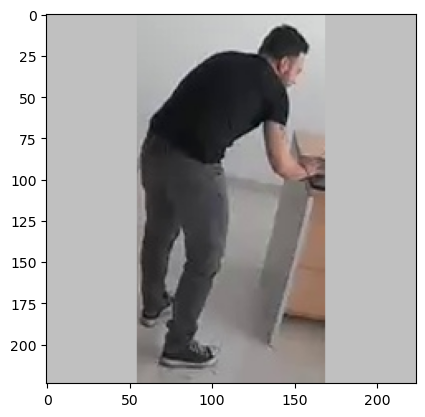

1/1 [==============================] - 0s 98ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.85473061, 4.98342133, 4.32672071]), array([3.51366162, 0.23688082, 3.15899158])]
[[2.85473061 4.98342133 4.32672071]
 [3.51366162 0.23688082 3.15899158]]
user: (1, 1) 0.236880823969841


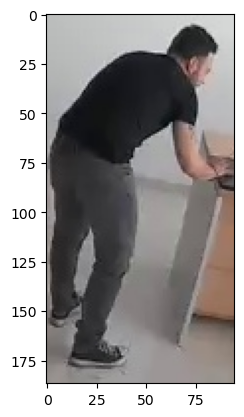

hs- [[2.85473061e+00 1.00000000e+05 4.32672071e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 2.8547306060791016


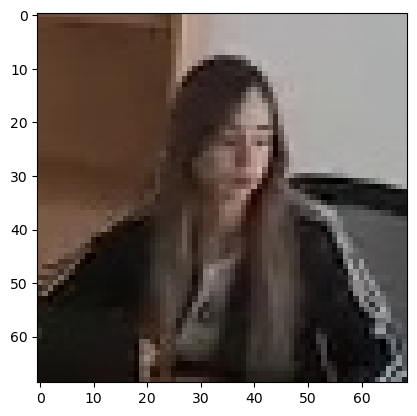

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446222 ['./out/office/raw_cam2/img3D\\1687446222_10.jpg', './out/office/raw_cam2/img3D\\1687446222_5.jpg', './out/office/raw_cam2/img3D\\1687446222_7.jpg']
./out/office/raw_cam2/img/1687446222*10_person.jpg
img.shape 0: (228, 88, 3) 2.590909090909091
./out/office/raw_cam2/img/1687446222*5_person.jpg
img.shape 0: (74, 66, 3) 1.121212121212121
bad image size: 1.121212121212121
./out/office/raw_cam2/img/1687446222*7_person.jpg
img.shape 0: (169, 64, 3) 2.640625
new users: 0
img.shape 1: (224, 224, 3)


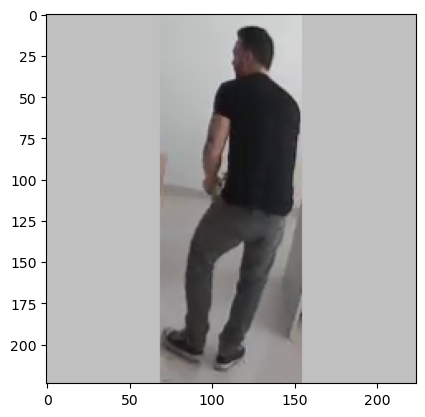

1/1 [==============================] - 0s 105ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.36525965, 2.00352693, 2.54382205])]
img.shape 1: (224, 224, 3)


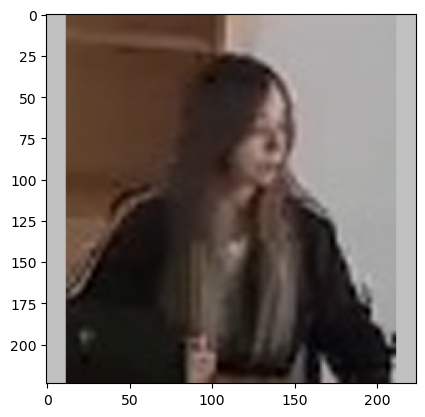

1/1 [==============================] - 0s 103ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.36525965, 2.00352693, 2.54382205]), array([1.86541498, 3.85950494, 3.3587842 ])]
img.shape 1: (224, 224, 3)


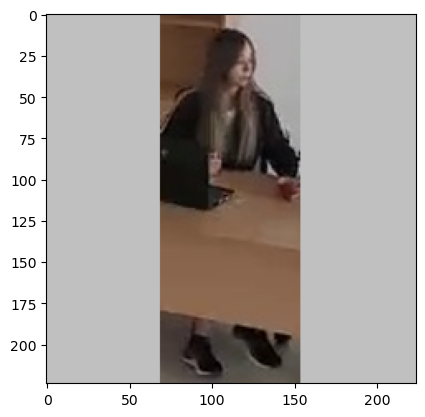

1/1 [==============================] - 0s 108ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.36525965, 2.00352693, 2.54382205]), array([1.86541498, 3.85950494, 3.3587842 ]), array([3.50903082, 3.2549541 , 0.86608464])]
[[3.36525965 2.00352693 2.54382205]
 [1.86541498 3.85950494 3.3587842 ]
 [3.50903082 3.2549541  0.86608464]]
user: (2, 2) 0.866084635257721


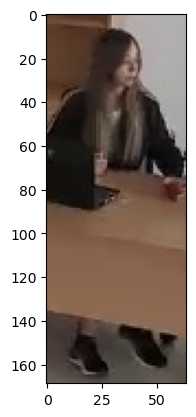

hs- [[3.36525965e+00 2.00352693e+00 1.00000000e+05]
 [1.86541498e+00 3.85950494e+00 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (1, 0) 1.8654149770736694


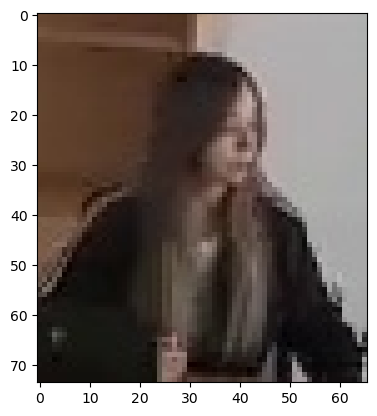

hs- [[1.00000000e+05 2.00352693e+00 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 1) 2.0035269260406494


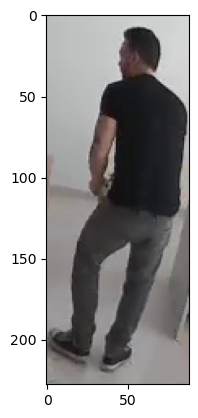

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446223 ['./out/office/raw_cam2/img3D\\1687446223_4.jpg', './out/office/raw_cam2/img3D\\1687446223_5.jpg', './out/office/raw_cam2/img3D\\1687446223_8.jpg']
./out/office/raw_cam2/img/1687446223*4_person.jpg
img.shape 0: (76, 66, 3) 1.1515151515151516
bad image size: 1.1515151515151516
./out/office/raw_cam2/img/1687446223*5_person.jpg
img.shape 0: (176, 66, 3) 2.6666666666666665
./out/office/raw_cam2/img/1687446223*8_person.jpg
img.shape 0: (258, 115, 3) 2.243478260869565
new users: 0
img.shape 1: (224, 224, 3)


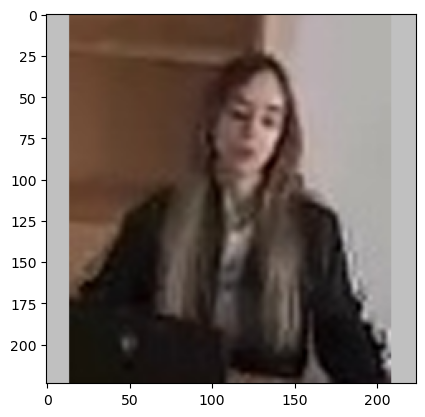

1/1 [==============================] - 0s 95ms/step
Shape of the flattened feature vector: (1, 100352) [[0.        0.        0.        ... 0.        0.        0.7229515]]
[array([1.06335533, 3.11778855, 3.19169807])]
img.shape 1: (224, 224, 3)


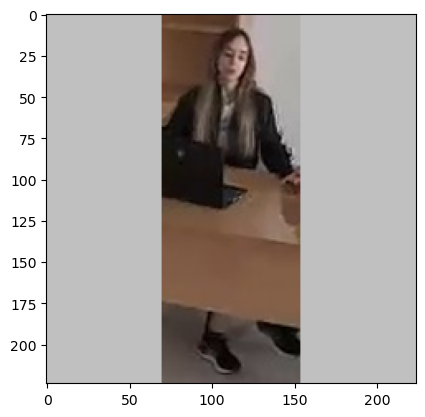

1/1 [==============================] - 0s 113ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.06335533, 3.11778855, 3.19169807]), array([3.54693842, 2.74462819, 0.87658733])]
img.shape 1: (224, 224, 3)


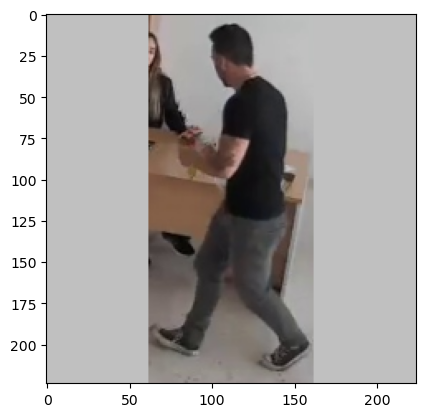

1/1 [==============================] - 0s 99ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.06335533, 3.11778855, 3.19169807]), array([3.54693842, 2.74462819, 0.87658733]), array([3.14442539, 1.44060051, 2.55017543])]
[[1.06335533 3.11778855 3.19169807]
 [3.54693842 2.74462819 0.87658733]
 [3.14442539 1.44060051 2.55017543]]
user: (1, 2) 0.8765873312950134


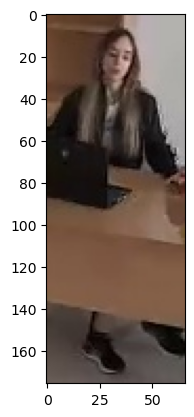

hs- [[1.06335533e+00 3.11778855e+00 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.14442539e+00 1.44060051e+00 1.00000000e+05]]
user: (0, 0) 1.0633553266525269


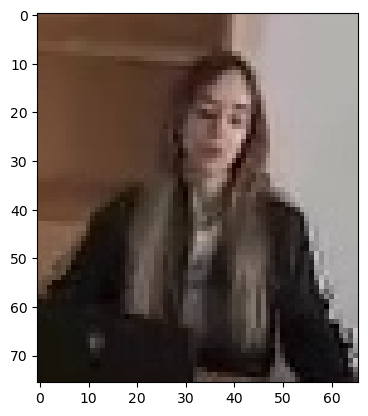

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.44060051e+00 1.00000000e+05]]
user: (2, 1) 1.4406005144119263


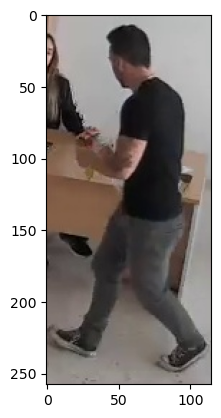

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446224 ['./out/office/raw_cam2/img3D\\1687446224_8.jpg', './out/office/raw_cam2/img3D\\1687446224_9.jpg']
./out/office/raw_cam2/img/1687446224*8_person.jpg
img.shape 0: (84, 69, 3) 1.2173913043478262
bad image size: 1.2173913043478262
./out/office/raw_cam2/img/1687446224*9_person.jpg
img.shape 0: (285, 133, 3) 2.142857142857143
new users: -1
img.shape 1: (224, 224, 3)


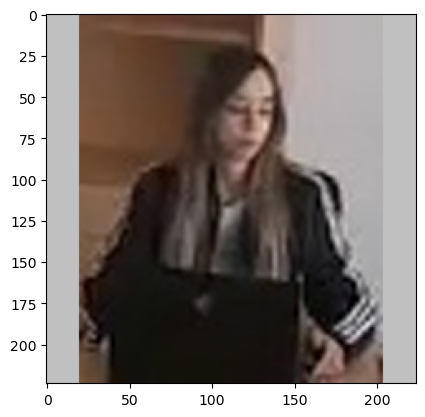

1/1 [==============================] - 0s 101ms/step
Shape of the flattened feature vector: (1, 100352) [[0.        0.        0.        ... 0.        0.        3.4391503]]
[array([1.4923681 , 3.44396567, 3.66511655])]
img.shape 1: (224, 224, 3)


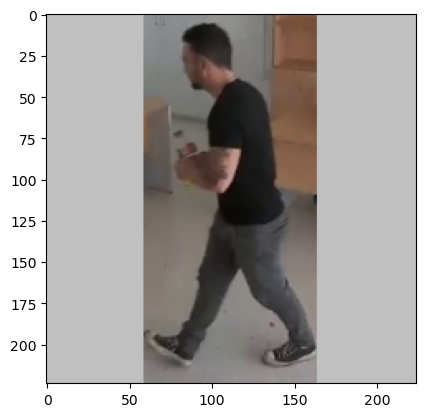

1/1 [==============================] - 0s 102ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.4923681 , 3.44396567, 3.66511655]), array([3.0954318 , 1.20862341, 2.67383194])]
[[1.4923681  3.44396567 3.66511655]
 [3.0954318  1.20862341 2.67383194]]
user: (1, 1) 1.2086234092712402


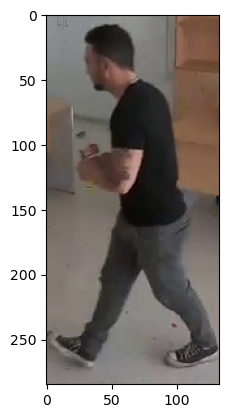

hs- [[1.49236810e+00 1.00000000e+05 3.66511655e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 1.4923681020736694


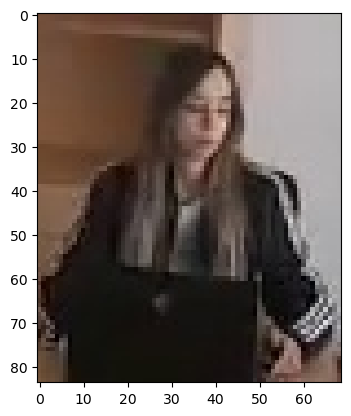

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446225 ['./out/office/raw_cam2/img3D\\1687446225_4.jpg', './out/office/raw_cam2/img3D\\1687446225_5.jpg']
./out/office/raw_cam2/img/1687446225*4_person.jpg
img.shape 0: (78, 60, 3) 1.3
bad image size: 1.3
./out/office/raw_cam2/img/1687446225*5_person.jpg
img.shape 0: (277, 135, 3) 2.051851851851852
new users: -1
img.shape 1: (224, 224, 3)


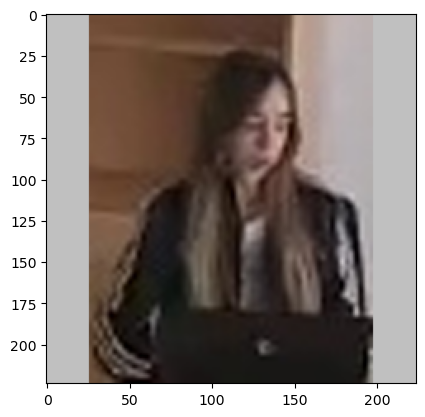

1/1 [==============================] - 0s 106ms/step
Shape of the flattened feature vector: (1, 100352) [[0.         0.         0.         ... 0.         0.         0.49156833]]
[array([1.4127779 , 3.21852803, 3.58178592])]
img.shape 1: (224, 224, 3)


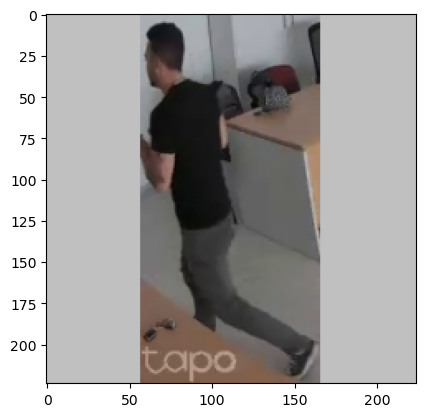

1/1 [==============================] - 0s 117ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.4127779 , 3.21852803, 3.58178592]), array([3.28947735, 1.71076524, 2.83175945])]
[[1.4127779  3.21852803 3.58178592]
 [3.28947735 1.71076524 2.83175945]]
user: (0, 0) 1.4127779006958008


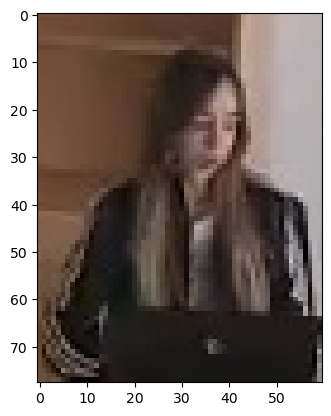

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.71076524e+00 2.83175945e+00]]
user: (1, 1) 1.7107652425765991


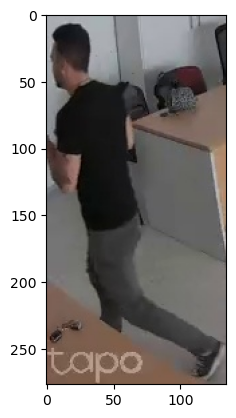

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446226 ['./out/office/raw_cam2/img3D\\1687446226_7.jpg']
./out/office/raw_cam2/img/1687446226*7_person.jpg
img.shape 0: (76, 58, 3) 1.3103448275862069
bad image size: 1.3103448275862069
new users: -2
img.shape 1: (224, 224, 3)


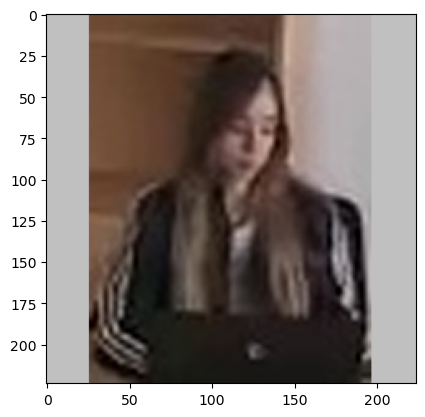

1/1 [==============================] - 0s 102ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.74012065, 2.9876895 , 3.48859119])]
[[0.74012065 2.9876895  3.48859119]]
user: (0, 0) 0.7401206493377686


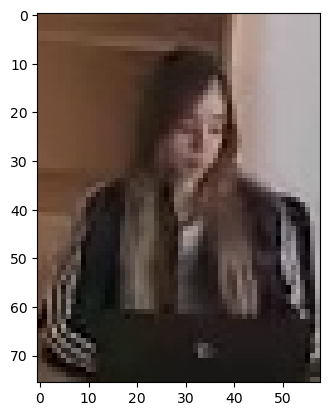

hs- [[100000. 100000. 100000.]]
1687446227 ['./out/office/raw_cam2/img3D\\1687446227_3.jpg', './out/office/raw_cam2/img3D\\1687446227_7.jpg']
./out/office/raw_cam2/img/1687446227*3_person.jpg
img.shape 0: (163, 62, 3) 2.629032258064516
./out/office/raw_cam2/img/1687446227*7_person.jpg
img.shape 0: (78, 60, 3) 1.3
bad image size: 1.3
new users: -1
img.shape 1: (224, 224, 3)


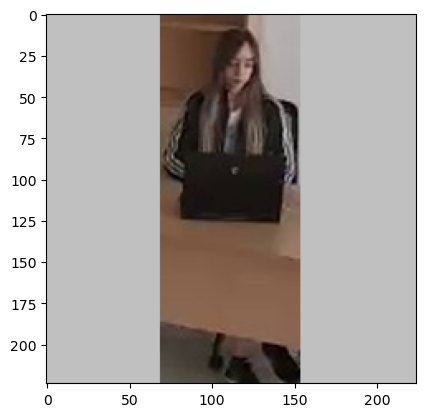

1/1 [==============================] - 0s 112ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.47891355, 2.67494774, 1.38586426])]
img.shape 1: (224, 224, 3)


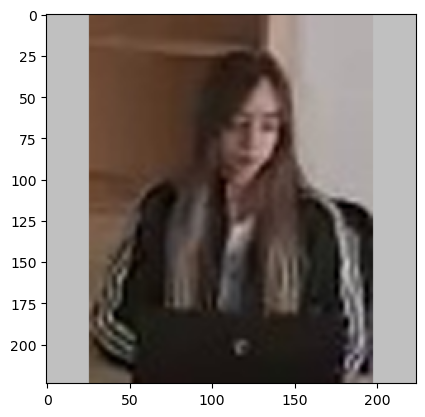

1/1 [==============================] - 0s 113ms/step
Shape of the flattened feature vector: (1, 100352) [[0.        0.        0.        ... 0.6910095 0.        0.       ]]
[array([3.47891355, 2.67494774, 1.38586426]), array([0.92803568, 3.29559207, 3.65620399])]
[[3.47891355 2.67494774 1.38586426]
 [0.92803568 3.29559207 3.65620399]]
user: (1, 0) 0.9280356764793396


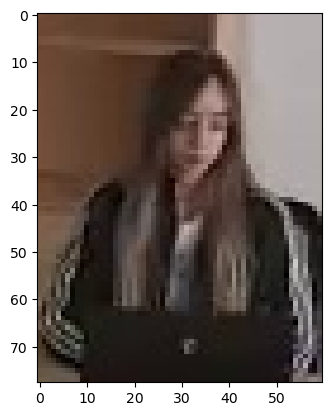

hs- [[1.00000000e+05 2.67494774e+00 1.38586426e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 2) 1.3858642578125


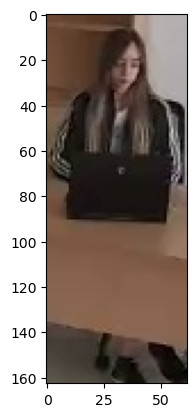

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446228 ['./out/office/raw_cam2/img3D\\1687446228_9.jpg']
./out/office/raw_cam2/img/1687446228*9_person.jpg
img.shape 0: (85, 60, 3) 1.4166666666666667
bad image size: 1.4166666666666667
new users: -2
img.shape 1: (224, 224, 3)


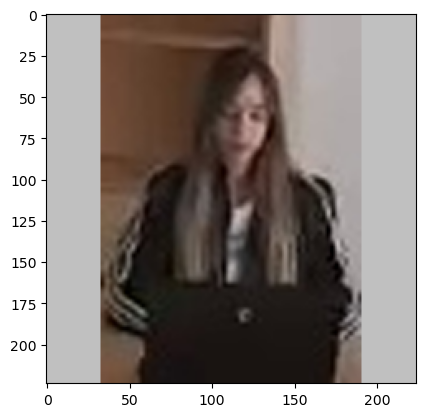

1/1 [==============================] - 0s 104ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.02284157, 3.05663013, 3.2684834 ])]
[[1.02284157 3.05663013 3.2684834 ]]
user: (0, 0) 1.0228415727615356


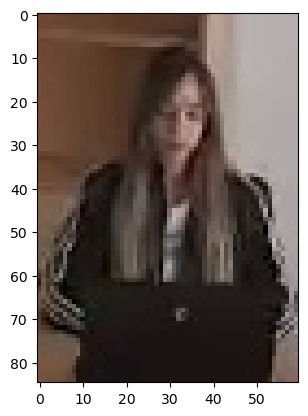

hs- [[100000. 100000. 100000.]]
1687446229 ['./out/office/raw_cam2/img3D\\1687446229_8.jpg']
./out/office/raw_cam2/img/1687446229*8_person.jpg
img.shape 0: (86, 57, 3) 1.5087719298245614
bad image size: 1.5087719298245614
new users: -2
img.shape 1: (224, 224, 3)


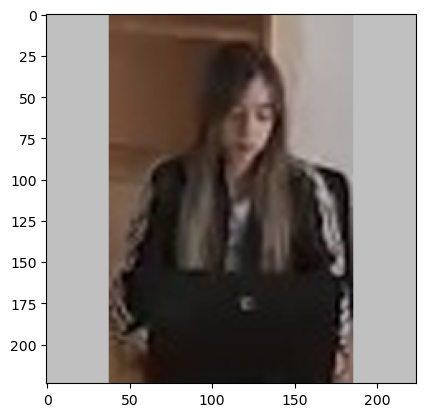

1/1 [==============================] - 0s 94ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.82436198, 2.84894109, 3.06231904])]
[[0.82436198 2.84894109 3.06231904]]
user: (0, 0) 0.8243619799613953


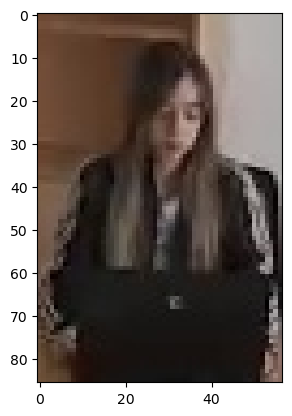

hs- [[100000. 100000. 100000.]]
1687446230 ['./out/office/raw_cam2/img3D\\1687446230_5.jpg']
./out/office/raw_cam2/img/1687446230*5_person.jpg
img.shape 0: (82, 56, 3) 1.4642857142857142
bad image size: 1.4642857142857142
new users: -2
img.shape 1: (224, 224, 3)


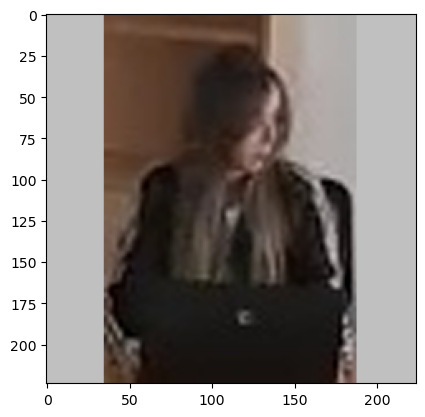

1/1 [==============================] - 0s 101ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.97451019, 3.17339444, 3.59632158])]
[[0.97451019 3.17339444 3.59632158]]
user: (0, 0) 0.9745101928710938


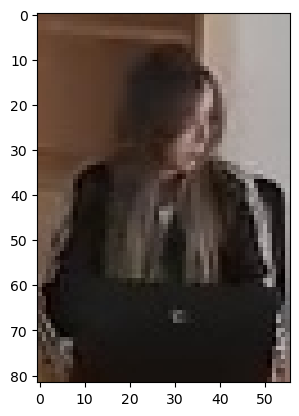

hs- [[100000. 100000. 100000.]]
1687446231 ['./out/office/raw_cam2/img3D\\1687446231_8.jpg']
./out/office/raw_cam2/img/1687446231*8_person.jpg
img.shape 0: (78, 57, 3) 1.368421052631579
bad image size: 1.368421052631579
new users: -2
img.shape 1: (224, 224, 3)


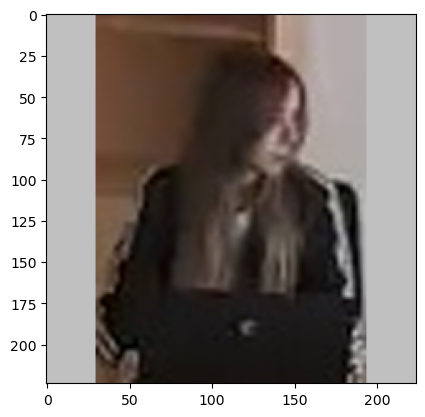

1/1 [==============================] - 0s 111ms/step
Shape of the flattened feature vector: (1, 100352) [[0.         0.         0.         ... 0.         0.         0.34720397]]
[array([1.0405333 , 3.30150867, 3.66485476])]
[[1.0405333  3.30150867 3.66485476]]
user: (0, 0) 1.0405333042144775


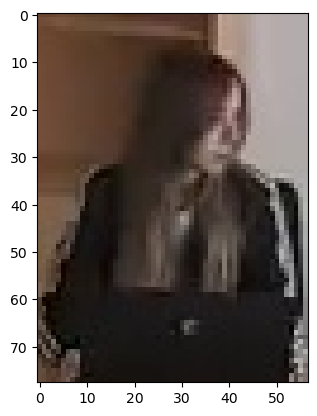

hs- [[100000. 100000. 100000.]]
1687446232 ['./out/office/raw_cam2/img3D\\1687446232_5.jpg', './out/office/raw_cam2/img3D\\1687446232_8.jpg']
./out/office/raw_cam2/img/1687446232*5_person.jpg
img.shape 0: (79, 57, 3) 1.3859649122807018
bad image size: 1.3859649122807018
./out/office/raw_cam2/img/1687446232*8_person.jpg
img.shape 0: (280, 143, 3) 1.9580419580419581
new users: -1
img.shape 1: (224, 224, 3)


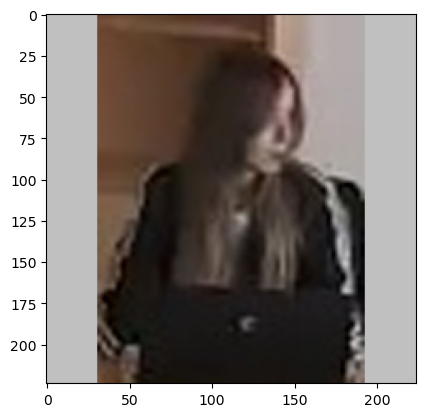

1/1 [==============================] - 0s 107ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.41952118, 2.98348999, 3.34254217])]
img.shape 1: (224, 224, 3)


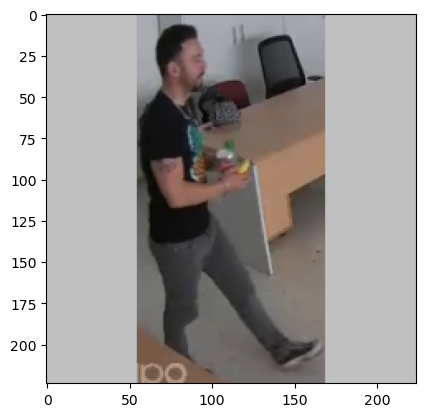

1/1 [==============================] - 0s 107ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.41952118, 2.98348999, 3.34254217]), array([4.09580803, 1.87504017, 3.31715822])]
[[0.41952118 2.98348999 3.34254217]
 [4.09580803 1.87504017 3.31715822]]
user: (0, 0) 0.41952118277549744


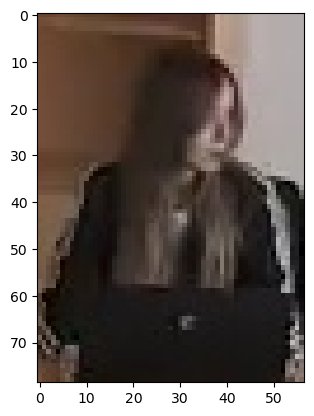

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.87504017e+00 3.31715822e+00]]
user: (1, 1) 1.8750401735305786


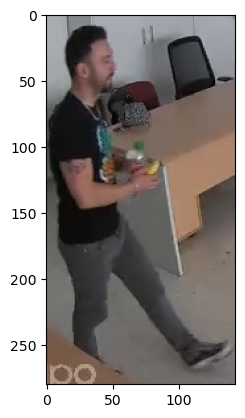

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446233 ['./out/office/raw_cam2/img3D\\1687446233_7.jpg', './out/office/raw_cam2/img3D\\1687446233_8.jpg']
./out/office/raw_cam2/img/1687446233*7_person.jpg
img.shape 0: (76, 59, 3) 1.2881355932203389
bad image size: 1.2881355932203389
./out/office/raw_cam2/img/1687446233*8_person.jpg
img.shape 0: (303, 108, 3) 2.8055555555555554
new users: -1
img.shape 1: (224, 224, 3)


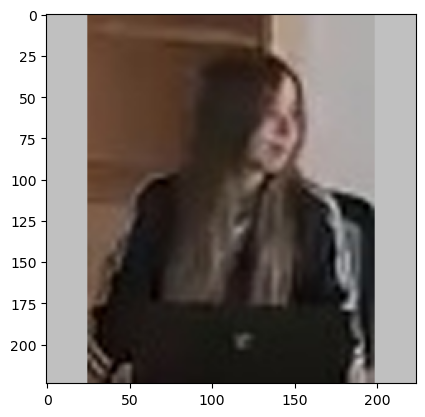

1/1 [==============================] - 0s 95ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.82533497, 3.529706  , 3.47867155])]
img.shape 1: (224, 224, 3)


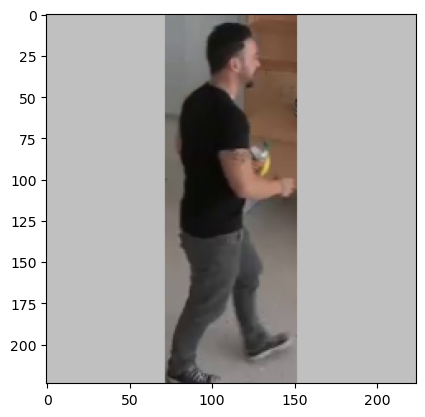

1/1 [==============================] - 0s 116ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.82533497, 3.529706  , 3.47867155]), array([3.09814644, 1.98311627, 2.50134778])]
[[0.82533497 3.529706   3.47867155]
 [3.09814644 1.98311627 2.50134778]]
user: (0, 0) 0.8253349661827087


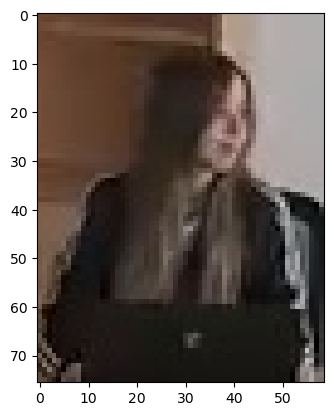

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.98311627e+00 2.50134778e+00]]
user: (1, 1) 1.9831162691116333


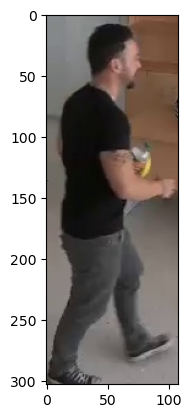

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446234 ['./out/office/raw_cam2/img3D\\1687446234_3.jpg', './out/office/raw_cam2/img3D\\1687446234_7.jpg']
./out/office/raw_cam2/img/1687446234*3_person.jpg
img.shape 0: (171, 77, 3) 2.220779220779221
./out/office/raw_cam2/img/1687446234*7_person.jpg
img.shape 0: (250, 99, 3) 2.525252525252525
new users: -1
img.shape 1: (224, 224, 3)


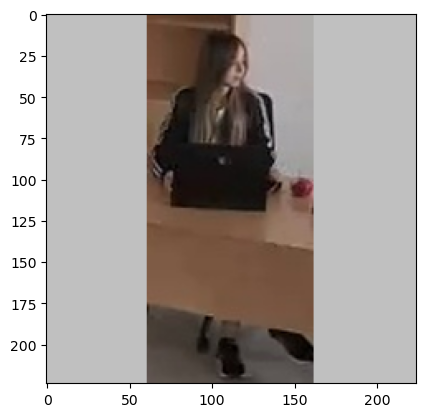

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([4.05007982, 2.78047276, 1.48664498])]
img.shape 1: (224, 224, 3)


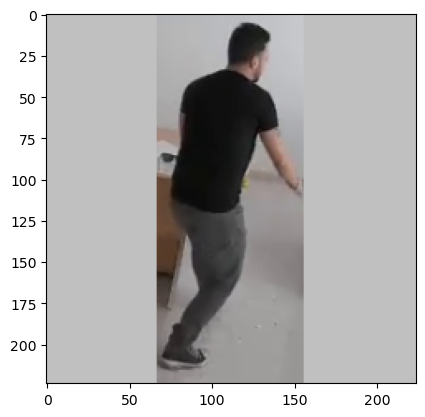

1/1 [==============================] - 0s 103ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([4.05007982, 2.78047276, 1.48664498]), array([3.15423822, 1.14994442, 2.58367872])]
[[4.05007982 2.78047276 1.48664498]
 [3.15423822 1.14994442 2.58367872]]
user: (1, 1) 1.1499444246292114


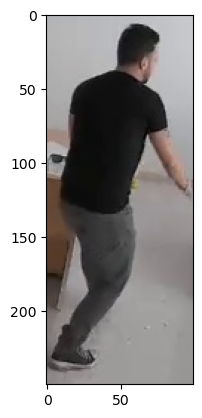

hs- [[4.05007982e+00 1.00000000e+05 1.48664498e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 2) 1.486644983291626


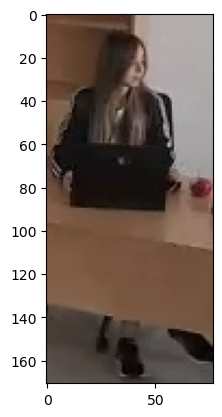

hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446235 ['./out/office/raw_cam2/img3D\\1687446235_12.jpg', './out/office/raw_cam2/img3D\\1687446235_2.jpg', './out/office/raw_cam2/img3D\\1687446235_5.jpg']
./out/office/raw_cam2/img/1687446235*12_person.jpg
img.shape 0: (157, 99, 3) 1.5858585858585859
bad image size: 1.5858585858585859
./out/office/raw_cam2/img/1687446235*2_person.jpg
img.shape 0: (157, 99, 3) 1.5858585858585859
bad image size: 1.5858585858585859
./out/office/raw_cam2/img/1687446235*5_person.jpg
img.shape 0: (82, 71, 3) 1.1549295774647887
bad image size: 1.1549295774647887
new users: 0
img.shape 1: (224, 224, 3)


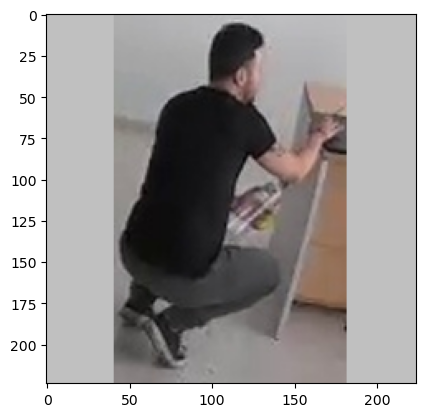

1/1 [==============================] - 0s 108ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.60474658, 2.12797809, 3.13506579])]
img.shape 1: (224, 224, 3)


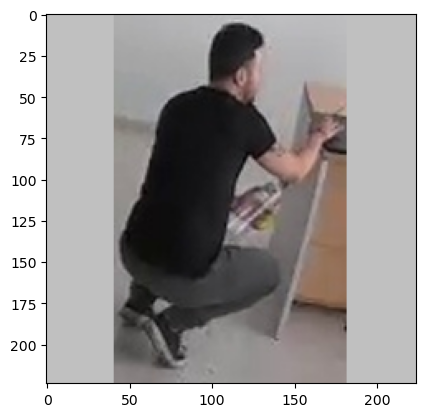

1/1 [==============================] - 0s 103ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.60474658, 2.12797809, 3.13506579]), array([3.60474658, 2.12797809, 3.13506579])]
img.shape 1: (224, 224, 3)


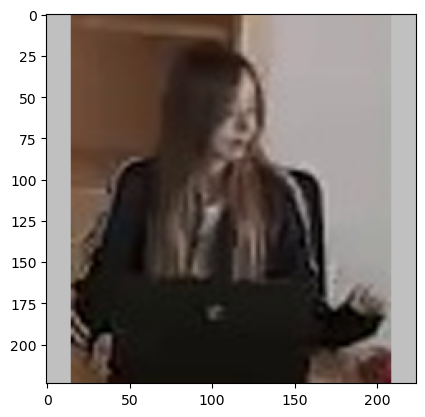

1/1 [==============================] - 0s 112ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.60474658, 2.12797809, 3.13506579]), array([3.60474658, 2.12797809, 3.13506579]), array([1.33016491, 3.02623796, 3.74286366])]
[[3.60474658 2.12797809 3.13506579]
 [3.60474658 2.12797809 3.13506579]
 [1.33016491 3.02623796 3.74286366]]
user: (2, 0) 1.330164909362793


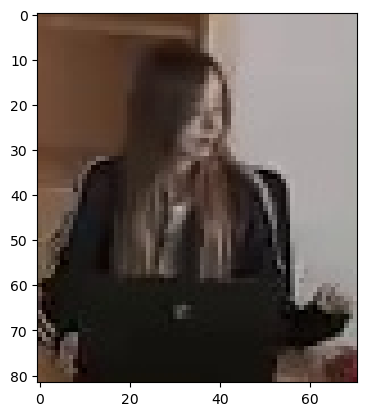

hs- [[1.00000000e+05 2.12797809e+00 3.13506579e+00]
 [1.00000000e+05 2.12797809e+00 3.13506579e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 1) 2.1279780864715576


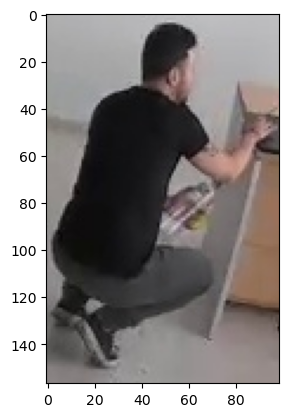

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 3.13506579e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (1, 2) 3.135065793991089


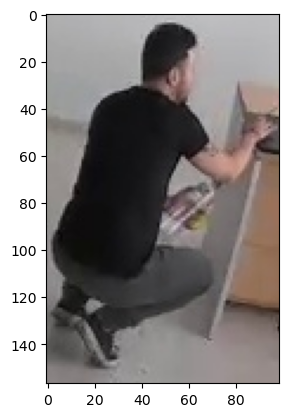

New user!
hs- [[100000. 100000. 100000.]
 [100000. 100000. 100000.]
 [100000. 100000. 100000.]]
1687446236 ['./out/office/raw_cam2/img3D\\1687446236_12.jpg', './out/office/raw_cam2/img3D\\1687446236_8.jpg']
./out/office/raw_cam2/img/1687446236*12_person.jpg
img.shape 0: (153, 99, 3) 1.5454545454545454
bad image size: 1.5454545454545454
./out/office/raw_cam2/img/1687446236*8_person.jpg
img.shape 0: (86, 75, 3) 1.1466666666666667
bad image size: 1.1466666666666667
new users: -2
img.shape 1: (224, 224, 3)


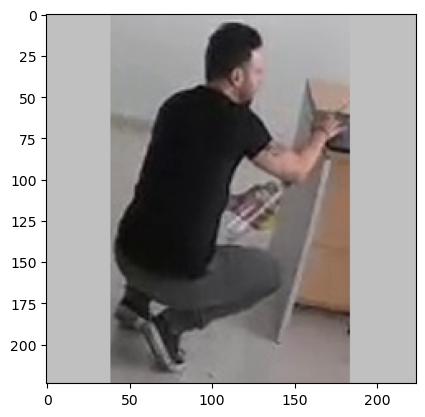

1/1 [==============================] - 0s 103ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.40679598, 0.46727726, 0.54102558, 0.44423765])]
img.shape 1: (224, 224, 3)


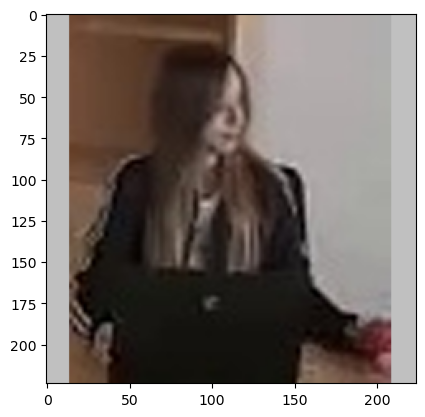

1/1 [==============================] - 0s 97ms/step
Shape of the flattened feature vector: (1, 100352) [[0.         0.         0.         ... 0.         0.         0.31802726]]
[array([3.40679598, 0.46727726, 0.54102558, 0.44423765]), array([0.76676756, 3.16736007, 3.14844871, 3.76339793])]
[[3.40679598 0.46727726 0.54102558 0.44423765]
 [0.76676756 3.16736007 3.14844871 3.76339793]]
user: (0, 3) 0.4442376494407654


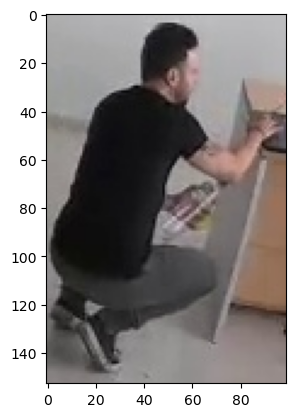

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [7.66767561e-01 3.16736007e+00 3.14844871e+00 1.00000000e+05]]
user: (1, 0) 0.7667675614356995


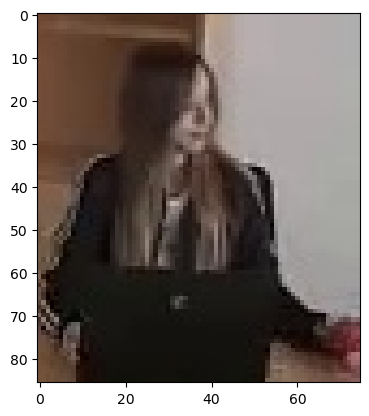

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446237 ['./out/office/raw_cam2/img3D\\1687446237_13.jpg', './out/office/raw_cam2/img3D\\1687446237_9.jpg']
./out/office/raw_cam2/img/1687446237*13_person.jpg
img.shape 0: (154, 98, 3) 1.5714285714285714
bad image size: 1.5714285714285714
./out/office/raw_cam2/img/1687446237*9_person.jpg
img.shape 0: (87, 53, 3) 1.6415094339622642
bad image size: 1.6415094339622642
new users: -2
img.shape 1: (224, 224, 3)


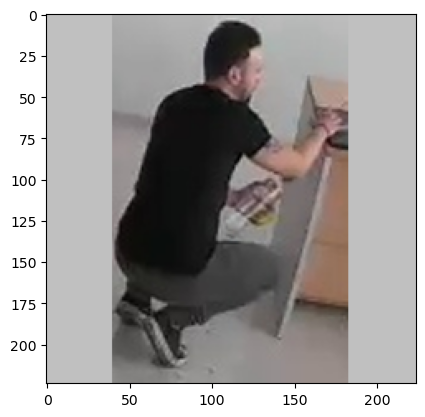

1/1 [==============================] - 0s 111ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.48908806, 0.7115941 , 0.70648634, 0.54886192])]
img.shape 1: (224, 224, 3)


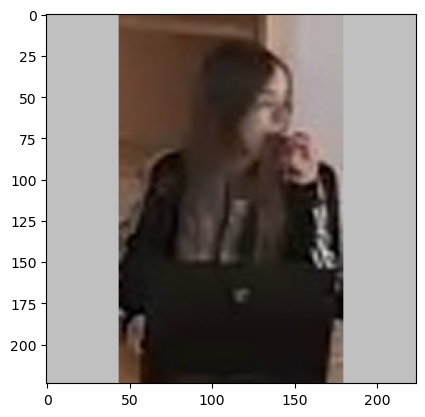

1/1 [==============================] - 0s 104ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.48908806, 0.7115941 , 0.70648634, 0.54886192]), array([1.93720603, 2.57315469, 2.52852297, 3.02338672])]
[[3.48908806 0.7115941  0.70648634 0.54886192]
 [1.93720603 2.57315469 2.52852297 3.02338672]]
user: (0, 3) 0.5488619208335876


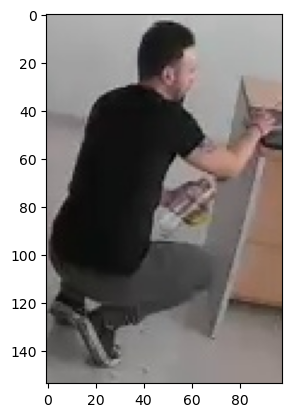

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.93720603e+00 2.57315469e+00 2.52852297e+00 1.00000000e+05]]
user: (1, 0) 1.9372060298919678


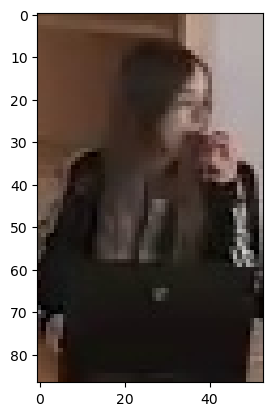

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446238 ['./out/office/raw_cam2/img3D\\1687446238_14.jpg', './out/office/raw_cam2/img3D\\1687446238_8.jpg', './out/office/raw_cam2/img3D\\1687446238_9.jpg']
./out/office/raw_cam2/img/1687446238*14_person.jpg
img.shape 0: (155, 99, 3) 1.5656565656565657
bad image size: 1.5656565656565657
./out/office/raw_cam2/img/1687446238*8_person.jpg
img.shape 0: (78, 56, 3) 1.3928571428571428
bad image size: 1.3928571428571428
./out/office/raw_cam2/img/1687446238*9_person.jpg
img.shape 0: (171, 71, 3) 2.408450704225352
new users: -1
img.shape 1: (224, 224, 3)


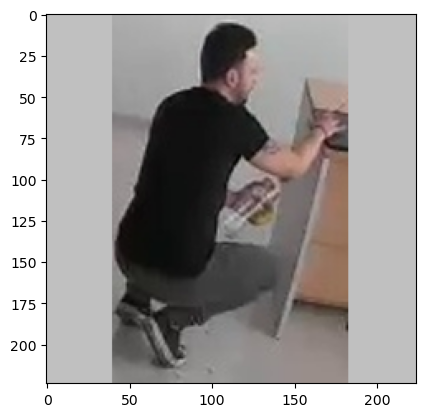

1/1 [==============================] - 0s 100ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.90013838, 0.77790046, 0.77175617, 0.21836461])]
img.shape 1: (224, 224, 3)


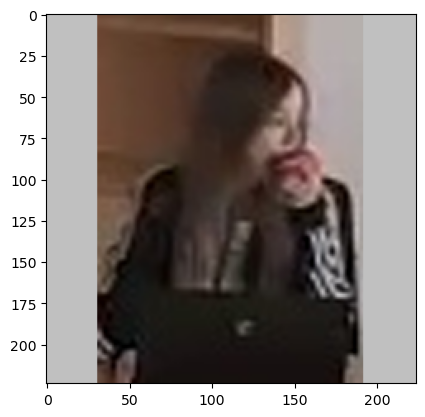

1/1 [==============================] - 0s 106ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.90013838, 0.77790046, 0.77175617, 0.21836461]), array([1.04885077, 2.93664742, 2.93015575, 3.35815239])]
img.shape 1: (224, 224, 3)


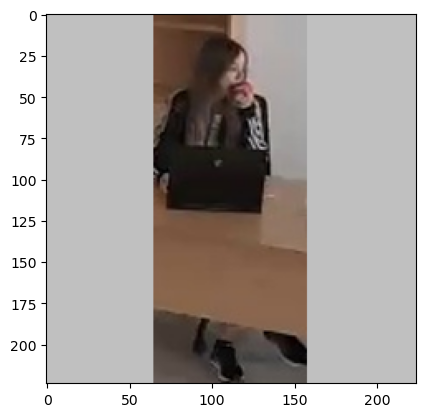

1/1 [==============================] - 0s 99ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.90013838, 0.77790046, 0.77175617, 0.21836461]), array([1.04885077, 2.93664742, 2.93015575, 3.35815239]), array([2.87922072, 2.54112029, 2.00520658, 2.99709678])]
[[2.90013838 0.77790046 0.77175617 0.21836461]
 [1.04885077 2.93664742 2.93015575 3.35815239]
 [2.87922072 2.54112029 2.00520658 2.99709678]]
user: (0, 3) 0.21836461126804352


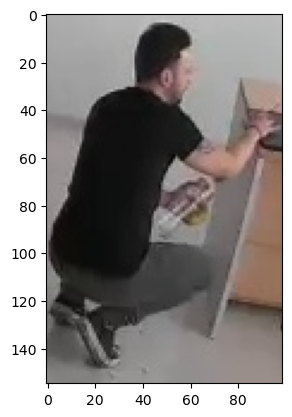

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.04885077e+00 2.93664742e+00 2.93015575e+00 1.00000000e+05]
 [2.87922072e+00 2.54112029e+00 2.00520658e+00 1.00000000e+05]]
user: (1, 0) 1.0488507747650146


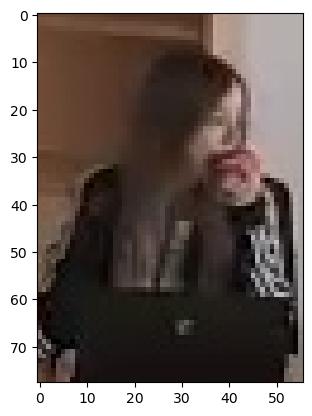

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 2.54112029e+00 2.00520658e+00 1.00000000e+05]]
user: (2, 2) 2.00520658493042


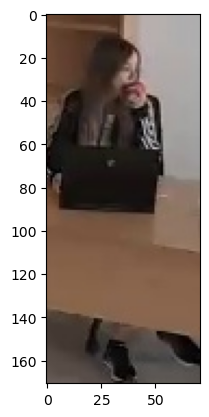

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446239 ['./out/office/raw_cam2/img3D\\1687446239_12.jpg', './out/office/raw_cam2/img3D\\1687446239_6.jpg', './out/office/raw_cam2/img3D\\1687446239_9.jpg']
./out/office/raw_cam2/img/1687446239*12_person.jpg
img.shape 0: (155, 98, 3) 1.5816326530612246
bad image size: 1.5816326530612246
./out/office/raw_cam2/img/1687446239*6_person.jpg
img.shape 0: (85, 56, 3) 1.5178571428571428
bad image size: 1.5178571428571428
./out/office/raw_cam2/img/1687446239*9_person.jpg
img.shape 0: (176, 73, 3) 2.410958904109589
new users: -1
img.shape 1: (224, 224, 3)


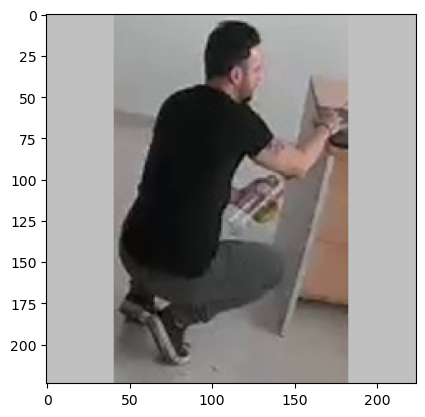

1/1 [==============================] - 0s 113ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.53510165, 0.88395369, 2.44487572, 0.47891214])]
img.shape 1: (224, 224, 3)


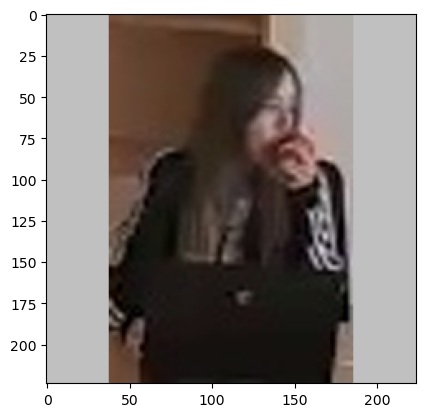

1/1 [==============================] - 0s 106ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.53510165, 0.88395369, 2.44487572, 0.47891214]), array([1.00194824, 3.20811152, 3.16244411, 3.66604805])]
img.shape 1: (224, 224, 3)


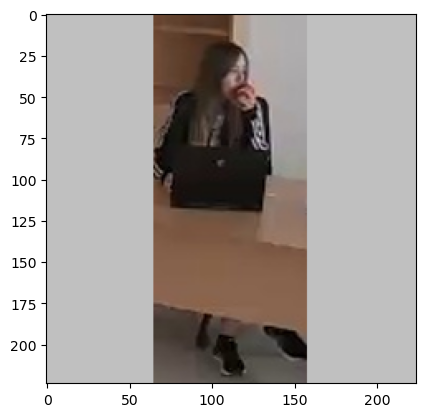

1/1 [==============================] - 0s 130ms/step
Shape of the flattened feature vector: (1, 100352) [[0.         0.         0.         ... 0.11538815 0.         0.        ]]
[array([3.53510165, 0.88395369, 2.44487572, 0.47891214]), array([1.00194824, 3.20811152, 3.16244411, 3.66604805]), array([3.27105308, 2.60004759, 0.46363005, 3.04599619])]
[[3.53510165 0.88395369 2.44487572 0.47891214]
 [1.00194824 3.20811152 3.16244411 3.66604805]
 [3.27105308 2.60004759 0.46363005 3.04599619]]
user: (2, 2) 0.4636300504207611


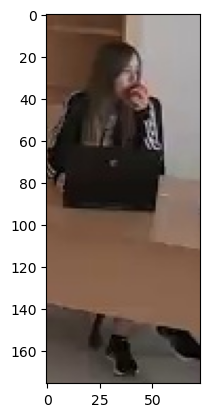

hs- [[3.53510165e+00 8.83953691e-01 1.00000000e+05 4.78912145e-01]
 [1.00194824e+00 3.20811152e+00 1.00000000e+05 3.66604805e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 3) 0.4789121448993683


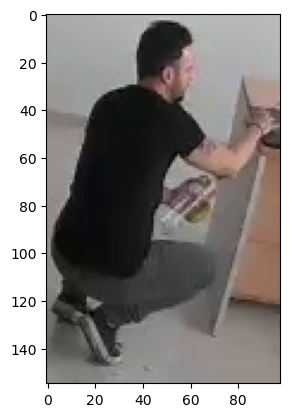

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00194824e+00 3.20811152e+00 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (1, 0) 1.0019482374191284


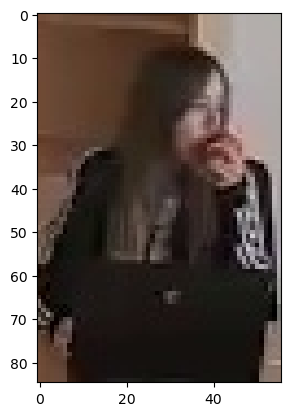

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446240 ['./out/office/raw_cam2/img3D\\1687446240_13.jpg', './out/office/raw_cam2/img3D\\1687446240_6.jpg', './out/office/raw_cam2/img3D\\1687446240_8.jpg']
./out/office/raw_cam2/img/1687446240*13_person.jpg
img.shape 0: (154, 98, 3) 1.5714285714285714
bad image size: 1.5714285714285714
./out/office/raw_cam2/img/1687446240*6_person.jpg
img.shape 0: (164, 63, 3) 2.6031746031746033
./out/office/raw_cam2/img/1687446240*8_person.jpg
img.shape 0: (77, 59, 3) 1.305084745762712
bad image size: 1.305084745762712
new users: -1
img.shape 1: (224, 224, 3)


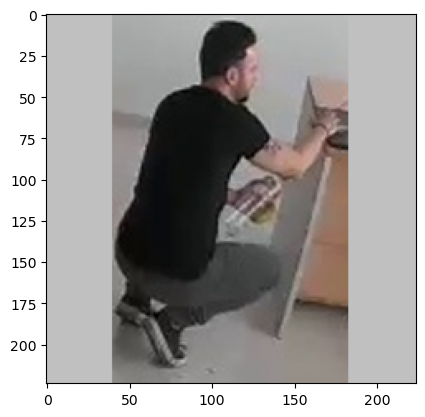

1/1 [==============================] - 0s 111ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.77405095, 0.96577811, 3.1704855 , 0.20993082])]
img.shape 1: (224, 224, 3)


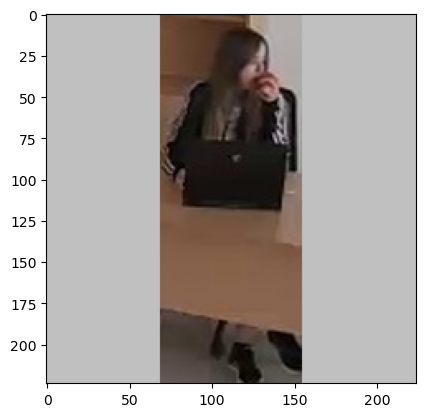

1/1 [==============================] - 0s 94ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.77405095, 0.96577811, 3.1704855 , 0.20993082]), array([3.4022696 , 2.685498  , 0.78115052, 3.38334012])]
img.shape 1: (224, 224, 3)


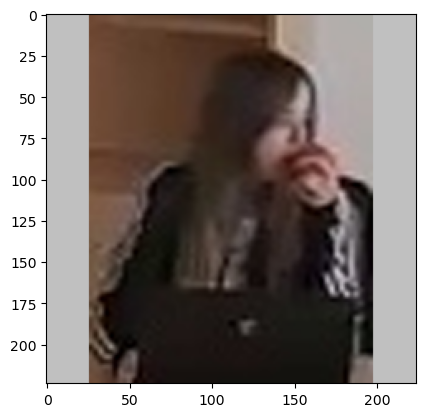

1/1 [==============================] - 0s 105ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.77405095, 0.96577811, 3.1704855 , 0.20993082]), array([3.4022696 , 2.685498  , 0.78115052, 3.38334012]), array([0.88305771, 2.87973499, 3.39100456, 3.61615419])]
[[3.77405095 0.96577811 3.1704855  0.20993082]
 [3.4022696  2.685498   0.78115052 3.38334012]
 [0.88305771 2.87973499 3.39100456 3.61615419]]
user: (0, 3) 0.20993082225322723


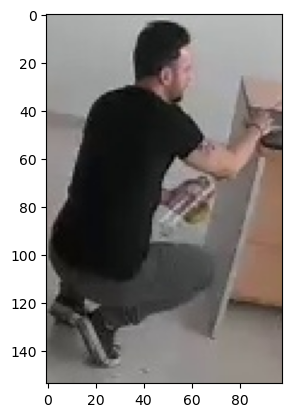

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.40226960e+00 2.68549800e+00 7.81150520e-01 1.00000000e+05]
 [8.83057714e-01 2.87973499e+00 3.39100456e+00 1.00000000e+05]]
user: (1, 2) 0.7811505198478699


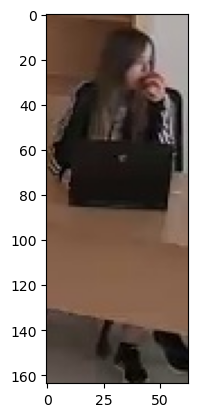

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [8.83057714e-01 2.87973499e+00 1.00000000e+05 1.00000000e+05]]
user: (2, 0) 0.883057713508606


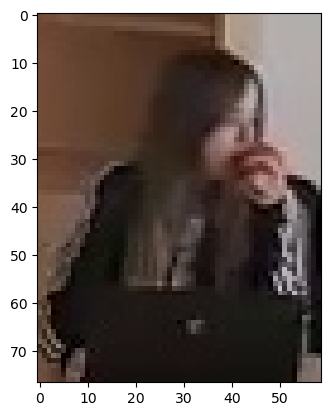

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446241 ['./out/office/raw_cam2/img3D\\1687446241_10.jpg', './out/office/raw_cam2/img3D\\1687446241_3.jpg']
./out/office/raw_cam2/img/1687446241*10_person.jpg
img.shape 0: (155, 100, 3) 1.55
bad image size: 1.55
./out/office/raw_cam2/img/1687446241*3_person.jpg
img.shape 0: (80, 55, 3) 1.4545454545454546
bad image size: 1.4545454545454546
new users: -2
img.shape 1: (224, 224, 3)


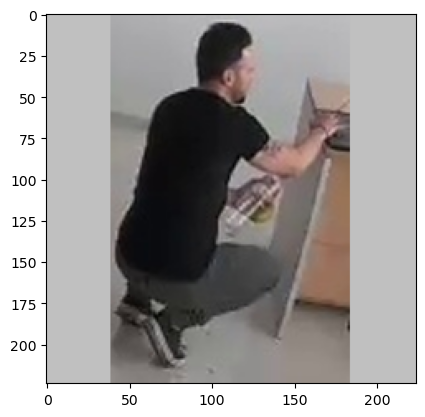

1/1 [==============================] - 0s 114ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.1776185 , 0.73528469, 3.04912376, 0.56483185])]
img.shape 1: (224, 224, 3)


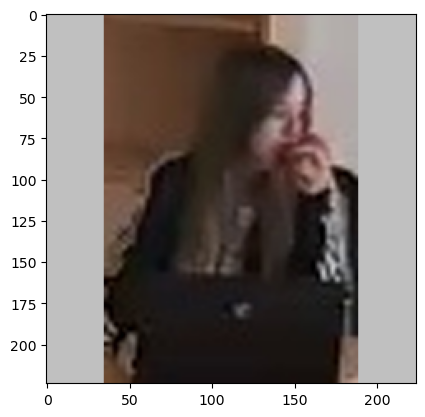

1/1 [==============================] - 0s 115ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.1776185 , 0.73528469, 3.04912376, 0.56483185]), array([0.71966606, 2.71875381, 3.07379866, 3.54588151])]
[[3.1776185  0.73528469 3.04912376 0.56483185]
 [0.71966606 2.71875381 3.07379866 3.54588151]]
user: (0, 3) 0.5648318529129028


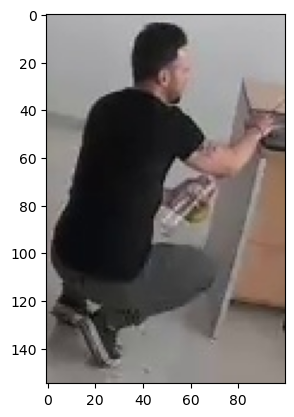

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [7.19666064e-01 2.71875381e+00 3.07379866e+00 1.00000000e+05]]
user: (1, 0) 0.719666063785553


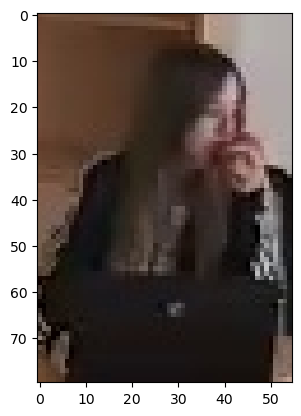

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446242 ['./out/office/raw_cam2/img3D\\1687446242_11.jpg', './out/office/raw_cam2/img3D\\1687446242_5.jpg']
./out/office/raw_cam2/img/1687446242*11_person.jpg
img.shape 0: (153, 93, 3) 1.6451612903225807
bad image size: 1.6451612903225807
./out/office/raw_cam2/img/1687446242*5_person.jpg
img.shape 0: (84, 57, 3) 1.4736842105263157
bad image size: 1.4736842105263157
new users: -2
img.shape 1: (224, 224, 3)


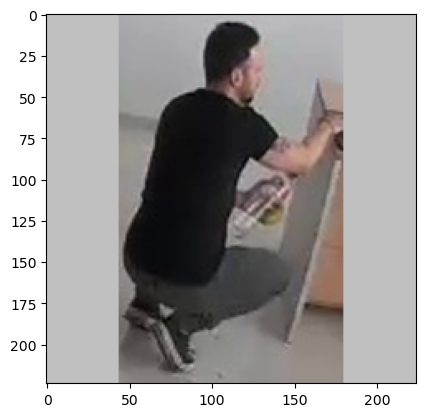

1/1 [==============================] - 0s 91ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.85604644, 0.71591312, 2.84705329, 0.51259506])]
img.shape 1: (224, 224, 3)


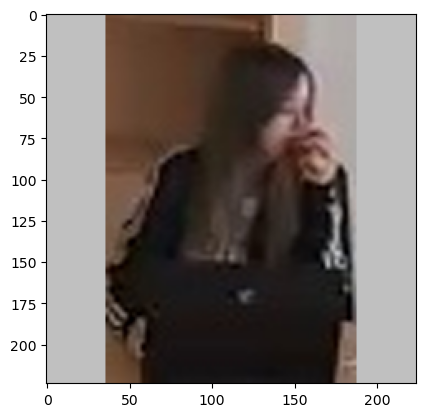

1/1 [==============================] - 0s 107ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.85604644, 0.71591312, 2.84705329, 0.51259506]), array([0.68835622, 2.83256555, 3.17063284, 3.29036236])]
[[2.85604644 0.71591312 2.84705329 0.51259506]
 [0.68835622 2.83256555 3.17063284 3.29036236]]
user: (0, 3) 0.5125950574874878


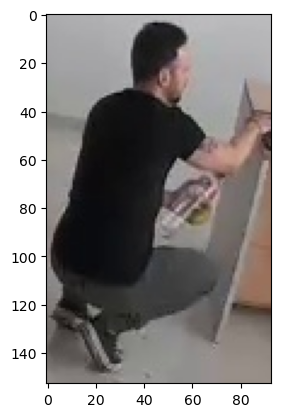

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [6.88356221e-01 2.83256555e+00 3.17063284e+00 1.00000000e+05]]
user: (1, 0) 0.6883562207221985


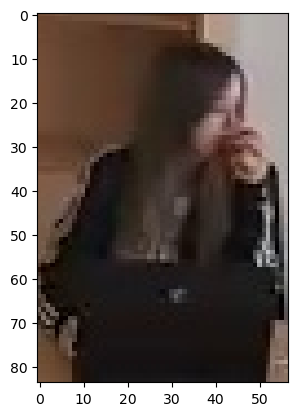

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446243 ['./out/office/raw_cam2/img3D\\1687446243_9.jpg']
./out/office/raw_cam2/img/1687446243*9_person.jpg
img.shape 0: (154, 98, 3) 1.5714285714285714
bad image size: 1.5714285714285714
new users: -3
img.shape 1: (224, 224, 3)


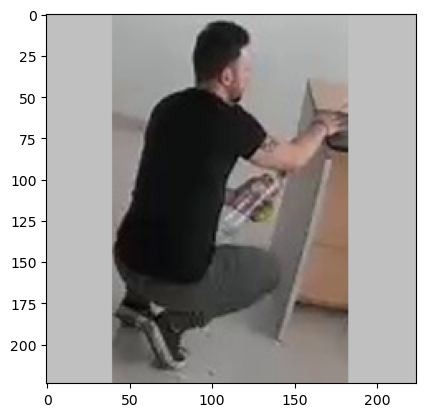

1/1 [==============================] - 0s 97ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.09994435, 0.76704329, 2.94086313, 0.50122154])]
[[3.09994435 0.76704329 2.94086313 0.50122154]]
user: (0, 3) 0.5012215375900269


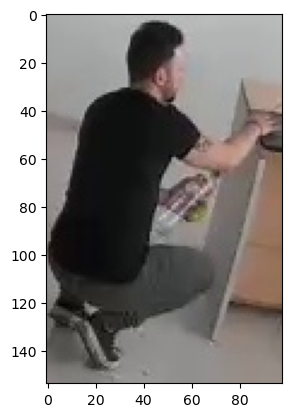

hs- [[100000. 100000. 100000. 100000.]]
1687446244 ['./out/office/raw_cam2/img3D\\1687446244_11.jpg']
./out/office/raw_cam2/img/1687446244*11_person.jpg
img.shape 0: (155, 100, 3) 1.55
bad image size: 1.55
new users: -3
img.shape 1: (224, 224, 3)


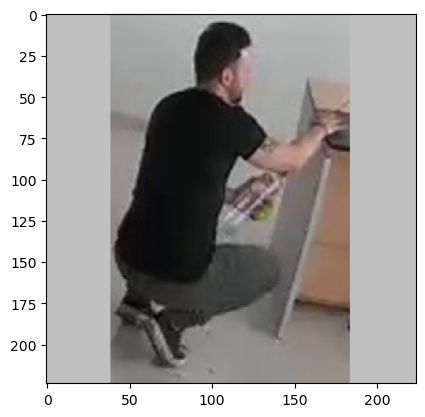

1/1 [==============================] - 0s 108ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.13331699, 0.74812323, 2.96204233, 0.21535547])]
[[3.13331699 0.74812323 2.96204233 0.21535547]]
user: (0, 3) 0.21535547077655792


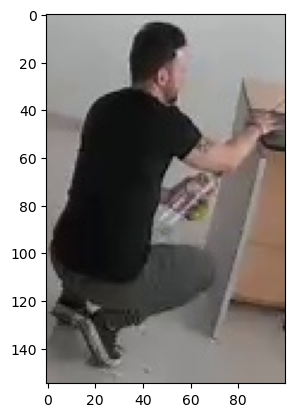

hs- [[100000. 100000. 100000. 100000.]]
1687446245 ['./out/office/raw_cam2/img3D\\1687446245_13.jpg']
./out/office/raw_cam2/img/1687446245*13_person.jpg
img.shape 0: (155, 99, 3) 1.5656565656565657
bad image size: 1.5656565656565657
new users: -3
img.shape 1: (224, 224, 3)


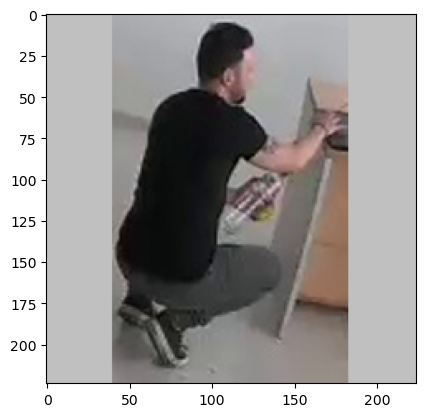

1/1 [==============================] - 0s 106ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.58307314, 0.98638481, 3.38779259, 0.45453387])]
[[3.58307314 0.98638481 3.38779259 0.45453387]]
user: (0, 3) 0.4545338749885559


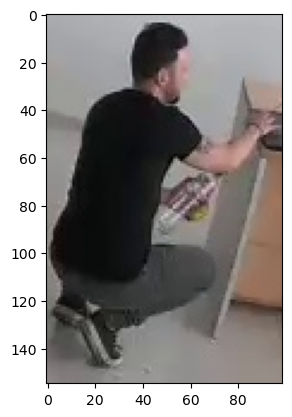

hs- [[100000. 100000. 100000. 100000.]]
1687446246 ['./out/office/raw_cam2/img3D\\1687446246_10.jpg', './out/office/raw_cam2/img3D\\1687446246_4.jpg']
./out/office/raw_cam2/img/1687446246*10_person.jpg
img.shape 0: (155, 99, 3) 1.5656565656565657
bad image size: 1.5656565656565657
./out/office/raw_cam2/img/1687446246*4_person.jpg
img.shape 0: (166, 59, 3) 2.8135593220338984
new users: -2
img.shape 1: (224, 224, 3)


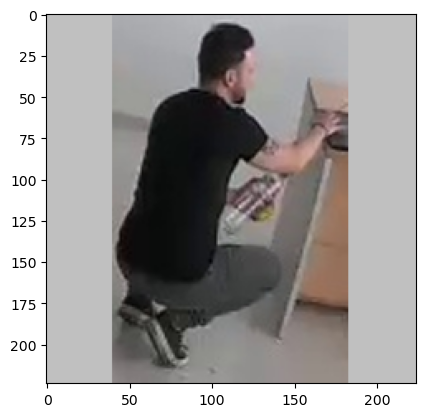

1/1 [==============================] - 0s 104ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.52960587, 0.90795255, 3.32434607, 0.09589574])]
img.shape 1: (224, 224, 3)


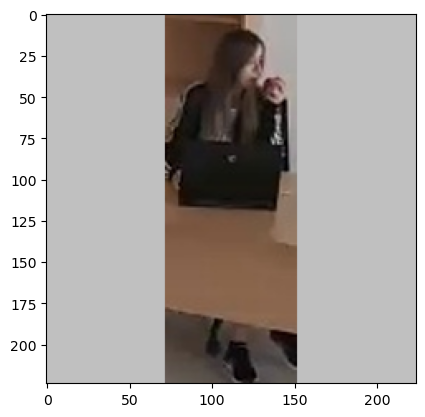

1/1 [==============================] - 0s 106ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.52960587, 0.90795255, 3.32434607, 0.09589574]), array([3.3162179 , 2.76832056, 0.68038207, 3.49547625])]
[[3.52960587 0.90795255 3.32434607 0.09589574]
 [3.3162179  2.76832056 0.68038207 3.49547625]]
user: (0, 3) 0.09589573740959167


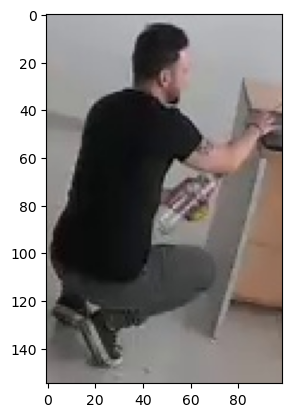

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.31621790e+00 2.76832056e+00 6.80382073e-01 1.00000000e+05]]
user: (1, 2) 0.6803820729255676


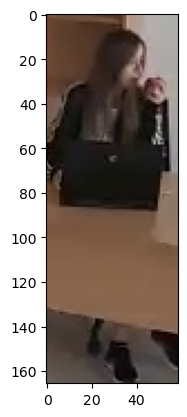

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446247 ['./out/office/raw_cam2/img3D\\1687446247_11.jpg', './out/office/raw_cam2/img3D\\1687446247_13.jpg']
./out/office/raw_cam2/img/1687446247*11_person.jpg
img.shape 0: (171, 75, 3) 2.28
./out/office/raw_cam2/img/1687446247*13_person.jpg
img.shape 0: (155, 98, 3) 1.5816326530612246
bad image size: 1.5816326530612246
new users: -2
img.shape 1: (224, 224, 3)


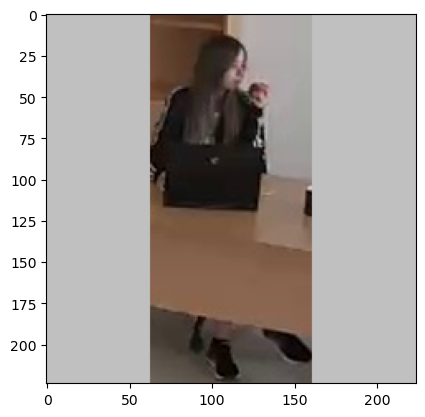

1/1 [==============================] - 0s 117ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.52173018, 2.86483526, 1.12230432, 3.65493369])]
img.shape 1: (224, 224, 3)


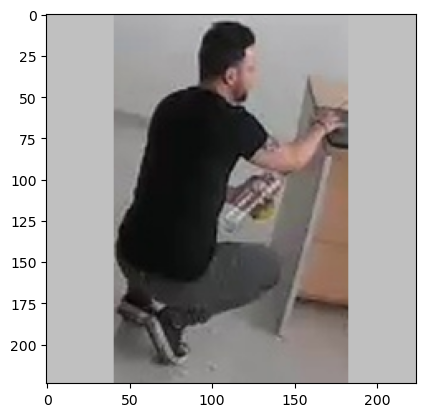

1/1 [==============================] - 0s 105ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.52173018, 2.86483526, 1.12230432, 3.65493369]), array([3.75021768, 1.03532553, 3.52408957, 0.49223432])]
[[3.52173018 2.86483526 1.12230432 3.65493369]
 [3.75021768 1.03532553 3.52408957 0.49223432]]
user: (1, 3) 0.49223431944847107


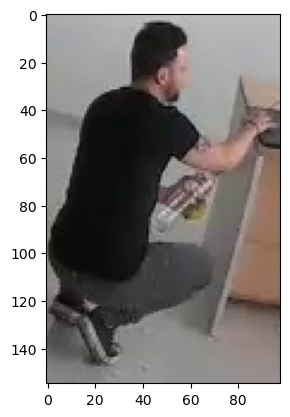

hs- [[3.52173018e+00 2.86483526e+00 1.12230432e+00 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 2) 1.1223043203353882


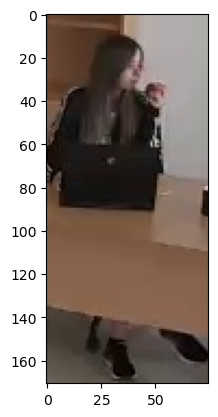

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446248 ['./out/office/raw_cam2/img3D\\1687446248_10.jpg', './out/office/raw_cam2/img3D\\1687446248_12.jpg', './out/office/raw_cam2/img3D\\1687446248_2.jpg']
./out/office/raw_cam2/img/1687446248*10_person.jpg
img.shape 0: (173, 60, 3) 2.8833333333333333
./out/office/raw_cam2/img/1687446248*12_person.jpg
img.shape 0: (155, 98, 3) 1.5816326530612246
bad image size: 1.5816326530612246
./out/office/raw_cam2/img/1687446248*2_person.jpg
img.shape 0: (155, 98, 3) 1.5816326530612246
bad image size: 1.5816326530612246
new users: -1
img.shape 1: (224, 224, 3)


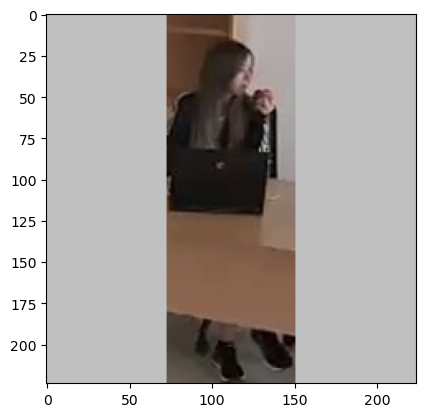

1/1 [==============================] - 0s 113ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.09185886, 2.65341401, 0.84907955, 3.51827669])]
img.shape 1: (224, 224, 3)


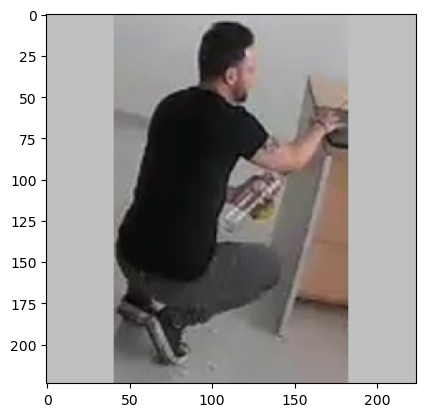

1/1 [==============================] - 0s 106ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.09185886, 2.65341401, 0.84907955, 3.51827669]), array([3.63896394, 0.96122175, 3.45718503, 0.07871644])]
img.shape 1: (224, 224, 3)


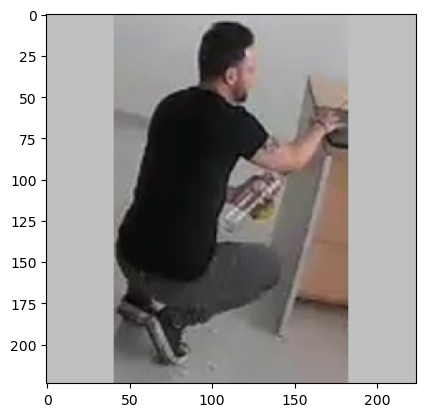

1/1 [==============================] - 0s 101ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.09185886, 2.65341401, 0.84907955, 3.51827669]), array([3.63896394, 0.96122175, 3.45718503, 0.07871644]), array([3.63896394, 0.96122175, 3.45718503, 0.07871644])]
[[3.09185886 2.65341401 0.84907955 3.51827669]
 [3.63896394 0.96122175 3.45718503 0.07871644]
 [3.63896394 0.96122175 3.45718503 0.07871644]]
user: (1, 3) 0.07871644198894501


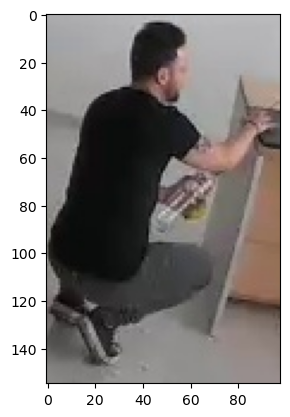

hs- [[3.09185886e+00 2.65341401e+00 8.49079549e-01 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.63896394e+00 9.61221755e-01 3.45718503e+00 1.00000000e+05]]
user: (0, 2) 0.8490795493125916


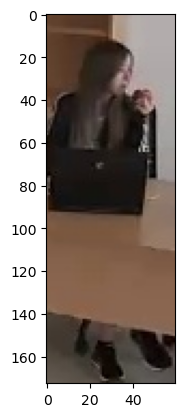

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.63896394e+00 9.61221755e-01 1.00000000e+05 1.00000000e+05]]
user: (2, 1) 0.9612217545509338


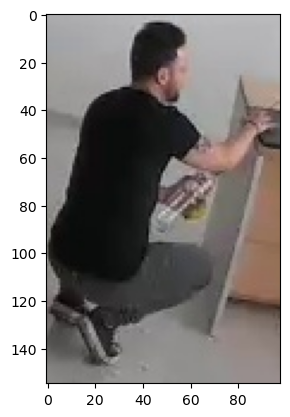

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446249 ['./out/office/raw_cam2/img3D\\1687446249_12.jpg', './out/office/raw_cam2/img3D\\1687446249_2.jpg', './out/office/raw_cam2/img3D\\1687446249_6.jpg']
./out/office/raw_cam2/img/1687446249*12_person.jpg
img.shape 0: (156, 97, 3) 1.6082474226804124
bad image size: 1.6082474226804124
./out/office/raw_cam2/img/1687446249*2_person.jpg
img.shape 0: (156, 97, 3) 1.6082474226804124
bad image size: 1.6082474226804124
./out/office/raw_cam2/img/1687446249*6_person.jpg
img.shape 0: (175, 73, 3) 2.3972602739726026
new users: -1
img.shape 1: (224, 224, 3)


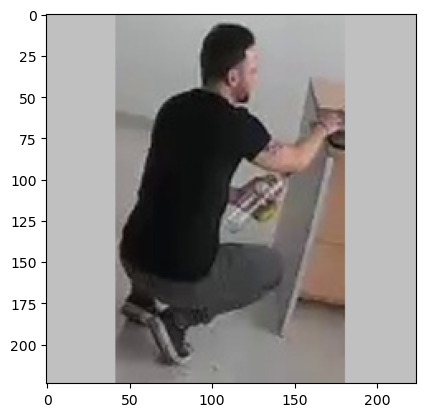

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.47255349, 0.45211381, 3.31657481, 0.47432965])]
img.shape 1: (224, 224, 3)


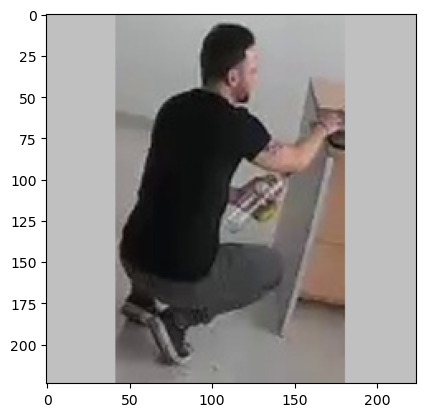

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.47255349, 0.45211381, 3.31657481, 0.47432965]), array([3.47255349, 0.45211381, 3.31657481, 0.47432965])]
img.shape 1: (224, 224, 3)


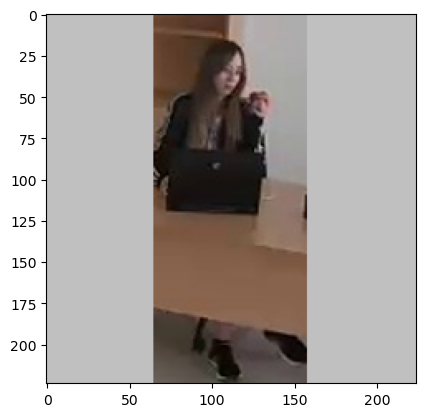

1/1 [==============================] - 0s 103ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.47255349, 0.45211381, 3.31657481, 0.47432965]), array([3.47255349, 0.45211381, 3.31657481, 0.47432965]), array([3.15271235, 3.17938304, 0.83327514, 3.57603335])]
[[3.47255349 0.45211381 3.31657481 0.47432965]
 [3.47255349 0.45211381 3.31657481 0.47432965]
 [3.15271235 3.17938304 0.83327514 3.57603335]]
user: (0, 1) 0.4521138072013855


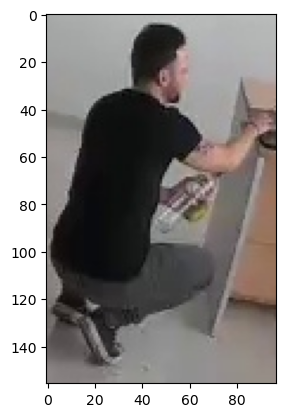

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.47255349e+00 1.00000000e+05 3.31657481e+00 4.74329650e-01]
 [3.15271235e+00 1.00000000e+05 8.33275139e-01 3.57603335e+00]]
user: (1, 3) 0.4743296504020691


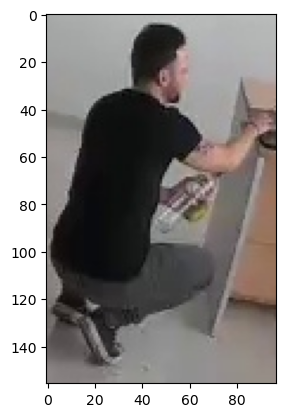

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.15271235e+00 1.00000000e+05 8.33275139e-01 1.00000000e+05]]
user: (2, 2) 0.8332751393318176


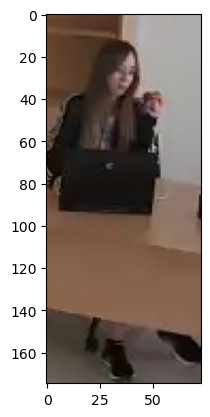

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446250 ['./out/office/raw_cam2/img3D\\1687446250_1.jpg', './out/office/raw_cam2/img3D\\1687446250_13.jpg', './out/office/raw_cam2/img3D\\1687446250_8.jpg']
./out/office/raw_cam2/img/1687446250*1_person.jpg
img.shape 0: (84, 56, 3) 1.5
bad image size: 1.5
./out/office/raw_cam2/img/1687446250*13_person.jpg
img.shape 0: (156, 97, 3) 1.6082474226804124
bad image size: 1.6082474226804124
./out/office/raw_cam2/img/1687446250*8_person.jpg
img.shape 0: (175, 72, 3) 2.4305555555555554
new users: -1
img.shape 1: (224, 224, 3)


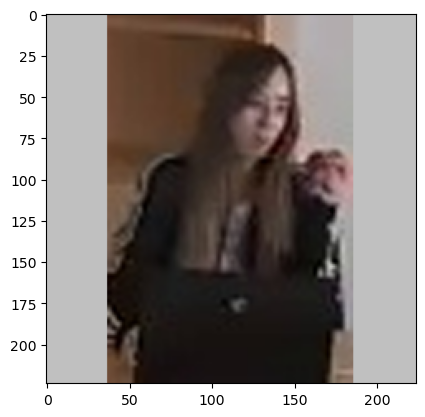

1/1 [==============================] - 0s 125ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.2745657 , 3.61290598, 3.30254507, 3.70794916])]
img.shape 1: (224, 224, 3)


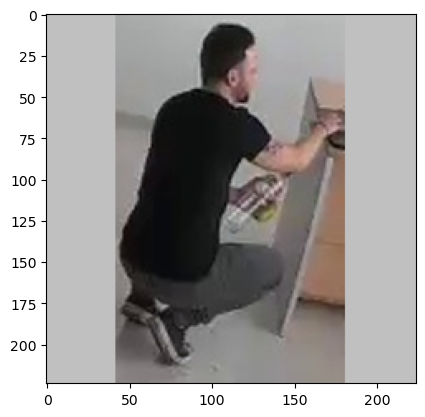

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.2745657 , 3.61290598, 3.30254507, 3.70794916]), array([3.47722268, 0.03044181, 3.35010195, 0.03179904])]
img.shape 1: (224, 224, 3)


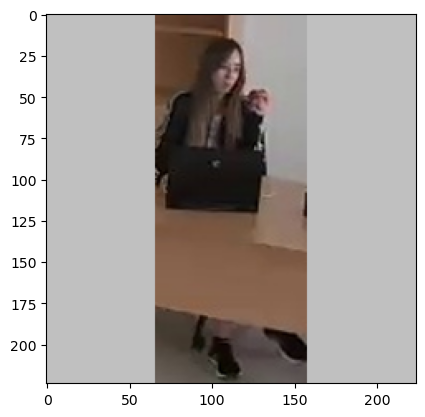

1/1 [==============================] - 0s 109ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.2745657 , 3.61290598, 3.30254507, 3.70794916]), array([3.47722268, 0.03044181, 3.35010195, 0.03179904]), array([3.17460942, 3.3570931 , 0.19430225, 3.45149875])]
[[1.2745657  3.61290598 3.30254507 3.70794916]
 [3.47722268 0.03044181 3.35010195 0.03179904]
 [3.17460942 3.3570931  0.19430225 3.45149875]]
user: (1, 1) 0.030441805720329285


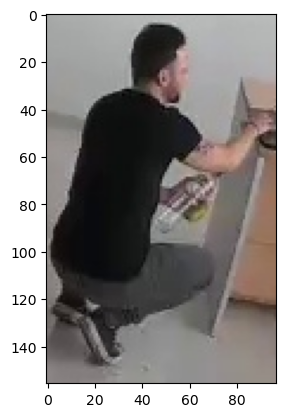

hs- [[1.27456570e+00 1.00000000e+05 3.30254507e+00 3.70794916e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.17460942e+00 1.00000000e+05 1.94302246e-01 3.45149875e+00]]
user: (2, 2) 0.1943022459745407


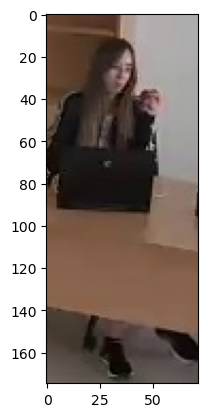

hs- [[1.27456570e+00 1.00000000e+05 1.00000000e+05 3.70794916e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 1.2745656967163086


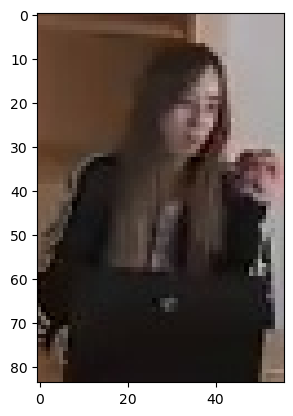

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446254 ['./out/office/raw_cam2/img3D\\1687446254_13.jpg', './out/office/raw_cam2/img3D\\1687446254_2.jpg', './out/office/raw_cam2/img3D\\1687446254_7.jpg']
./out/office/raw_cam2/img/1687446254*13_person.jpg
img.shape 0: (156, 97, 3) 1.6082474226804124
bad image size: 1.6082474226804124
./out/office/raw_cam2/img/1687446254*2_person.jpg
img.shape 0: (84, 55, 3) 1.5272727272727273
bad image size: 1.5272727272727273
./out/office/raw_cam2/img/1687446254*7_person.jpg
img.shape 0: (174, 70, 3) 2.4857142857142858
new users: -1
img.shape 1: (224, 224, 3)


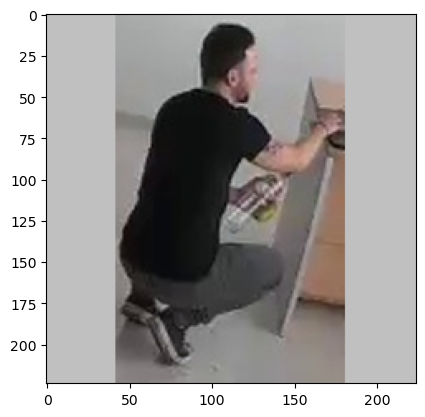

1/1 [==============================] - 0s 125ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.45086074e+00, 1.90261297e-03, 3.45866799e+00, 3.17990370e-02])]
img.shape 1: (224, 224, 3)


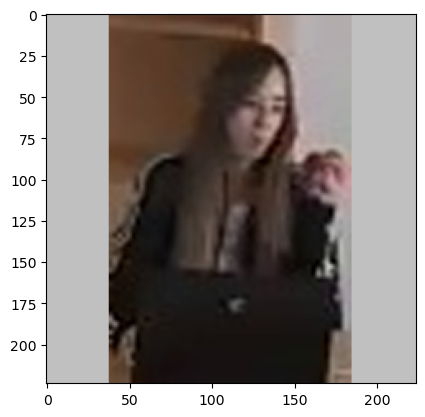

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.45086074e+00, 1.90261297e-03, 3.45866799e+00, 3.17990370e-02]), array([0.48736492, 3.55033684, 3.19614053, 3.53285098])]
img.shape 1: (224, 224, 3)


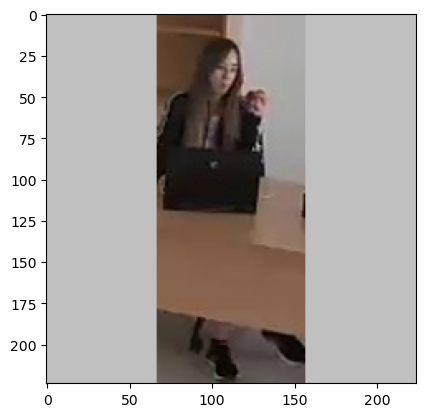

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.45086074e+00, 1.90261297e-03, 3.45866799e+00, 3.17990370e-02]), array([0.48736492, 3.55033684, 3.19614053, 3.53285098]), array([3.04326272, 3.44703841, 0.33222088, 3.4123466 ])]
[[3.45086074e+00 1.90261297e-03 3.45866799e+00 3.17990370e-02]
 [4.87364918e-01 3.55033684e+00 3.19614053e+00 3.53285098e+00]
 [3.04326272e+00 3.44703841e+00 3.32220882e-01 3.41234660e+00]]
user: (0, 1) 0.0019026129739359021


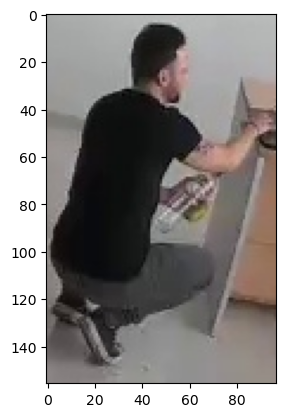

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [4.87364918e-01 1.00000000e+05 3.19614053e+00 3.53285098e+00]
 [3.04326272e+00 1.00000000e+05 3.32220882e-01 3.41234660e+00]]
user: (2, 2) 0.3322208821773529


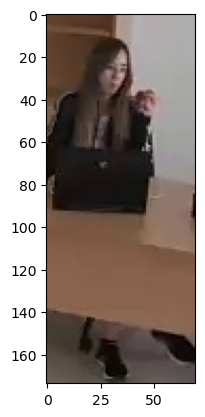

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [4.87364918e-01 1.00000000e+05 1.00000000e+05 3.53285098e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (1, 0) 0.48736491799354553


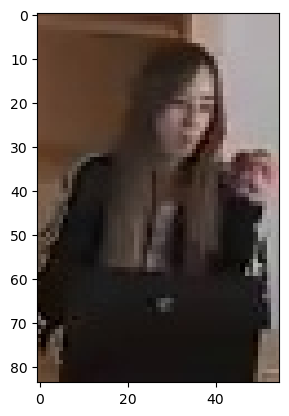

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446255 ['./out/office/raw_cam2/img3D\\1687446255_1.jpg', './out/office/raw_cam2/img3D\\1687446255_11.jpg', './out/office/raw_cam2/img3D\\1687446255_4.jpg']
./out/office/raw_cam2/img/1687446255*1_person.jpg
img.shape 0: (156, 97, 3) 1.6082474226804124
bad image size: 1.6082474226804124
./out/office/raw_cam2/img/1687446255*11_person.jpg
img.shape 0: (156, 97, 3) 1.6082474226804124
bad image size: 1.6082474226804124
./out/office/raw_cam2/img/1687446255*4_person.jpg
img.shape 0: (174, 69, 3) 2.5217391304347827
new users: -1
img.shape 1: (224, 224, 3)


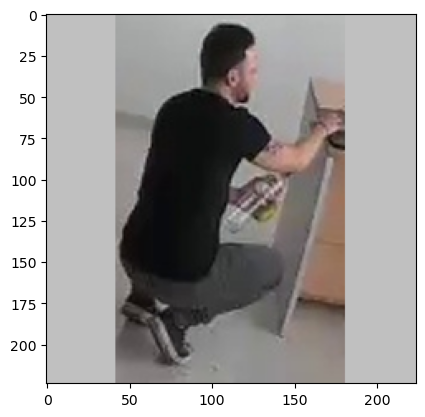

1/1 [==============================] - 0s 94ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.3833828 , 0.00755674, 3.35671496, 0.03214958])]
img.shape 1: (224, 224, 3)


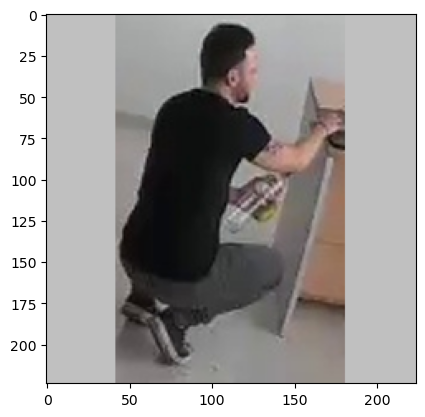

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.3833828 , 0.00755674, 3.35671496, 0.03214958]), array([3.3833828 , 0.00755674, 3.35671496, 0.03214958])]
img.shape 1: (224, 224, 3)


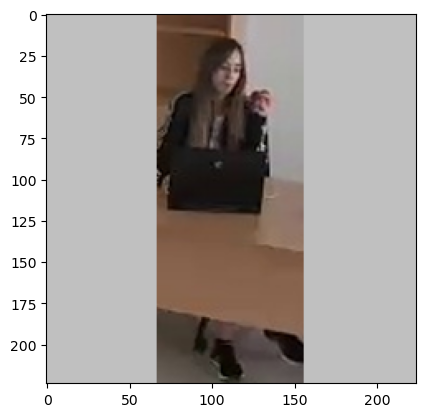

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.3833828 , 0.00755674, 3.35671496, 0.03214958]), array([3.3833828 , 0.00755674, 3.35671496, 0.03214958]), array([3.22191143, 3.56656194, 0.27657372, 3.4866991 ])]
[[3.3833828  0.00755674 3.35671496 0.03214958]
 [3.3833828  0.00755674 3.35671496 0.03214958]
 [3.22191143 3.56656194 0.27657372 3.4866991 ]]
user: (0, 1) 0.007556738797575235


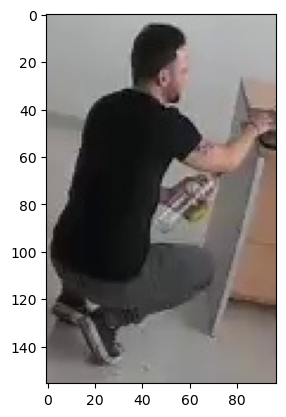

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.38338280e+00 1.00000000e+05 3.35671496e+00 3.21495794e-02]
 [3.22191143e+00 1.00000000e+05 2.76573718e-01 3.48669910e+00]]
user: (1, 3) 0.032149579375982285


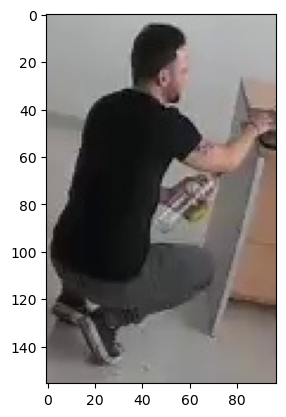

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.22191143e+00 1.00000000e+05 2.76573718e-01 1.00000000e+05]]
user: (2, 2) 0.27657371759414673


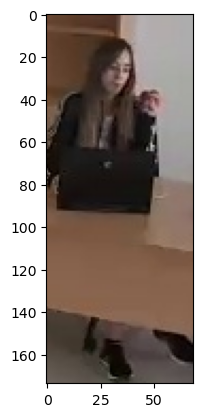

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446256 ['./out/office/raw_cam2/img3D\\1687446256_12.jpg', './out/office/raw_cam2/img3D\\1687446256_2.jpg', './out/office/raw_cam2/img3D\\1687446256_9.jpg']
./out/office/raw_cam2/img/1687446256*12_person.jpg
img.shape 0: (150, 95, 3) 1.5789473684210527
bad image size: 1.5789473684210527
./out/office/raw_cam2/img/1687446256*2_person.jpg
img.shape 0: (150, 95, 3) 1.5789473684210527
bad image size: 1.5789473684210527
./out/office/raw_cam2/img/1687446256*9_person.jpg
img.shape 0: (174, 66, 3) 2.6363636363636362
new users: -1
img.shape 1: (224, 224, 3)


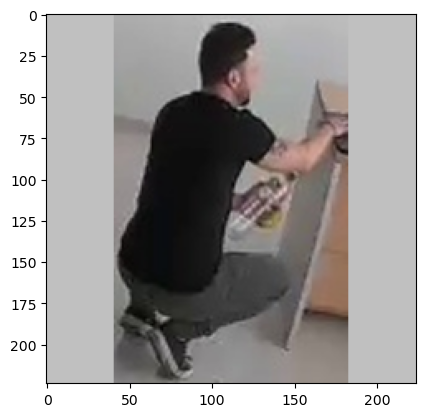

1/1 [==============================] - 0s 94ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.89689445, 0.82274038, 3.03435397, 0.79887116])]
img.shape 1: (224, 224, 3)


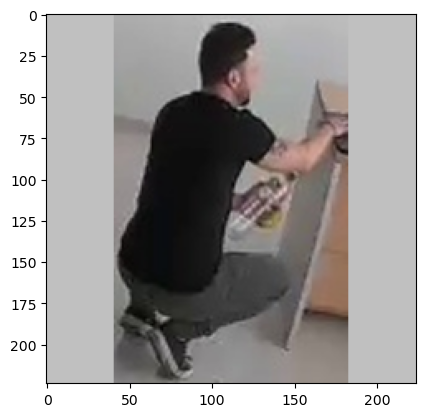

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.89689445, 0.82274038, 3.03435397, 0.79887116]), array([2.89689445, 0.82274038, 3.03435397, 0.79887116])]
img.shape 1: (224, 224, 3)


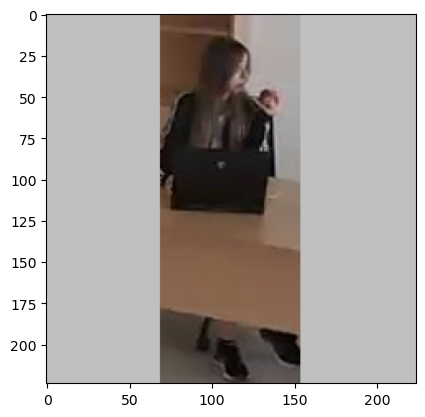

1/1 [==============================] - 0s 94ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.89689445, 0.82274038, 3.03435397, 0.79887116]), array([2.89689445, 0.82274038, 3.03435397, 0.79887116]), array([3.26304317, 3.37346125, 0.62834209, 3.3468039 ])]
[[2.89689445 0.82274038 3.03435397 0.79887116]
 [2.89689445 0.82274038 3.03435397 0.79887116]
 [3.26304317 3.37346125 0.62834209 3.3468039 ]]
user: (2, 2) 0.6283420920372009


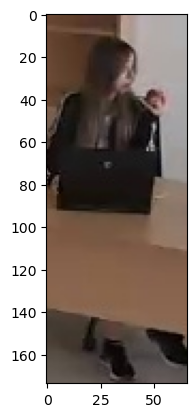

hs- [[2.89689445e+00 8.22740376e-01 1.00000000e+05 7.98871160e-01]
 [2.89689445e+00 8.22740376e-01 1.00000000e+05 7.98871160e-01]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 3) 0.7988711595535278


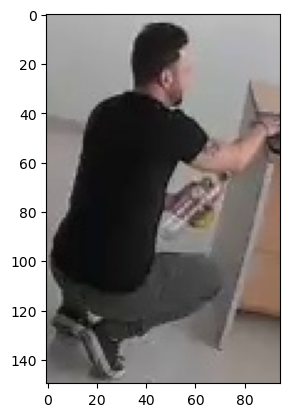

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [2.89689445e+00 8.22740376e-01 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (1, 1) 0.822740375995636


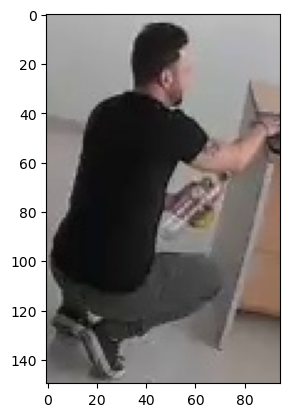

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446257 ['./out/office/raw_cam2/img3D\\1687446257_11.jpg', './out/office/raw_cam2/img3D\\1687446257_7.jpg']
./out/office/raw_cam2/img/1687446257*11_person.jpg
img.shape 0: (155, 93, 3) 1.6666666666666667
bad image size: 1.6666666666666667
./out/office/raw_cam2/img/1687446257*7_person.jpg
img.shape 0: (78, 58, 3) 1.3448275862068966
bad image size: 1.3448275862068966
new users: -2
img.shape 1: (224, 224, 3)


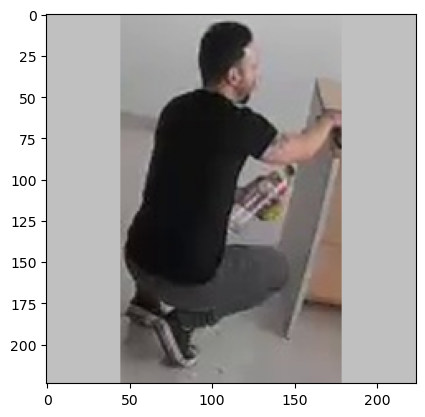

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.02322078, 0.5478617 , 2.86579299, 0.54729432])]
img.shape 1: (224, 224, 3)


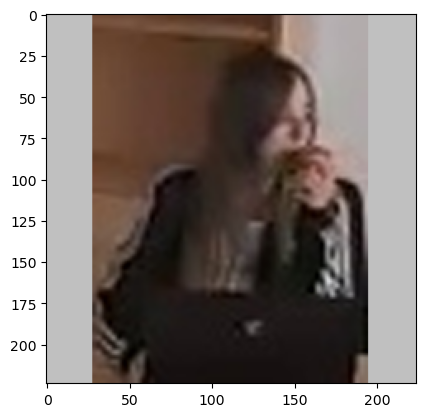

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0.       0.       0.       ... 0.693439 0.       0.      ]]
[array([3.02322078, 0.5478617 , 2.86579299, 0.54729432]), array([1.50275338, 3.38987017, 3.53771758, 3.39023852])]
[[3.02322078 0.5478617  2.86579299 0.54729432]
 [1.50275338 3.38987017 3.53771758 3.39023852]]
user: (0, 3) 0.5472943186759949


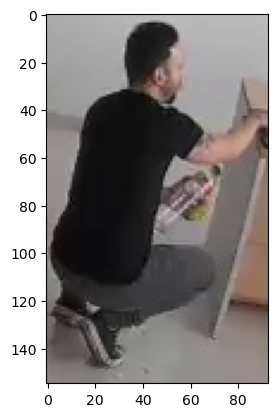

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.50275338e+00 3.38987017e+00 3.53771758e+00 1.00000000e+05]]
user: (1, 0) 1.5027533769607544


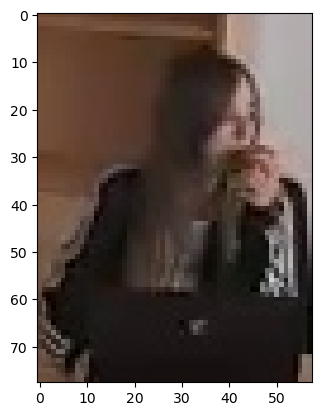

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446258 ['./out/office/raw_cam2/img3D\\1687446258_12.jpg', './out/office/raw_cam2/img3D\\1687446258_5.jpg']
./out/office/raw_cam2/img/1687446258*12_person.jpg
img.shape 0: (287, 91, 3) 3.1538461538461537
./out/office/raw_cam2/img/1687446258*5_person.jpg
img.shape 0: (171, 62, 3) 2.7580645161290325
new users: -2
img.shape 1: (224, 224, 3)


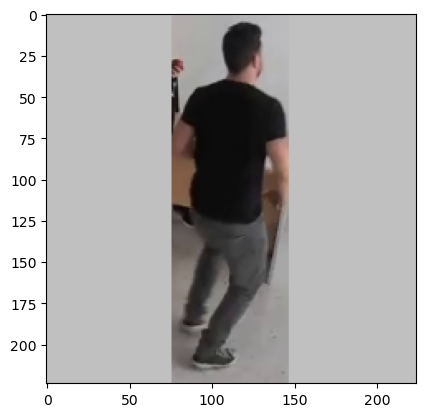

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.06480503, 2.67555046, 2.68094492, 2.53829885])]
img.shape 1: (224, 224, 3)


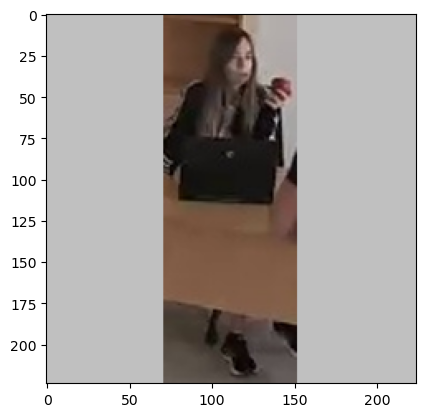

1/1 [==============================] - 0s 126ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.06480503, 2.67555046, 2.68094492, 2.53829885]), array([2.83647943, 2.77636933, 0.85406637, 2.63474703])]
[[3.06480503 2.67555046 2.68094492 2.53829885]
 [2.83647943 2.77636933 0.85406637 2.63474703]]
user: (1, 2) 0.8540663719177246


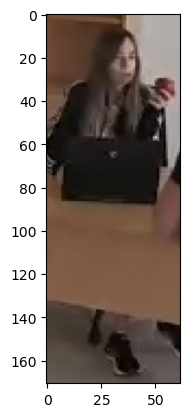

hs- [[3.06480503e+00 2.67555046e+00 1.00000000e+05 2.53829885e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 3) 2.5382988452911377


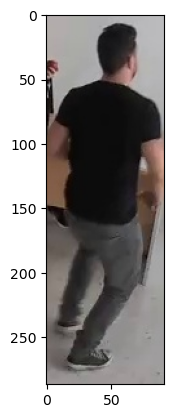

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446259 ['./out/office/raw_cam2/img3D\\1687446259_12.jpg', './out/office/raw_cam2/img3D\\1687446259_6.jpg', './out/office/raw_cam2/img3D\\1687446259_8.jpg']
./out/office/raw_cam2/img/1687446259*12_person.jpg
img.shape 0: (301, 120, 3) 2.5083333333333333
./out/office/raw_cam2/img/1687446259*6_person.jpg
img.shape 0: (85, 57, 3) 1.4912280701754386
bad image size: 1.4912280701754386
./out/office/raw_cam2/img/1687446259*8_person.jpg
img.shape 0: (173, 70, 3) 2.4714285714285715
new users: -1
img.shape 1: (224, 224, 3)


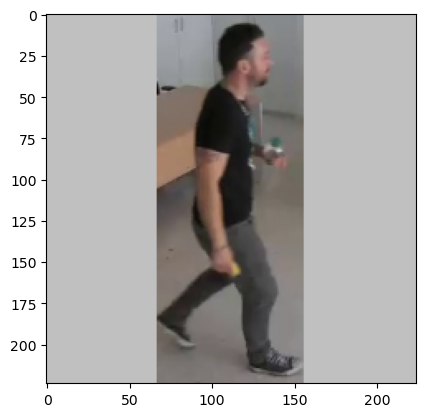

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.80804944, 2.70400786, 2.04569626, 1.26094472])]
img.shape 1: (224, 224, 3)


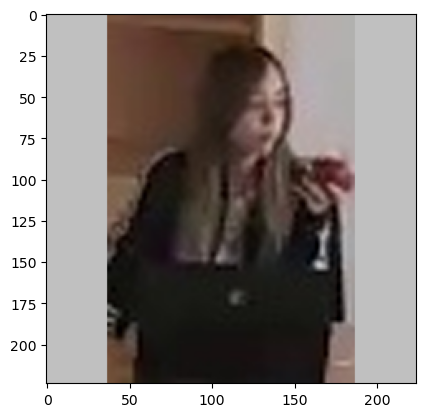

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.80804944, 2.70400786, 2.04569626, 1.26094472]), array([0.98230469, 3.03863049, 2.92161369, 2.68911433])]
img.shape 1: (224, 224, 3)


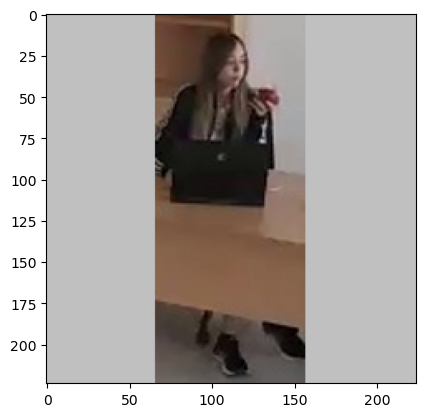

1/1 [==============================] - 0s 94ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.80804944, 2.70400786, 2.04569626, 1.26094472]), array([0.98230469, 3.03863049, 2.92161369, 2.68911433]), array([3.29193187, 2.97486639, 0.68759513, 2.40757465])]
[[2.80804944 2.70400786 2.04569626 1.26094472]
 [0.98230469 3.03863049 2.92161369 2.68911433]
 [3.29193187 2.97486639 0.68759513 2.40757465]]
user: (2, 2) 0.6875951290130615


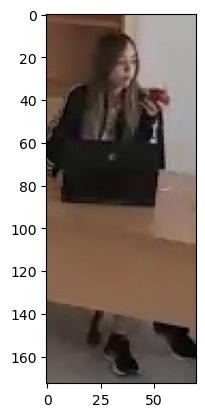

hs- [[2.80804944e+00 2.70400786e+00 1.00000000e+05 1.26094472e+00]
 [9.82304692e-01 3.03863049e+00 1.00000000e+05 2.68911433e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (1, 0) 0.9823046922683716


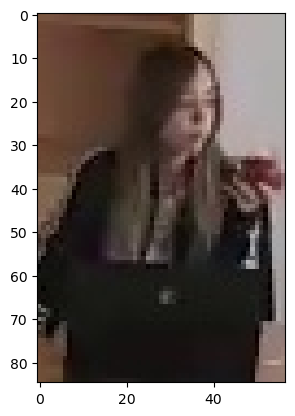

hs- [[1.00000000e+05 2.70400786e+00 1.00000000e+05 1.26094472e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 3) 1.2609447240829468


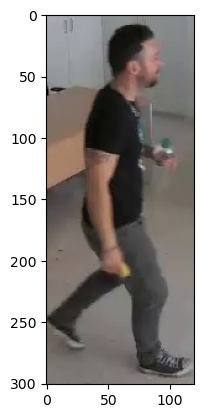

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446260 ['./out/office/raw_cam2/img3D\\1687446260_5.jpg', './out/office/raw_cam2/img3D\\1687446260_8.jpg']
./out/office/raw_cam2/img/1687446260*5_person.jpg
img.shape 0: (85, 60, 3) 1.4166666666666667
bad image size: 1.4166666666666667
./out/office/raw_cam2/img/1687446260*8_person.jpg
img.shape 0: (249, 53, 3) 4.69811320754717
new users: -2
img.shape 1: (224, 224, 3)


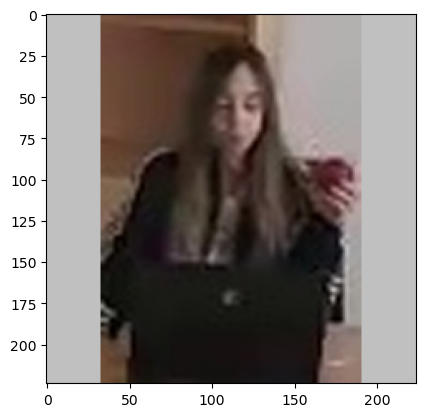

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.8578704 , 3.13058233, 3.23704839, 2.77592349])]
img.shape 1: (224, 224, 3)


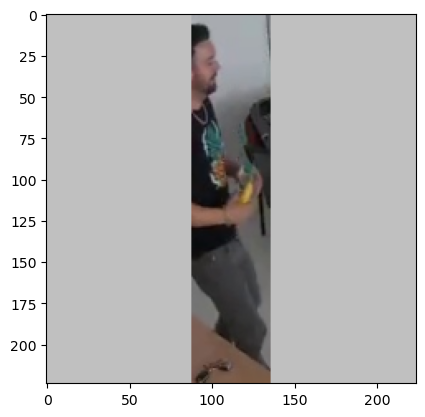

1/1 [==============================] - 0s 94ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.8578704 , 3.13058233, 3.23704839, 2.77592349]), array([2.71791649, 3.0321095 , 2.35645032, 1.83781111])]
[[0.8578704  3.13058233 3.23704839 2.77592349]
 [2.71791649 3.0321095  2.35645032 1.83781111]]
user: (0, 0) 0.8578703999519348


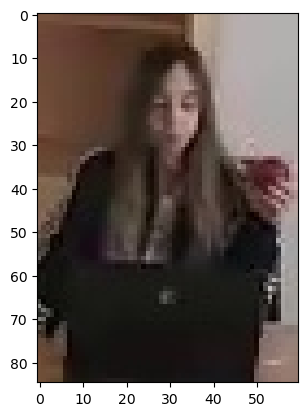

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 3.03210950e+00 2.35645032e+00 1.83781111e+00]]
user: (1, 3) 1.8378111124038696


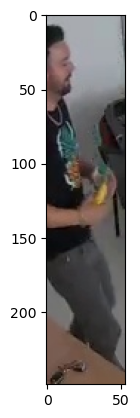

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446261 ['./out/office/raw_cam2/img3D\\1687446261_1.jpg', './out/office/raw_cam2/img3D\\1687446261_4.jpg']
./out/office/raw_cam2/img/1687446261*1_person.jpg
img.shape 0: (167, 66, 3) 2.5303030303030303
./out/office/raw_cam2/img/1687446261*4_person.jpg
img.shape 0: (79, 60, 3) 1.3166666666666667
bad image size: 1.3166666666666667
new users: -2
img.shape 1: (224, 224, 3)


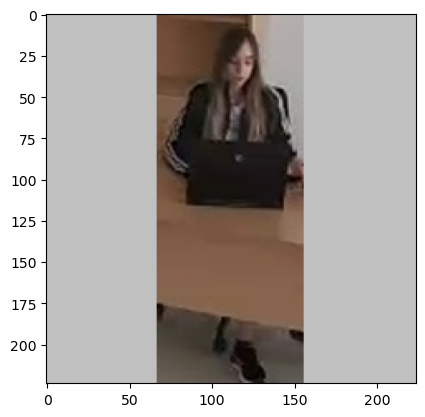

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.75454783, 3.01863837, 0.89470983, 1.97784305])]
img.shape 1: (224, 224, 3)


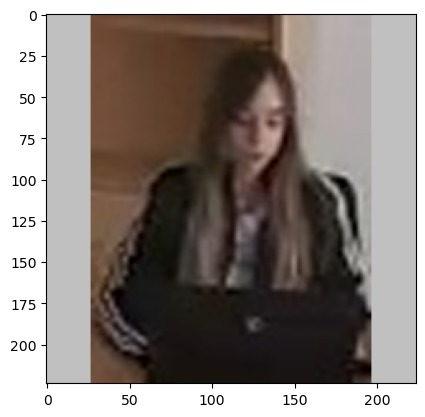

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.75454783, 3.01863837, 0.89470983, 1.97784305]), array([1.51151288, 3.51377988, 3.64808059, 2.95847583])]
[[2.75454783 3.01863837 0.89470983 1.97784305]
 [1.51151288 3.51377988 3.64808059 2.95847583]]
user: (0, 2) 0.8947098255157471


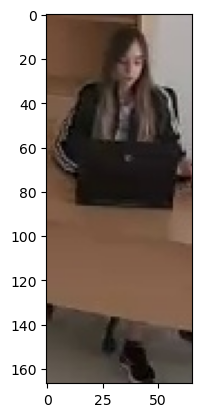

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.51151288e+00 3.51377988e+00 1.00000000e+05 2.95847583e+00]]
user: (1, 0) 1.5115128755569458


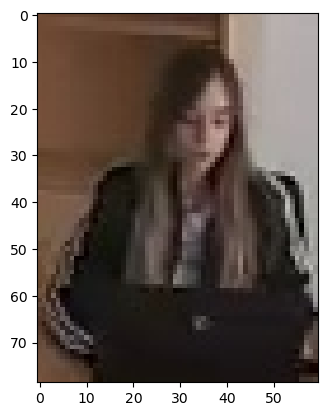

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446262 ['./out/office/raw_cam2/img3D\\1687446262_4.jpg', './out/office/raw_cam2/img3D\\1687446262_6.jpg']
./out/office/raw_cam2/img/1687446262*4_person.jpg
img.shape 0: (169, 60, 3) 2.816666666666667
./out/office/raw_cam2/img/1687446262*6_person.jpg
img.shape 0: (76, 53, 3) 1.4339622641509433
bad image size: 1.4339622641509433
new users: -2
img.shape 1: (224, 224, 3)


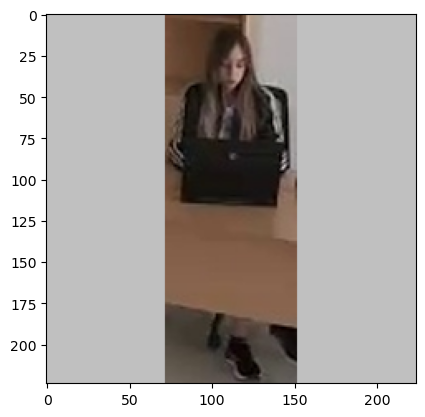

1/1 [==============================] - 0s 95ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.32481599, 3.21069574, 0.51633805, 2.12199092])]
img.shape 1: (224, 224, 3)


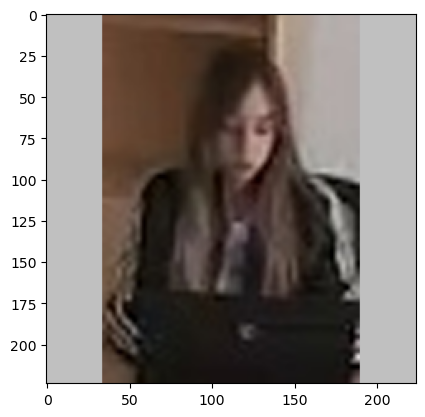

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.32481599, 3.21069574, 0.51633805, 2.12199092]), array([0.74933857, 3.34996414, 3.08635855, 2.68564963])]
[[3.32481599 3.21069574 0.51633805 2.12199092]
 [0.74933857 3.34996414 3.08635855 2.68564963]]
user: (0, 2) 0.516338050365448


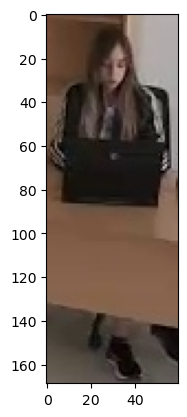

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [7.49338567e-01 3.34996414e+00 1.00000000e+05 2.68564963e+00]]
user: (1, 0) 0.7493385672569275


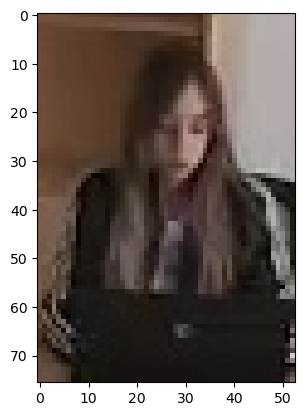

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446263 ['./out/office/raw_cam2/img3D\\1687446263_11.jpg', './out/office/raw_cam2/img3D\\1687446263_6.jpg']
./out/office/raw_cam2/img/1687446263*11_person.jpg
img.shape 0: (174, 64, 3) 2.71875
./out/office/raw_cam2/img/1687446263*6_person.jpg
img.shape 0: (78, 56, 3) 1.3928571428571428
bad image size: 1.3928571428571428
new users: -2
img.shape 1: (224, 224, 3)


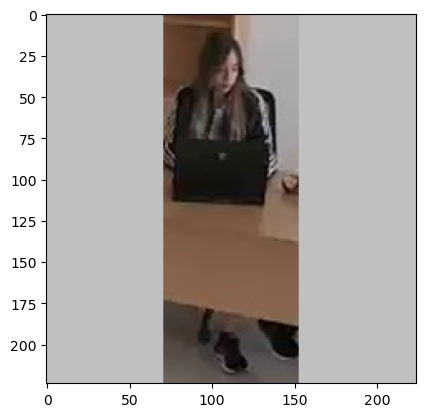

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.69269204, 3.34709787, 0.77117413, 2.2287004 ])]
img.shape 1: (224, 224, 3)


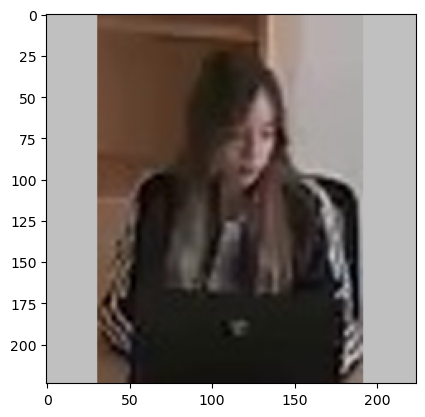

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.69269204, 3.34709787, 0.77117413, 2.2287004 ]), array([0.9801532 , 3.56764293, 3.5994904 , 2.90701222])]
[[3.69269204 3.34709787 0.77117413 2.2287004 ]
 [0.9801532  3.56764293 3.5994904  2.90701222]]
user: (0, 2) 0.7711741328239441


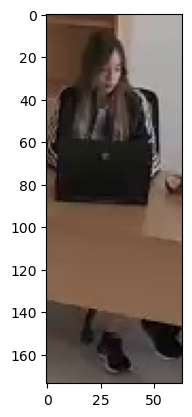

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [9.80153203e-01 3.56764293e+00 1.00000000e+05 2.90701222e+00]]
user: (1, 0) 0.9801532030105591


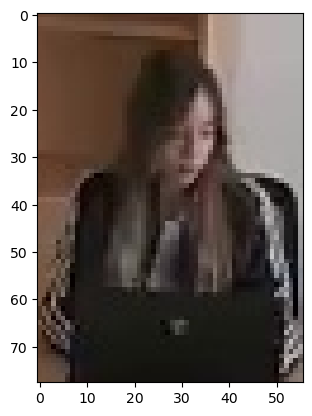

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446264 ['./out/office/raw_cam2/img3D\\1687446264_10.jpg', './out/office/raw_cam2/img3D\\1687446264_5.jpg']
./out/office/raw_cam2/img/1687446264*10_person.jpg
img.shape 0: (76, 56, 3) 1.3571428571428572
bad image size: 1.3571428571428572
./out/office/raw_cam2/img/1687446264*5_person.jpg
img.shape 0: (162, 58, 3) 2.793103448275862
new users: -2
img.shape 1: (224, 224, 3)


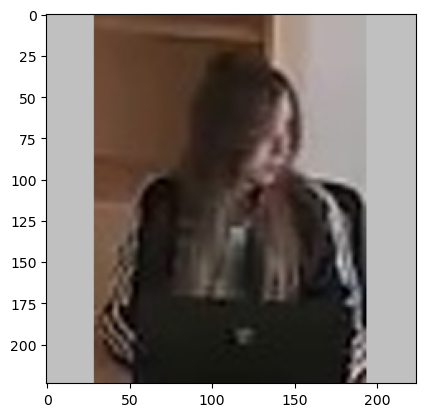

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0.       0.       0.       ... 0.       0.       1.236841]]
[array([0.9147296 , 3.59463882, 3.99629045, 3.00407028])]
img.shape 1: (224, 224, 3)


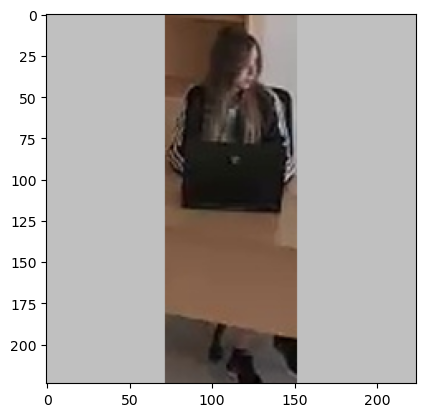

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.9147296 , 3.59463882, 3.99629045, 3.00407028]), array([3.3903687 , 3.11786842, 0.76654619, 1.95207381])]
[[0.9147296  3.59463882 3.99629045 3.00407028]
 [3.3903687  3.11786842 0.76654619 1.95207381]]
user: (1, 2) 0.7665461897850037


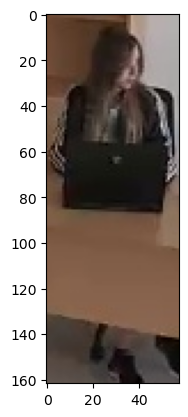

hs- [[9.14729595e-01 3.59463882e+00 1.00000000e+05 3.00407028e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 0.9147295951843262


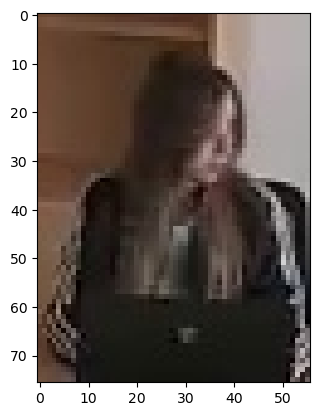

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446265 ['./out/office/raw_cam2/img3D\\1687446265_12.jpg', './out/office/raw_cam2/img3D\\1687446265_9.jpg']
./out/office/raw_cam2/img/1687446265*12_person.jpg
img.shape 0: (77, 56, 3) 1.375
bad image size: 1.375
./out/office/raw_cam2/img/1687446265*9_person.jpg
img.shape 0: (164, 60, 3) 2.7333333333333334
new users: -2
img.shape 1: (224, 224, 3)


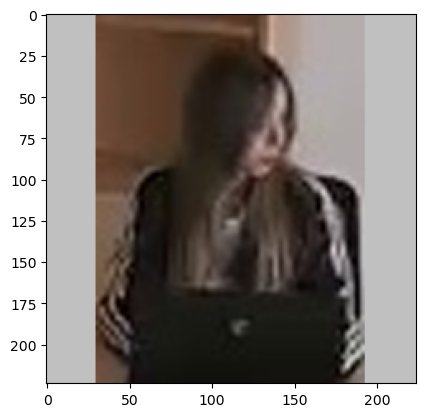

1/1 [==============================] - 0s 126ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.74933046, 3.55039954, 3.57445765, 2.90787554])]
img.shape 1: (224, 224, 3)


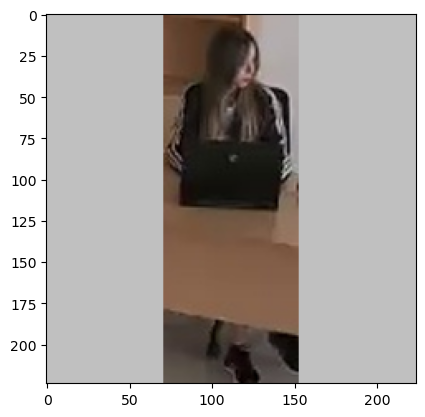

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.74933046, 3.55039954, 3.57445765, 2.90787554]), array([3.78650093, 3.15273952, 0.44952077, 2.1984992 ])]
[[0.74933046 3.55039954 3.57445765 2.90787554]
 [3.78650093 3.15273952 0.44952077 2.1984992 ]]
user: (1, 2) 0.4495207667350769


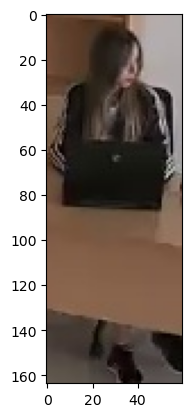

hs- [[7.49330461e-01 3.55039954e+00 1.00000000e+05 2.90787554e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 0.749330461025238


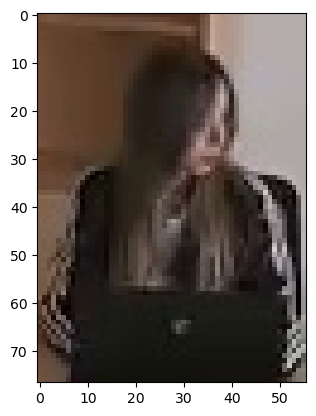

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446266 ['./out/office/raw_cam2/img3D\\1687446266_11.jpg', './out/office/raw_cam2/img3D\\1687446266_8.jpg']
./out/office/raw_cam2/img/1687446266*11_person.jpg
img.shape 0: (79, 56, 3) 1.4107142857142858
bad image size: 1.4107142857142858
./out/office/raw_cam2/img/1687446266*8_person.jpg
img.shape 0: (168, 58, 3) 2.896551724137931
new users: -2
img.shape 1: (224, 224, 3)


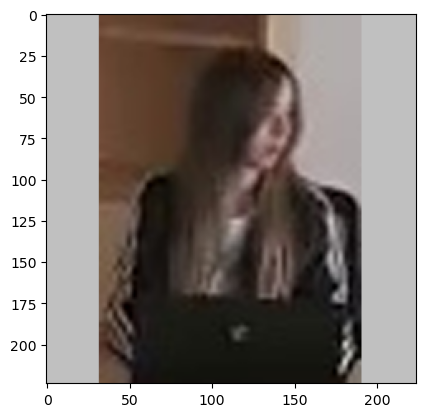

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.58317697, 3.47991514, 3.69365311, 2.7826252 ])]
img.shape 1: (224, 224, 3)


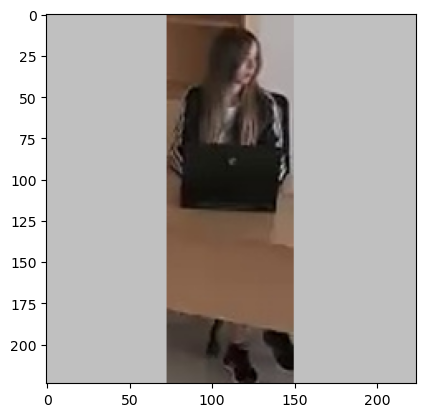

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.58317697, 3.47991514, 3.69365311, 2.7826252 ]), array([3.48814392, 2.99527884, 0.43199053, 1.95956659])]
[[0.58317697 3.47991514 3.69365311 2.7826252 ]
 [3.48814392 2.99527884 0.43199053 1.95956659]]
user: (1, 2) 0.43199053406715393


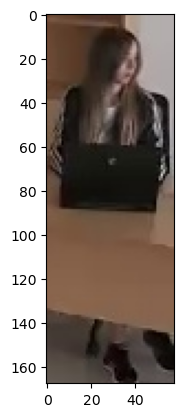

hs- [[5.83176970e-01 3.47991514e+00 1.00000000e+05 2.78262520e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 0.5831769704818726


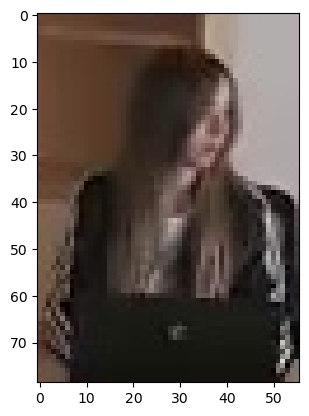

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446267 ['./out/office/raw_cam2/img3D\\1687446267_6.jpg', './out/office/raw_cam2/img3D\\1687446267_8.jpg']
./out/office/raw_cam2/img/1687446267*6_person.jpg
img.shape 0: (173, 66, 3) 2.621212121212121
./out/office/raw_cam2/img/1687446267*8_person.jpg
img.shape 0: (69, 63, 3) 1.0952380952380953
bad image size: 1.0952380952380953
new users: -2
img.shape 1: (224, 224, 3)


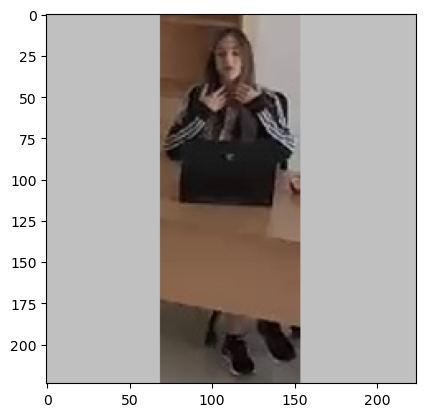

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0.        0.        0.        ... 0.1444552 0.        0.       ]]
[array([3.67823768, 3.22553277, 1.00919414, 2.15221524])]
img.shape 1: (224, 224, 3)


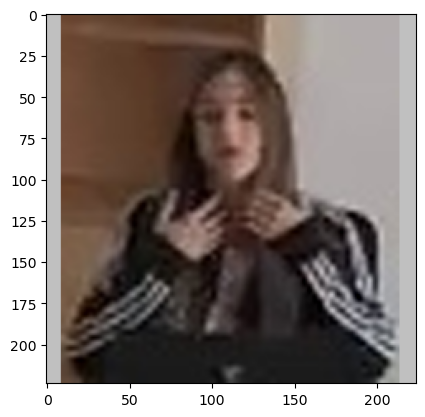

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0.        0.        0.        ... 0.        0.        3.6068058]]
[array([3.67823768, 3.22553277, 1.00919414, 2.15221524]), array([2.20187306, 4.03100443, 3.96272874, 3.32634592])]
[[3.67823768 3.22553277 1.00919414 2.15221524]
 [2.20187306 4.03100443 3.96272874 3.32634592]]
user: (0, 2) 1.0091941356658936


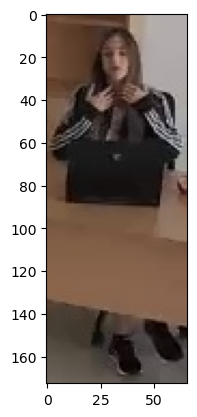

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [2.20187306e+00 4.03100443e+00 1.00000000e+05 3.32634592e+00]]
user: (1, 0) 2.2018730640411377


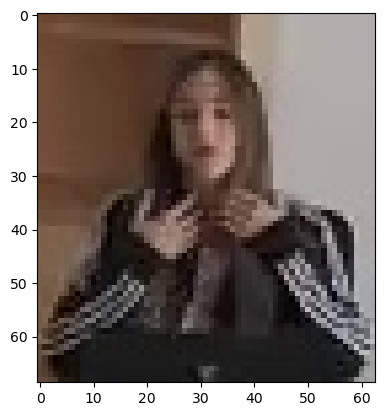

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446268 ['./out/office/raw_cam2/img3D\\1687446268_8.jpg']
./out/office/raw_cam2/img/1687446268*8_person.jpg
img.shape 0: (66, 72, 3) 0.9166666666666666
bad image size: 0.9166666666666666
new users: -3
img.shape 1: (224, 224, 3)


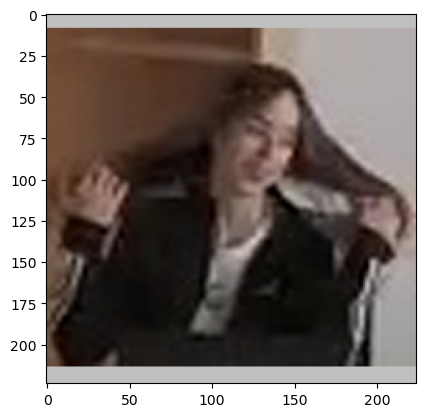

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.73887062, 4.15180826, 4.12116528, 3.2997539 ])]
[[2.73887062 4.15180826 4.12116528 3.2997539 ]]
user: (0, 0) 2.738870620727539


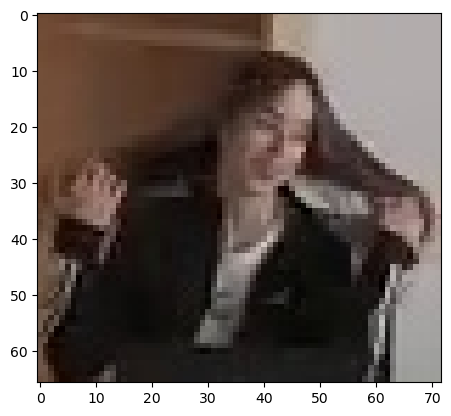

hs- [[100000. 100000. 100000. 100000.]]
1687446269 []
1687446270 ['./out/office/raw_cam2/img3D\\1687446270_7.jpg']
./out/office/raw_cam2/img/1687446270*7_person.jpg
img.shape 0: (71, 55, 3) 1.290909090909091
bad image size: 1.290909090909091
new users: -3
img.shape 1: (224, 224, 3)


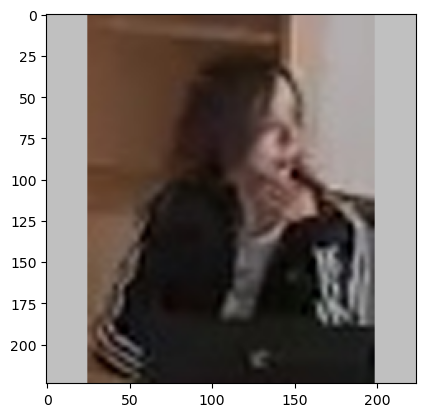

1/1 [==============================] - 0s 94ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.19797158, 3.68043232, 3.76515484, 3.03180051])]
[[2.19797158 3.68043232 3.76515484 3.03180051]]
user: (0, 0) 2.1979715824127197


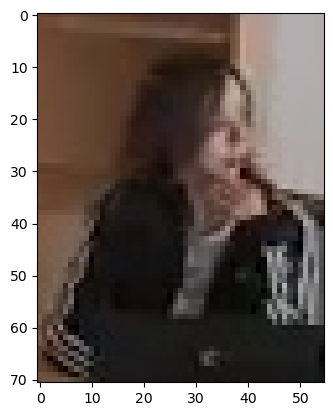

hs- [[100000. 100000. 100000. 100000.]]
1687446271 ['./out/office/raw_cam2/img3D\\1687446271_4.jpg']
./out/office/raw_cam2/img/1687446271*4_person.jpg
img.shape 0: (68, 49, 3) 1.3877551020408163
bad image size: 1.3877551020408163
new users: -3
img.shape 1: (224, 224, 3)


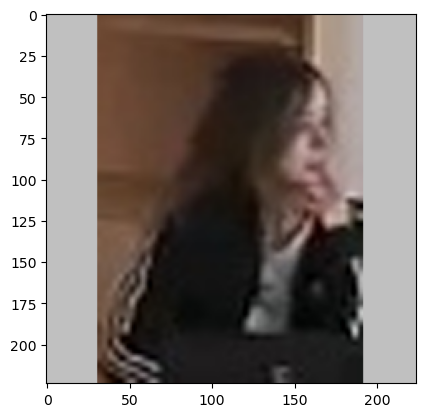

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.31907701, 3.45257592, 3.55879521, 2.72830272])]
[[1.31907701 3.45257592 3.55879521 2.72830272]]
user: (0, 0) 1.3190770149230957


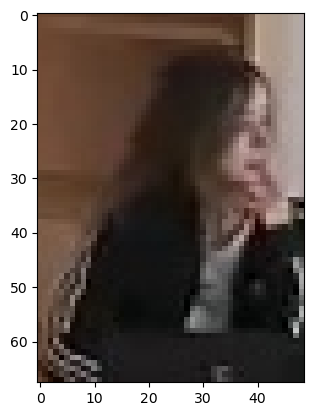

hs- [[100000. 100000. 100000. 100000.]]
1687446272 ['./out/office/raw_cam2/img3D\\1687446272_4.jpg']
./out/office/raw_cam2/img/1687446272*4_person.jpg
img.shape 0: (69, 55, 3) 1.2545454545454546
bad image size: 1.2545454545454546
new users: -3
img.shape 1: (224, 224, 3)


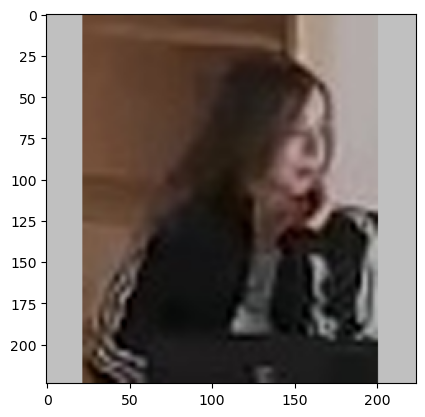

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([0.92600274, 3.72587252, 3.86016512, 3.0522759 ])]
[[0.92600274 3.72587252 3.86016512 3.0522759 ]]
user: (0, 0) 0.9260027408599854


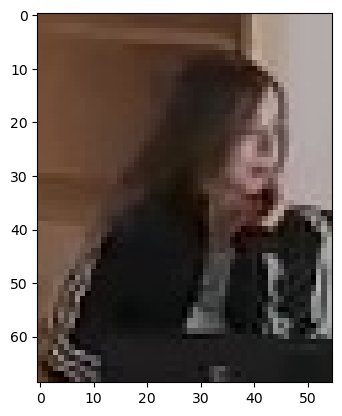

hs- [[100000. 100000. 100000. 100000.]]
1687446273 ['./out/office/raw_cam2/img3D\\1687446273_8.jpg']
./out/office/raw_cam2/img/1687446273*8_person.jpg
img.shape 0: (68, 56, 3) 1.2142857142857142
bad image size: 1.2142857142857142
new users: -3
img.shape 1: (224, 224, 3)


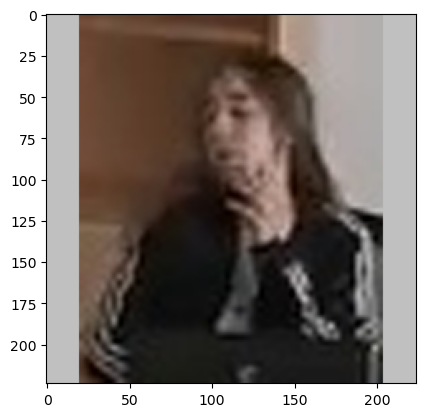

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.39594555, 3.50867414, 3.50553322, 2.85714817])]
[[1.39594555 3.50867414 3.50553322 2.85714817]]
user: (0, 0) 1.3959455490112305


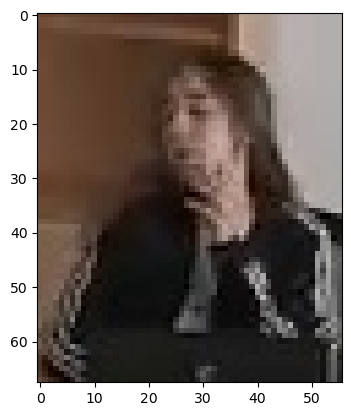

hs- [[100000. 100000. 100000. 100000.]]
1687446274 ['./out/office/raw_cam2/img3D\\1687446274_11.jpg', './out/office/raw_cam2/img3D\\1687446274_7.jpg']
./out/office/raw_cam2/img/1687446274*11_person.jpg
img.shape 0: (284, 122, 3) 2.3278688524590163
./out/office/raw_cam2/img/1687446274*7_person.jpg
img.shape 0: (62, 47, 3) 1.3191489361702127
bad image size: 1.3191489361702127
new users: -2
img.shape 1: (224, 224, 3)


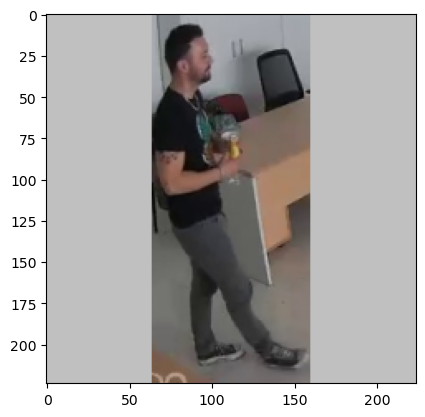

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.67787075, 3.06383848, 2.74244261, 2.15886545])]
img.shape 1: (224, 224, 3)


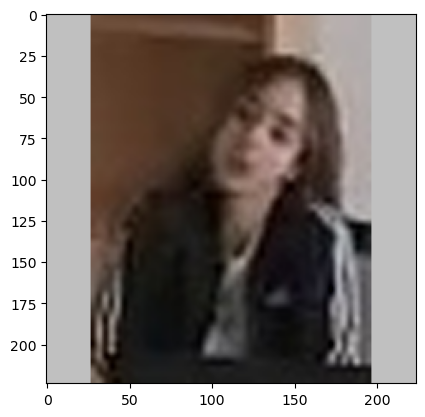

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.67787075, 3.06383848, 2.74244261, 2.15886545]), array([1.29519439, 3.36866927, 3.3393991 , 2.59728265])]
[[3.67787075 3.06383848 2.74244261 2.15886545]
 [1.29519439 3.36866927 3.3393991  2.59728265]]
user: (1, 0) 1.295194387435913


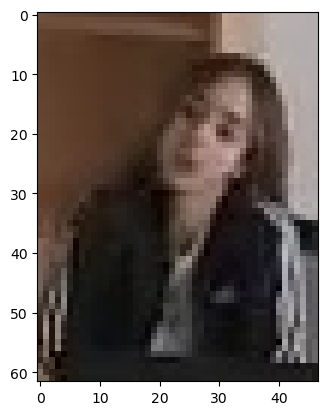

hs- [[1.00000000e+05 3.06383848e+00 2.74244261e+00 2.15886545e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 3) 2.158865451812744


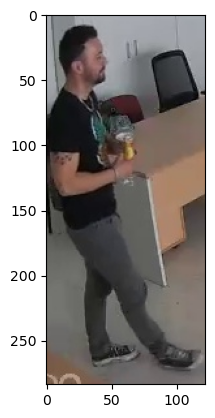

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446275 ['./out/office/raw_cam2/img3D\\1687446275_11.jpg', './out/office/raw_cam2/img3D\\1687446275_6.jpg', './out/office/raw_cam2/img3D\\1687446275_7.jpg']
./out/office/raw_cam2/img/1687446275*11_person.jpg
img.shape 0: (290, 92, 3) 3.152173913043478
./out/office/raw_cam2/img/1687446275*6_person.jpg
img.shape 0: (73, 50, 3) 1.46
bad image size: 1.46
./out/office/raw_cam2/img/1687446275*7_person.jpg
img.shape 0: (175, 55, 3) 3.1818181818181817
new users: -1
img.shape 1: (224, 224, 3)


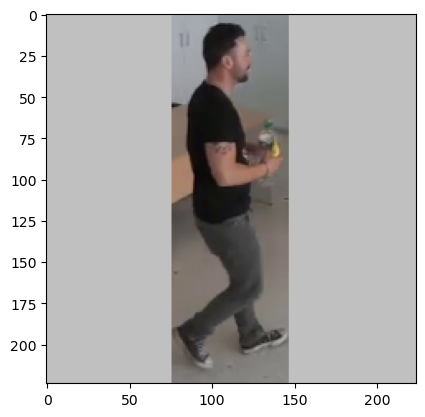

1/1 [==============================] - 0s 104ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.06957412, 2.63833642, 2.46925378, 1.52184343])]
img.shape 1: (224, 224, 3)


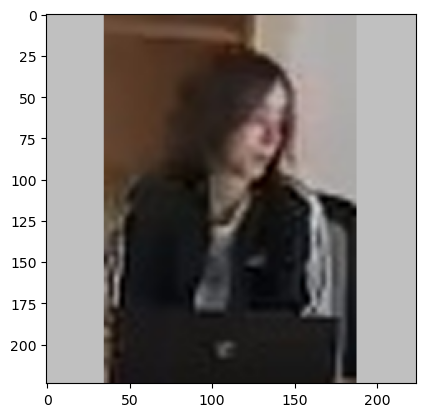

1/1 [==============================] - 0s 111ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.06957412, 2.63833642, 2.46925378, 1.52184343]), array([1.37456632, 3.56355   , 3.74508023, 3.43809199])]
img.shape 1: (224, 224, 3)


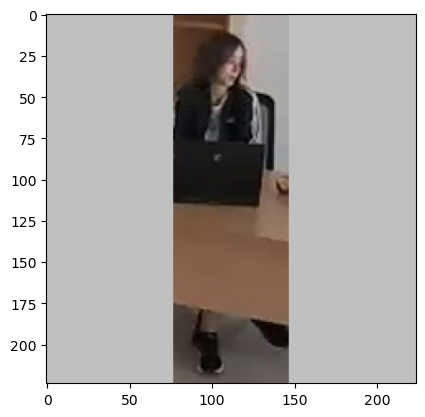

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.06957412, 2.63833642, 2.46925378, 1.52184343]), array([1.37456632, 3.56355   , 3.74508023, 3.43809199]), array([3.7739501 , 3.21059752, 1.32600117, 2.47358537])]
[[3.06957412 2.63833642 2.46925378 1.52184343]
 [1.37456632 3.56355    3.74508023 3.43809199]
 [3.7739501  3.21059752 1.32600117 2.47358537]]
user: (2, 2) 1.3260011672973633


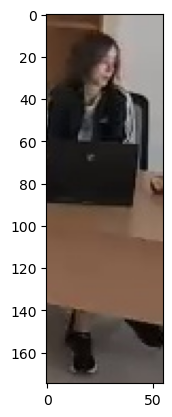

hs- [[3.06957412e+00 2.63833642e+00 1.00000000e+05 1.52184343e+00]
 [1.37456632e+00 3.56355000e+00 1.00000000e+05 3.43809199e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (1, 0) 1.3745663166046143


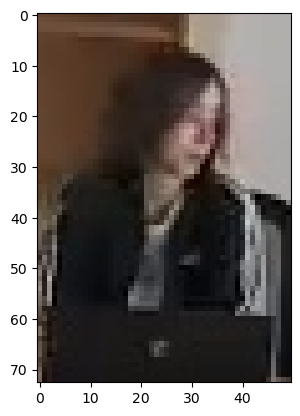

hs- [[1.00000000e+05 2.63833642e+00 1.00000000e+05 1.52184343e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 3) 1.521843433380127


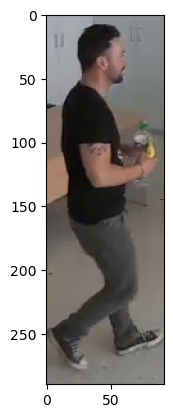

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446276 ['./out/office/raw_cam2/img3D\\1687446276_6.jpg', './out/office/raw_cam2/img3D\\1687446276_9.jpg']
./out/office/raw_cam2/img/1687446276*6_person.jpg
img.shape 0: (175, 57, 3) 3.0701754385964914
./out/office/raw_cam2/img/1687446276*9_person.jpg
img.shape 0: (283, 87, 3) 3.2528735632183907
new users: -2
img.shape 1: (224, 224, 3)


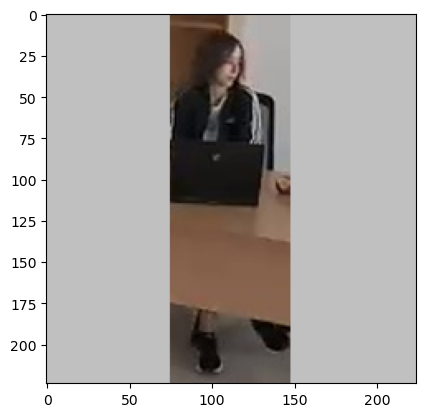

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.98680139, 3.25383425, 0.25303897, 2.45263076])]
img.shape 1: (224, 224, 3)


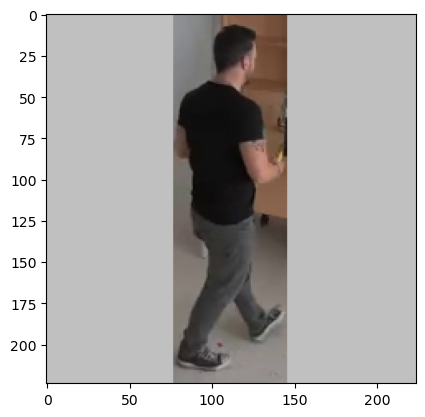

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.98680139, 3.25383425, 0.25303897, 2.45263076]), array([3.11393237, 2.61167431, 2.35458589, 0.90743917])]
[[3.98680139 3.25383425 0.25303897 2.45263076]
 [3.11393237 2.61167431 2.35458589 0.90743917]]
user: (0, 2) 0.2530389726161957


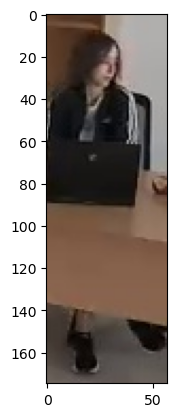

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [3.11393237e+00 2.61167431e+00 1.00000000e+05 9.07439172e-01]]
user: (1, 3) 0.9074391722679138


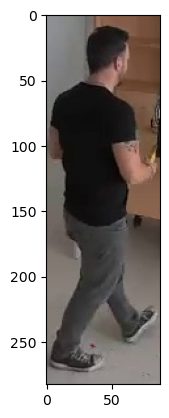

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446277 ['./out/office/raw_cam2/img3D\\1687446277_8.jpg']
./out/office/raw_cam2/img/1687446277*8_person.jpg
img.shape 0: (261, 88, 3) 2.965909090909091
new users: -3
img.shape 1: (224, 224, 3)


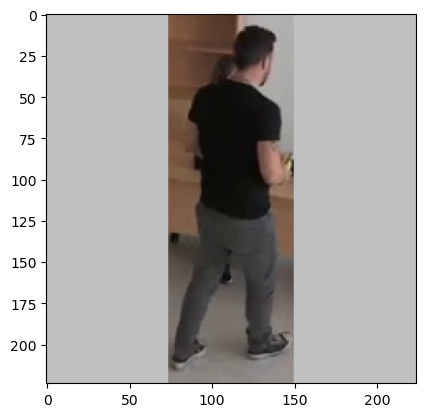

1/1 [==============================] - 0s 100ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.82452464, 2.37133956, 2.33889771, 0.63960868])]
[[2.82452464 2.37133956 2.33889771 0.63960868]]
user: (0, 3) 0.6396086812019348


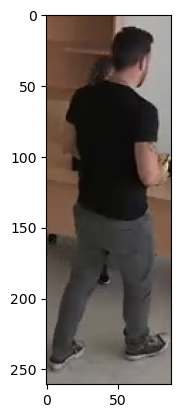

hs- [[100000. 100000. 100000. 100000.]]
1687446278 ['./out/office/raw_cam2/img3D\\1687446278_10.jpg', './out/office/raw_cam2/img3D\\1687446278_8.jpg']
./out/office/raw_cam2/img/1687446278*10_person.jpg
img.shape 0: (248, 84, 3) 2.9523809523809526
./out/office/raw_cam2/img/1687446278*8_person.jpg
img.shape 0: (88, 46, 3) 1.9130434782608696
new users: -2
img.shape 1: (224, 224, 3)


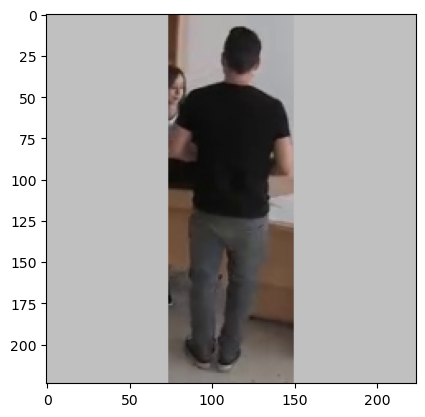

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.94160366, 2.60412502, 2.56917644, 0.85827541])]
img.shape 1: (224, 224, 3)


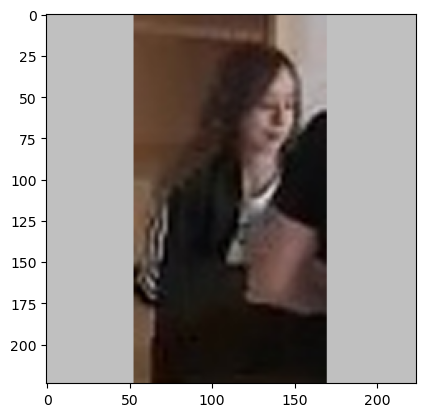

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.94160366, 2.60412502, 2.56917644, 0.85827541]), array([1.69058788, 2.89445829, 3.13759637, 1.95713091])]
[[2.94160366 2.60412502 2.56917644 0.85827541]
 [1.69058788 2.89445829 3.13759637 1.95713091]]
user: (0, 3) 0.8582754135131836


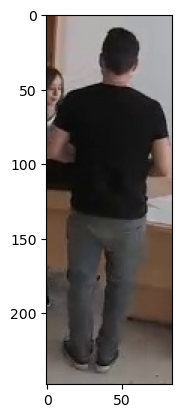

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [1.69058788e+00 2.89445829e+00 3.13759637e+00 1.00000000e+05]]
user: (1, 0) 1.6905878782272339


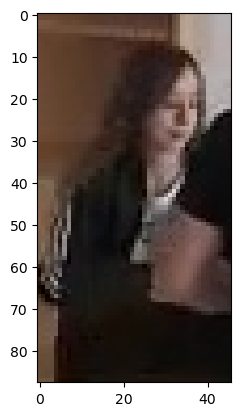

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446279 ['./out/office/raw_cam2/img3D\\1687446279_7.jpg', './out/office/raw_cam2/img3D\\1687446279_8.jpg']
./out/office/raw_cam2/img/1687446279*7_person.jpg
img.shape 0: (70, 46, 3) 1.5217391304347827
bad image size: 1.5217391304347827
./out/office/raw_cam2/img/1687446279*8_person.jpg
img.shape 0: (246, 100, 3) 2.46
new users: -2
img.shape 1: (224, 224, 3)


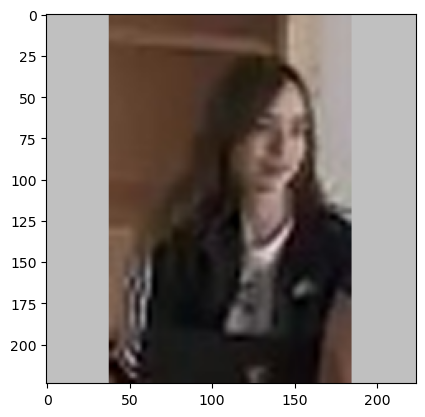

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.30227625, 3.34779525, 3.9042182 , 2.78253078])]
img.shape 1: (224, 224, 3)


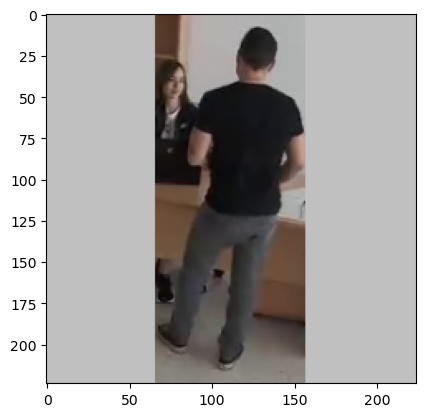

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.30227625, 3.34779525, 3.9042182 , 2.78253078]), array([2.34262562, 2.58455515, 2.70164514, 0.79016143])]
[[1.30227625 3.34779525 3.9042182  2.78253078]
 [2.34262562 2.58455515 2.70164514 0.79016143]]
user: (1, 3) 0.7901614308357239


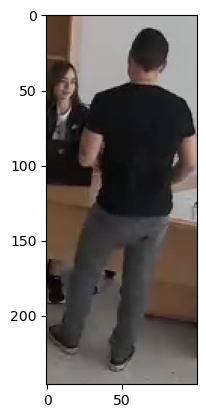

hs- [[1.30227625e+00 3.34779525e+00 3.90421820e+00 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 1.3022762537002563


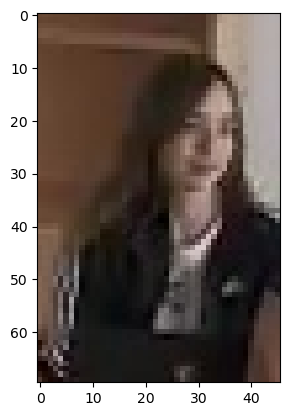

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446280 ['./out/office/raw_cam2/img3D\\1687446280_10.jpg', './out/office/raw_cam2/img3D\\1687446280_9.jpg']
./out/office/raw_cam2/img/1687446280*10_person.jpg
img.shape 0: (248, 102, 3) 2.4313725490196076
./out/office/raw_cam2/img/1687446280*9_person.jpg
img.shape 0: (79, 47, 3) 1.6808510638297873
bad image size: 1.6808510638297873
new users: -2
img.shape 1: (224, 224, 3)


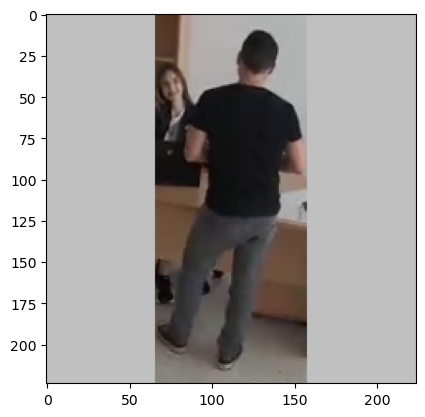

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.66308808, 2.55869317, 2.67987895, 0.27785623])]
img.shape 1: (224, 224, 3)


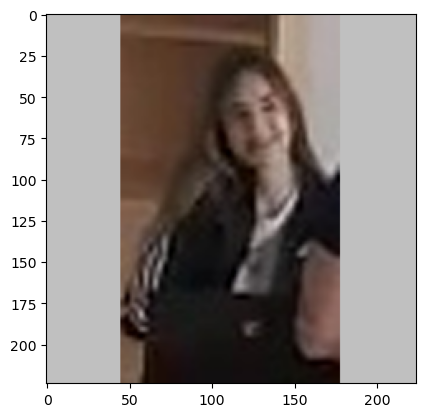

1/1 [==============================] - 0s 126ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.66308808, 2.55869317, 2.67987895, 0.27785623]), array([0.91295272, 3.12213159, 3.67393517, 2.81183648])]
[[2.66308808 2.55869317 2.67987895 0.27785623]
 [0.91295272 3.12213159 3.67393517 2.81183648]]
user: (0, 3) 0.2778562307357788


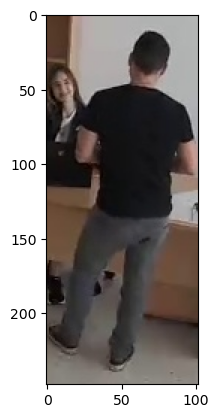

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]
 [9.12952721e-01 3.12213159e+00 3.67393517e+00 1.00000000e+05]]
user: (1, 0) 0.912952721118927


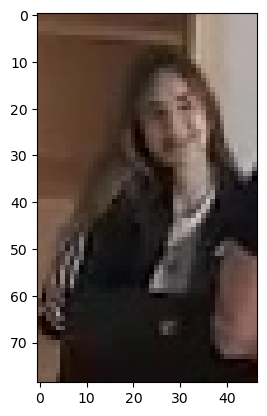

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446281 ['./out/office/raw_cam2/img3D\\1687446281_8.jpg']
./out/office/raw_cam2/img/1687446281*8_person.jpg
img.shape 0: (240, 86, 3) 2.7906976744186047
new users: -3
img.shape 1: (224, 224, 3)


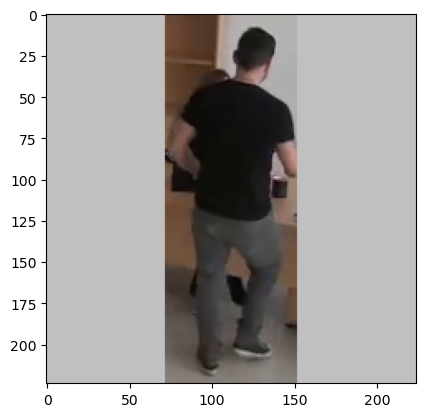

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.55172706, 2.42722011, 2.45710564, 0.80338699])]
[[2.55172706 2.42722011 2.45710564 0.80338699]]
user: (0, 3) 0.8033869862556458


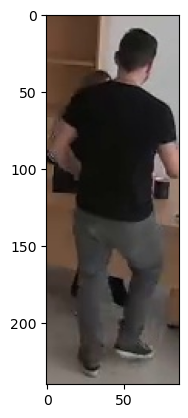

hs- [[100000. 100000. 100000. 100000.]]
1687446282 ['./out/office/raw_cam2/img3D\\1687446282_7.jpg']
./out/office/raw_cam2/img/1687446282*7_person.jpg
img.shape 0: (238, 94, 3) 2.5319148936170213
new users: -3
img.shape 1: (224, 224, 3)


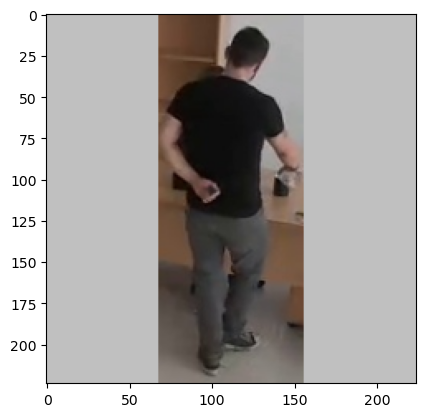

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.55405951, 2.30464554, 2.45142722, 0.69029766])]
[[2.55405951 2.30464554 2.45142722 0.69029766]]
user: (0, 3) 0.6902976632118225


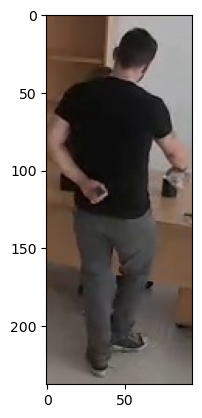

hs- [[100000. 100000. 100000. 100000.]]
1687446283 ['./out/office/raw_cam2/img3D\\1687446283_8.jpg']
./out/office/raw_cam2/img/1687446283*8_person.jpg
img.shape 0: (238, 93, 3) 2.5591397849462365
new users: -3
img.shape 1: (224, 224, 3)


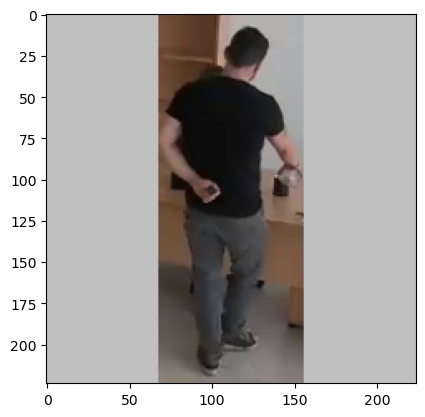

1/1 [==============================] - 0s 126ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.59059668, 2.38312459, 2.42329478, 0.19735284])]
[[2.59059668 2.38312459 2.42329478 0.19735284]]
user: (0, 3) 0.1973528414964676


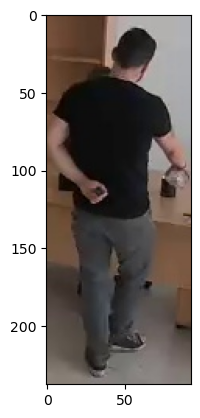

hs- [[100000. 100000. 100000. 100000.]]
1687446284 ['./out/office/raw_cam2/img3D\\1687446284_7.jpg']
./out/office/raw_cam2/img/1687446284*7_person.jpg
img.shape 0: (242, 89, 3) 2.7191011235955056
new users: -3
img.shape 1: (224, 224, 3)


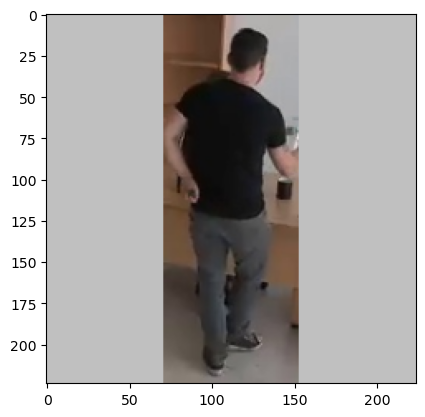

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.49501872, 2.36798263, 2.33004403, 0.34217057])]
[[2.49501872 2.36798263 2.33004403 0.34217057]]
user: (0, 3) 0.3421705663204193


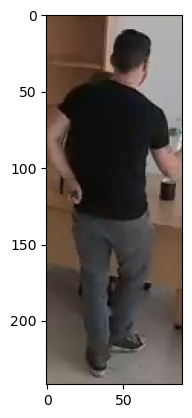

hs- [[100000. 100000. 100000. 100000.]]
1687446285 ['./out/office/raw_cam2/img3D\\1687446285_8.jpg']
./out/office/raw_cam2/img/1687446285*8_person.jpg
img.shape 0: (254, 80, 3) 3.175
new users: -3
img.shape 1: (224, 224, 3)


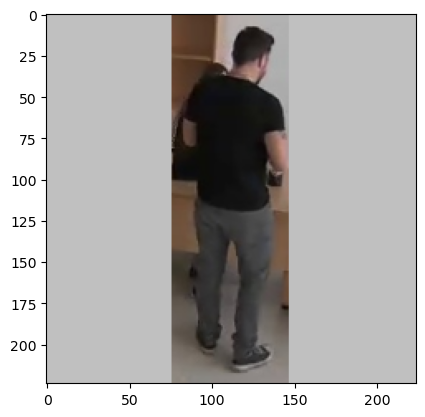

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.56307292, 2.50939775, 2.24010324, 0.57999218])]
[[2.56307292 2.50939775 2.24010324 0.57999218]]
user: (0, 3) 0.5799921751022339


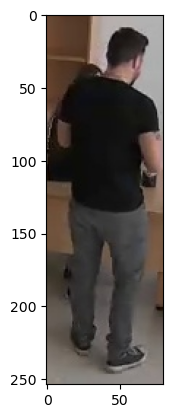

hs- [[100000. 100000. 100000. 100000.]]
1687446286 ['./out/office/raw_cam2/img3D\\1687446286_7.jpg', './out/office/raw_cam2/img3D\\1687446286_8.jpg']
./out/office/raw_cam2/img/1687446286*7_person.jpg
img.shape 0: (88, 45, 3) 1.9555555555555555
./out/office/raw_cam2/img/1687446286*8_person.jpg
img.shape 0: (251, 101, 3) 2.485148514851485
new users: -2
img.shape 1: (224, 224, 3)


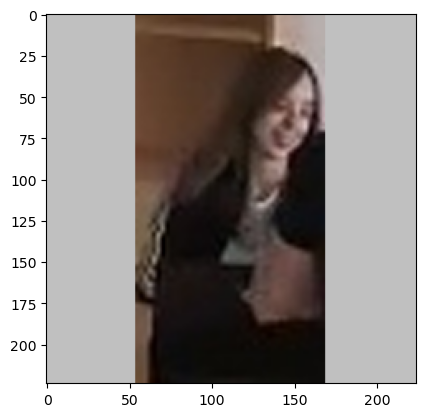

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.49807143, 3.10977483, 3.3105185 , 2.323838  ])]
img.shape 1: (224, 224, 3)


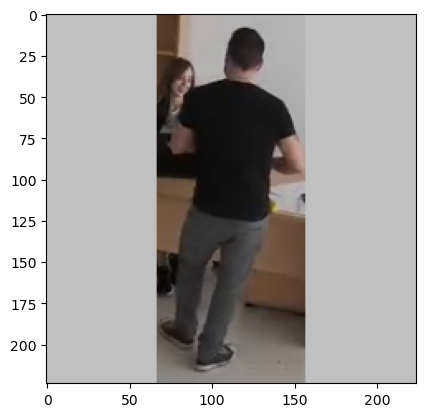

1/1 [==============================] - 0s 106ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.49807143, 3.10977483, 3.3105185 , 2.323838  ]), array([2.58314681, 2.33236051, 2.56554222, 0.91521269])]
[[1.49807143 3.10977483 3.3105185  2.323838  ]
 [2.58314681 2.33236051 2.56554222 0.91521269]]
user: (1, 3) 0.9152126908302307


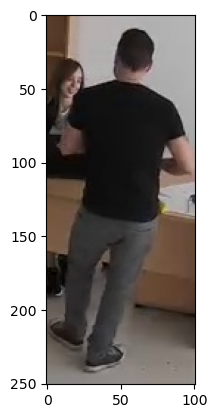

hs- [[1.49807143e+00 3.10977483e+00 3.31051850e+00 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 1.4980714321136475


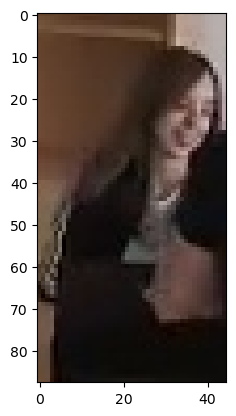

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446287 ['./out/office/raw_cam2/img3D\\1687446287_4.jpg', './out/office/raw_cam2/img3D\\1687446287_9.jpg']
./out/office/raw_cam2/img/1687446287*4_person.jpg
img.shape 0: (56, 39, 3) 1.435897435897436
bad image size: 1.435897435897436
./out/office/raw_cam2/img/1687446287*9_person.jpg
img.shape 0: (249, 93, 3) 2.6774193548387095
new users: -2
img.shape 1: (224, 224, 3)


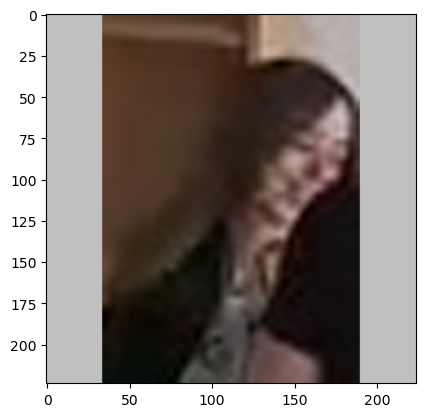

1/1 [==============================] - 0s 126ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.80717969, 4.25452423, 4.79288578, 3.78007102])]
img.shape 1: (224, 224, 3)


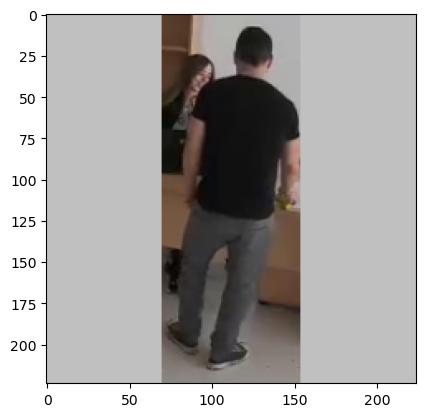

1/1 [==============================] - 0s 116ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.80717969, 4.25452423, 4.79288578, 3.78007102]), array([2.41381478, 2.66568208, 2.70256615, 0.64759737])]
[[2.80717969 4.25452423 4.79288578 3.78007102]
 [2.41381478 2.66568208 2.70256615 0.64759737]]
user: (1, 3) 0.6475973725318909


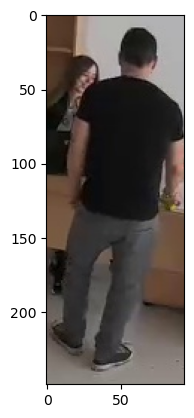

hs- [[2.80717969e+00 4.25452423e+00 4.79288578e+00 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 2.8071796894073486


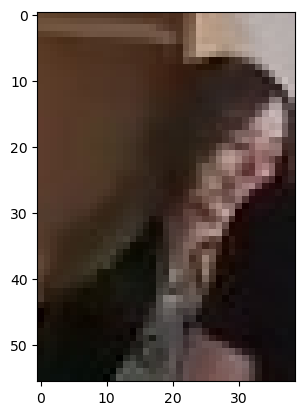

hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446288 ['./out/office/raw_cam2/img3D\\1687446288_11.jpg']
./out/office/raw_cam2/img/1687446288*11_person.jpg
img.shape 0: (254, 79, 3) 3.2151898734177213
new users: -3
img.shape 1: (224, 224, 3)


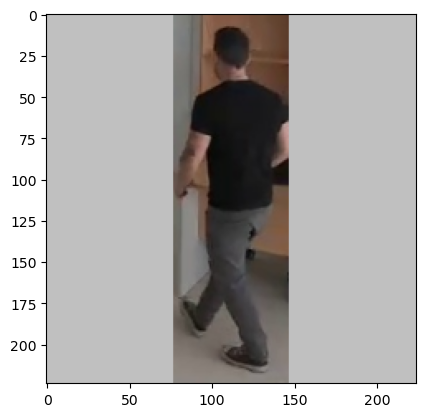

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.73942327, 2.59447622, 2.32384562, 0.92012155])]
[[2.73942327 2.59447622 2.32384562 0.92012155]]
user: (0, 3) 0.9201215505599976


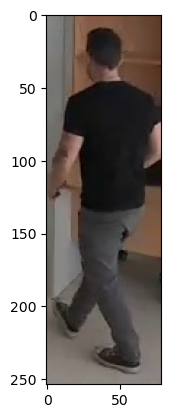

hs- [[100000. 100000. 100000. 100000.]]
1687446289 ['./out/office/raw_cam2/img3D\\1687446289_11.jpg', './out/office/raw_cam2/img3D\\1687446289_12.jpg']
./out/office/raw_cam2/img/1687446289*11_person.jpg
img.shape 0: (68, 57, 3) 1.1929824561403508
bad image size: 1.1929824561403508
./out/office/raw_cam2/img/1687446289*12_person.jpg
img.shape 0: (219, 73, 3) 3.0
new users: -2
img.shape 1: (224, 224, 3)


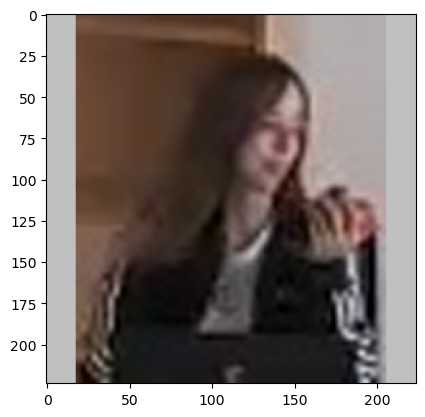

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.27820158, 4.22036123, 4.85889721, 3.57531571])]
img.shape 1: (224, 224, 3)


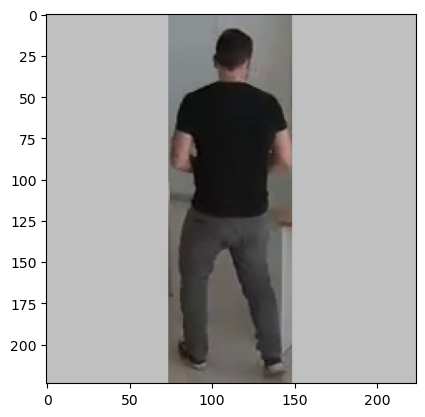

1/1 [==============================] - 0s 100ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.27820158, 4.22036123, 4.85889721, 3.57531571]), array([2.9400475 , 2.39429712, 2.64004397, 0.80999964])]
[[3.27820158 4.22036123 4.85889721 3.57531571]
 [2.9400475  2.39429712 2.64004397 0.80999964]]
user: (1, 3) 0.8099996447563171


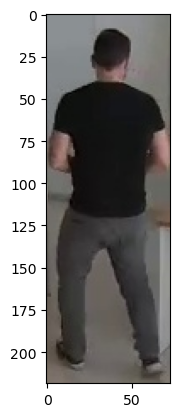

hs- [[3.27820158e+00 4.22036123e+00 4.85889721e+00 1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05]]
user: (0, 0) 3.2782015800476074


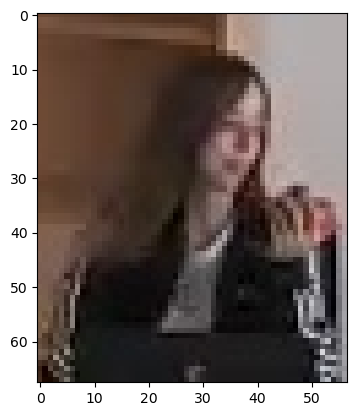

New user!
hs- [[100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000.]]
1687446290 ['./out/office/raw_cam2/img3D\\1687446290_1.jpg', './out/office/raw_cam2/img3D\\1687446290_11.jpg', './out/office/raw_cam2/img3D\\1687446290_13.jpg']
./out/office/raw_cam2/img/1687446290*1_person.jpg
img.shape 0: (68, 61, 3) 1.1147540983606556
bad image size: 1.1147540983606556
./out/office/raw_cam2/img/1687446290*11_person.jpg
img.shape 0: (68, 61, 3) 1.1147540983606556
bad image size: 1.1147540983606556
./out/office/raw_cam2/img/1687446290*13_person.jpg
img.shape 0: (205, 42, 3) 4.880952380952381
new users: -2
img.shape 1: (224, 224, 3)


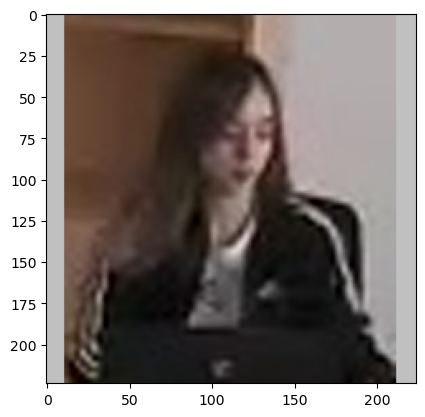

1/1 [==============================] - 0s 126ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.90082407, 4.29501915, 4.68443775, 3.60400772, 2.18323755])]
img.shape 1: (224, 224, 3)


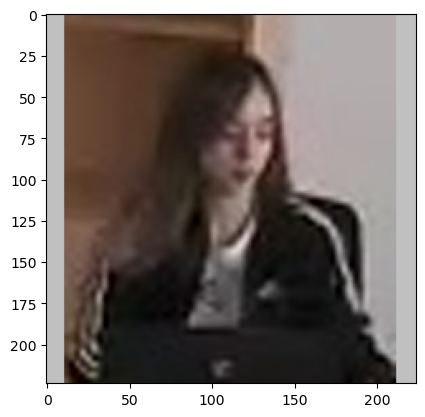

1/1 [==============================] - 0s 104ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.90082407, 4.29501915, 4.68443775, 3.60400772, 2.18323755]), array([1.90082407, 4.29501915, 4.68443775, 3.60400772, 2.18323755])]
img.shape 1: (224, 224, 3)


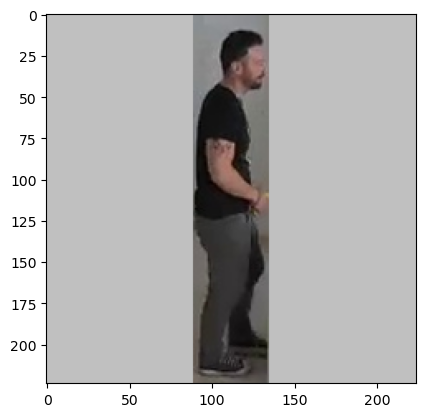

1/1 [==============================] - 0s 126ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.90082407, 4.29501915, 4.68443775, 3.60400772, 2.18323755]), array([1.90082407, 4.29501915, 4.68443775, 3.60400772, 2.18323755]), array([2.82466435, 2.44035673, 2.48540211, 0.99943954, 3.65491152])]
[[1.90082407 4.29501915 4.68443775 3.60400772 2.18323755]
 [1.90082407 4.29501915 4.68443775 3.60400772 2.18323755]
 [2.82466435 2.44035673 2.48540211 0.99943954 3.65491152]]
user: (2, 3) 0.999439537525177


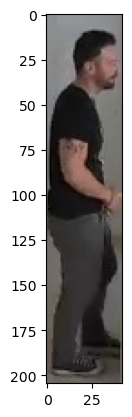

hs- [[1.90082407e+00 4.29501915e+00 4.68443775e+00 1.00000000e+05
  2.18323755e+00]
 [1.90082407e+00 4.29501915e+00 4.68443775e+00 1.00000000e+05
  2.18323755e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]]
user: (0, 0) 1.9008240699768066


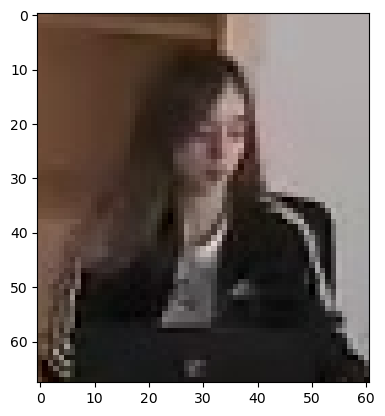

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]
 [1.00000000e+05 4.29501915e+00 4.68443775e+00 1.00000000e+05
  2.18323755e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]]
user: (1, 4) 2.1832375526428223


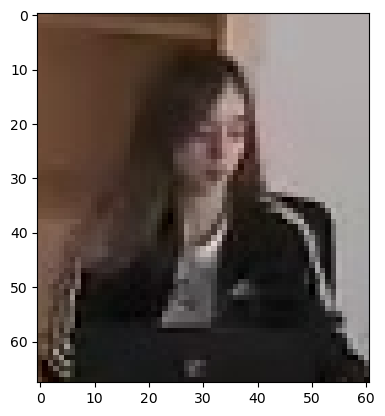

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446291 ['./out/office/raw_cam2/img3D\\1687446291_12.jpg', './out/office/raw_cam2/img3D\\1687446291_5.jpg', './out/office/raw_cam2/img3D\\1687446291_9.jpg']
./out/office/raw_cam2/img/1687446291*12_person.jpg
img.shape 0: (212, 53, 3) 4.0
./out/office/raw_cam2/img/1687446291*5_person.jpg
img.shape 0: (70, 59, 3) 1.1864406779661016
bad image size: 1.1864406779661016
./out/office/raw_cam2/img/1687446291*9_person.jpg
img.shape 0: (170, 62, 3) 2.7419354838709675
new users: -2
img.shape 1: (224, 224, 3)


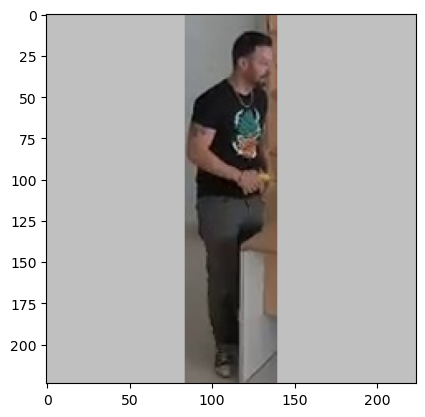

1/1 [==============================] - 0s 117ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.58681679, 2.89081621, 2.65342999, 1.04103518, 3.75092435])]
img.shape 1: (224, 224, 3)


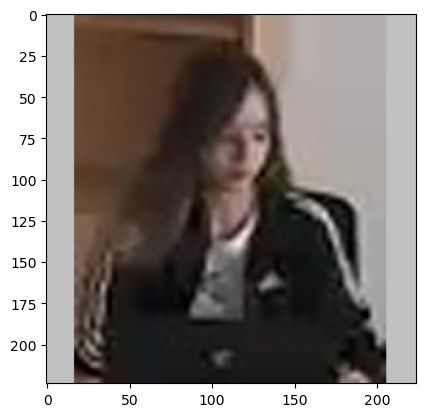

1/1 [==============================] - 0s 116ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.58681679, 2.89081621, 2.65342999, 1.04103518, 3.75092435]), array([0.91166401, 3.55981207, 4.16335487, 2.80749011, 0.96397382])]
img.shape 1: (224, 224, 3)


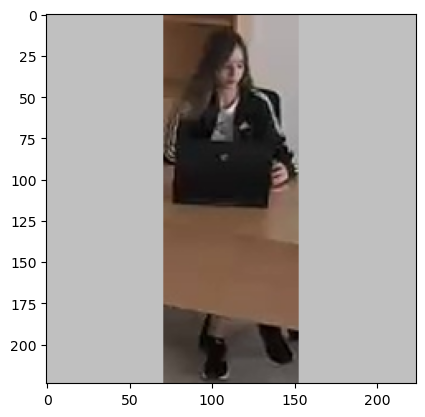

1/1 [==============================] - 0s 104ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.58681679, 2.89081621, 2.65342999, 1.04103518, 3.75092435]), array([0.91166401, 3.55981207, 4.16335487, 2.80749011, 0.96397382]), array([4.78432846, 3.6467979 , 1.14211988, 3.07243252, 4.95433998])]
[[3.58681679 2.89081621 2.65342999 1.04103518 3.75092435]
 [0.91166401 3.55981207 4.16335487 2.80749011 0.96397382]
 [4.78432846 3.6467979  1.14211988 3.07243252 4.95433998]]
user: (1, 0) 0.9116640090942383


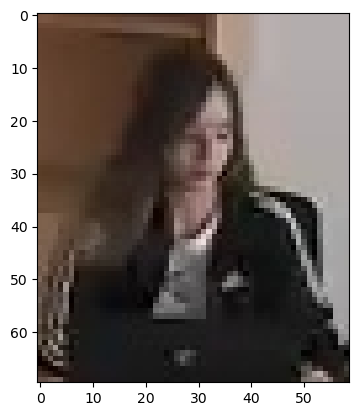

hs- [[1.00000000e+05 2.89081621e+00 2.65342999e+00 1.04103518e+00
  3.75092435e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]
 [1.00000000e+05 3.64679790e+00 1.14211988e+00 3.07243252e+00
  4.95433998e+00]]
user: (0, 3) 1.0410351753234863


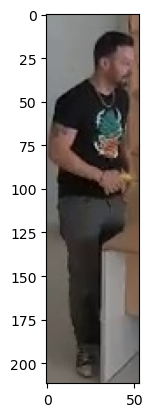

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]
 [1.00000000e+05 3.64679790e+00 1.14211988e+00 1.00000000e+05
  4.95433998e+00]]
user: (2, 2) 1.1421198844909668


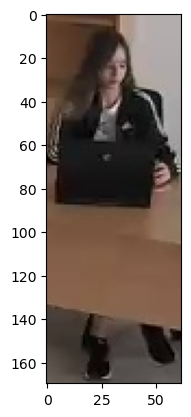

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446292 ['./out/office/raw_cam2/img3D\\1687446292_10.jpg', './out/office/raw_cam2/img3D\\1687446292_12.jpg']
./out/office/raw_cam2/img/1687446292*10_person.jpg
img.shape 0: (169, 75, 3) 2.2533333333333334
./out/office/raw_cam2/img/1687446292*12_person.jpg
img.shape 0: (213, 55, 3) 3.8727272727272726
new users: -3
img.shape 1: (224, 224, 3)


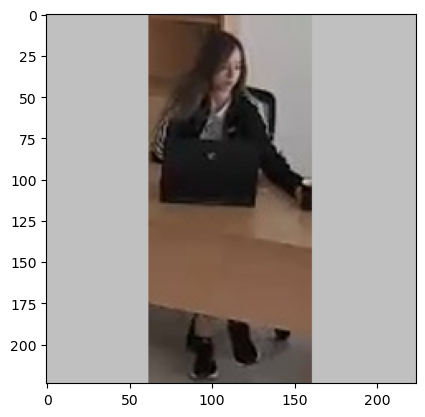

1/1 [==============================] - 0s 112ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.82323217, 3.27255273, 1.61470878, 2.82499194, 4.16158915])]
img.shape 1: (224, 224, 3)


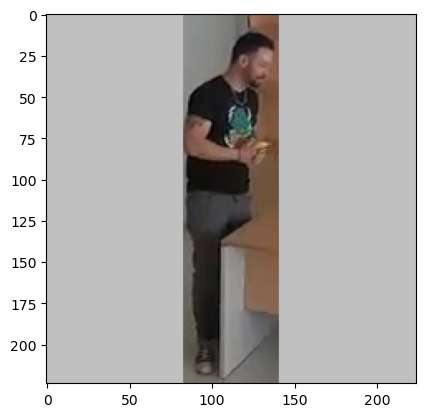

1/1 [==============================] - 0s 126ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.82323217, 3.27255273, 1.61470878, 2.82499194, 4.16158915]), array([3.42087984, 2.92524529, 2.88458967, 0.97489297, 3.74475408])]
[[3.82323217 3.27255273 1.61470878 2.82499194 4.16158915]
 [3.42087984 2.92524529 2.88458967 0.97489297 3.74475408]]
user: (1, 3) 0.9748929738998413


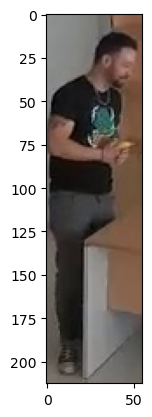

hs- [[3.82323217e+00 3.27255273e+00 1.61470878e+00 1.00000000e+05
  4.16158915e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]]
user: (0, 2) 1.6147087812423706


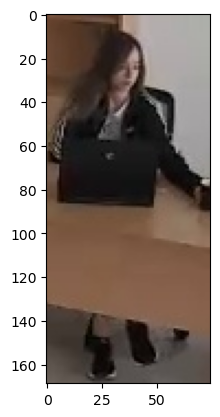

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446293 ['./out/office/raw_cam2/img3D\\1687446293_10.jpg', './out/office/raw_cam2/img3D\\1687446293_11.jpg', './out/office/raw_cam2/img3D\\1687446293_14.jpg']
./out/office/raw_cam2/img/1687446293*10_person.jpg
img.shape 0: (172, 65, 3) 2.646153846153846
./out/office/raw_cam2/img/1687446293*11_person.jpg
img.shape 0: (68, 70, 3) 0.9714285714285714
bad image size: 0.9714285714285714
./out/office/raw_cam2/img/1687446293*14_person.jpg
img.shape 0: (214, 53, 3) 4.037735849056604
new users: -2
img.shape 1: (224, 224, 3)


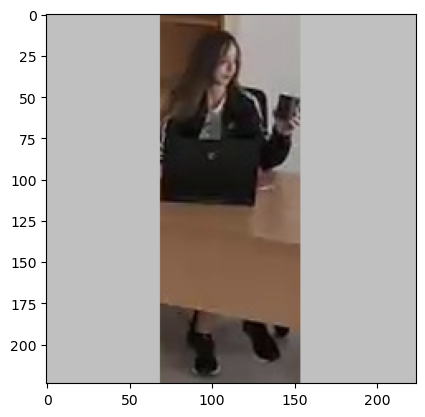

1/1 [==============================] - 0s 111ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([4.25406647, 3.48814726, 0.93677479, 2.66097093, 4.58150578])]
img.shape 1: (224, 224, 3)


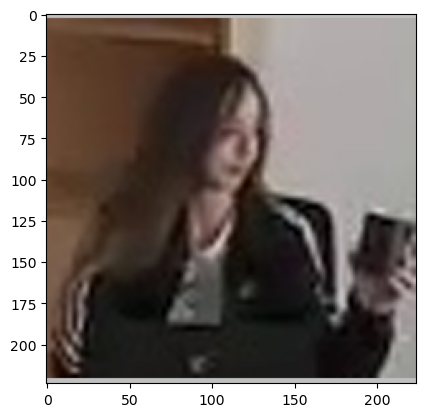

1/1 [==============================] - 0s 104ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([4.25406647, 3.48814726, 0.93677479, 2.66097093, 4.58150578]), array([2.21393347, 3.88664889, 4.09384108, 3.56147838, 2.62988377])]
img.shape 1: (224, 224, 3)


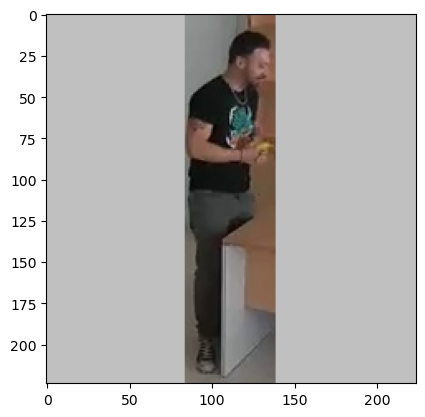

1/1 [==============================] - 0s 108ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([4.25406647, 3.48814726, 0.93677479, 2.66097093, 4.58150578]), array([2.21393347, 3.88664889, 4.09384108, 3.56147838, 2.62988377]), array([3.46267056, 2.96062493, 2.69990826, 0.34295183, 3.80662203])]
[[4.25406647 3.48814726 0.93677479 2.66097093 4.58150578]
 [2.21393347 3.88664889 4.09384108 3.56147838 2.62988377]
 [3.46267056 2.96062493 2.69990826 0.34295183 3.80662203]]
user: (2, 3) 0.34295183420181274


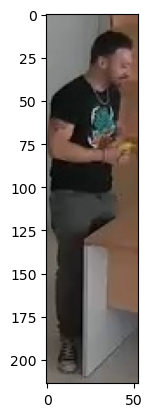

hs- [[4.25406647e+00 3.48814726e+00 9.36774790e-01 1.00000000e+05
  4.58150578e+00]
 [2.21393347e+00 3.88664889e+00 4.09384108e+00 1.00000000e+05
  2.62988377e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]]
user: (0, 2) 0.9367747902870178


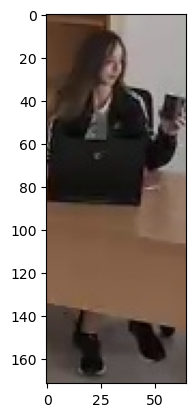

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]
 [2.21393347e+00 3.88664889e+00 1.00000000e+05 1.00000000e+05
  2.62988377e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]]
user: (1, 0) 2.2139334678649902


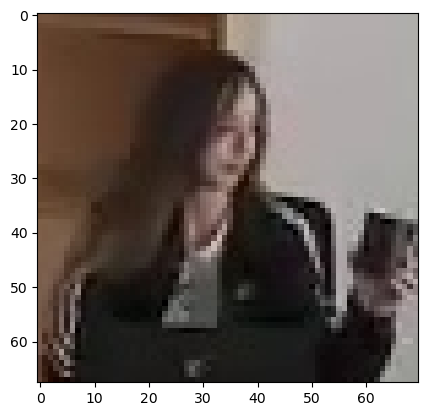

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446294 ['./out/office/raw_cam2/img3D\\1687446294_10.jpg', './out/office/raw_cam2/img3D\\1687446294_12.jpg']
./out/office/raw_cam2/img/1687446294*10_person.jpg
img.shape 0: (172, 62, 3) 2.774193548387097
./out/office/raw_cam2/img/1687446294*12_person.jpg
img.shape 0: (215, 49, 3) 4.387755102040816
new users: -3
img.shape 1: (224, 224, 3)


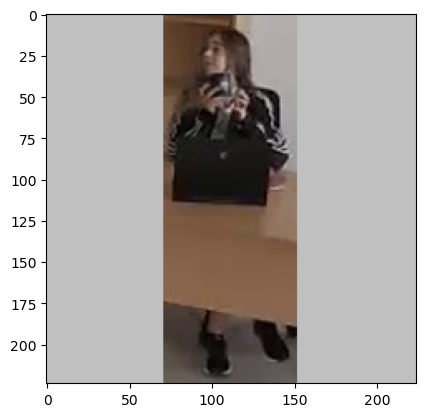

1/1 [==============================] - 0s 103ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.80356431, 3.3806324 , 1.16709638, 2.68873024, 4.2116375 ])]
img.shape 1: (224, 224, 3)


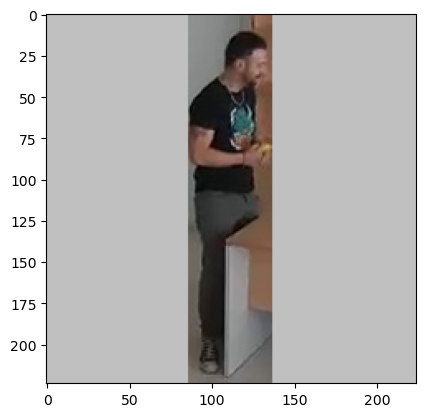

1/1 [==============================] - 0s 106ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.80356431, 3.3806324 , 1.16709638, 2.68873024, 4.2116375 ]), array([3.37876296, 2.98576045, 2.6975162 , 0.42908126, 3.86473727])]
[[3.80356431 3.3806324  1.16709638 2.68873024 4.2116375 ]
 [3.37876296 2.98576045 2.6975162  0.42908126 3.86473727]]
user: (1, 3) 0.4290812611579895


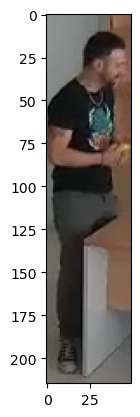

hs- [[3.80356431e+00 3.38063240e+00 1.16709638e+00 1.00000000e+05
  4.21163750e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]]
user: (0, 2) 1.1670963764190674


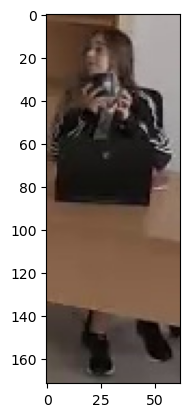

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446295 ['./out/office/raw_cam2/img3D\\1687446295_8.jpg', './out/office/raw_cam2/img3D\\1687446295_9.jpg']
./out/office/raw_cam2/img/1687446295*8_person.jpg
img.shape 0: (166, 66, 3) 2.515151515151515
./out/office/raw_cam2/img/1687446295*9_person.jpg
img.shape 0: (215, 53, 3) 4.056603773584905
new users: -3
img.shape 1: (224, 224, 3)


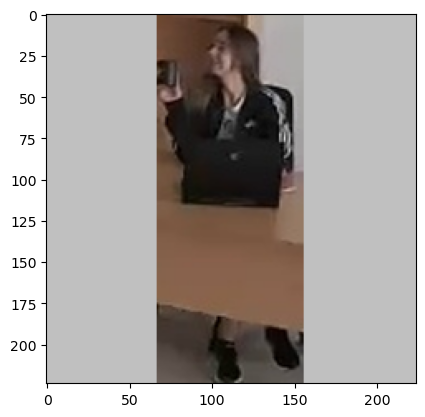

1/1 [==============================] - 0s 117ms/step
Shape of the flattened feature vector: (1, 100352) [[0.         0.         0.         ... 0.16218174 0.         0.        ]]
[array([3.89614868, 3.27247095, 1.13311875, 2.77705693, 4.307024  ])]
img.shape 1: (224, 224, 3)


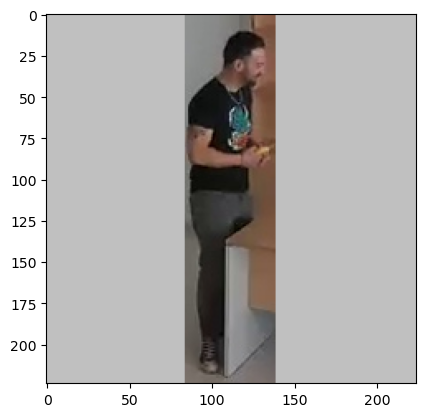

1/1 [==============================] - 0s 119ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.89614868, 3.27247095, 1.13311875, 2.77705693, 4.307024  ]), array([3.13346672, 2.83564162, 2.46542788, 0.28617415, 3.60253406])]
[[3.89614868 3.27247095 1.13311875 2.77705693 4.307024  ]
 [3.13346672 2.83564162 2.46542788 0.28617415 3.60253406]]
user: (1, 3) 0.28617414832115173


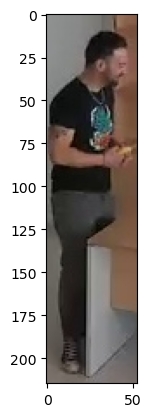

hs- [[3.89614868e+00 3.27247095e+00 1.13311875e+00 1.00000000e+05
  4.30702400e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]]
user: (0, 2) 1.133118748664856


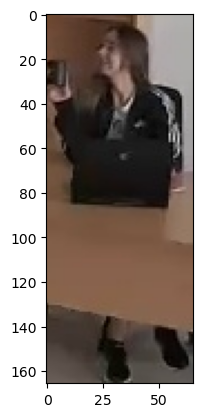

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446296 ['./out/office/raw_cam2/img3D\\1687446296_10.jpg', './out/office/raw_cam2/img3D\\1687446296_9.jpg']
./out/office/raw_cam2/img/1687446296*10_person.jpg
img.shape 0: (216, 69, 3) 3.130434782608696
./out/office/raw_cam2/img/1687446296*9_person.jpg
img.shape 0: (167, 69, 3) 2.420289855072464
new users: -3
img.shape 1: (224, 224, 3)


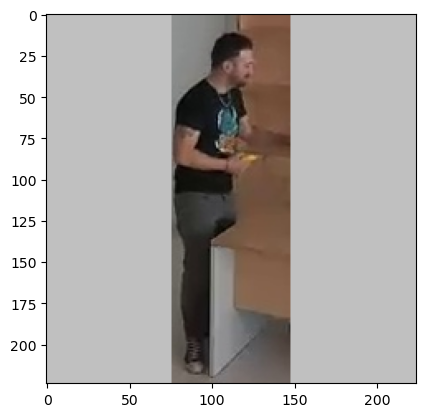

1/1 [==============================] - 0s 104ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.52257776, 3.02389216, 2.62278056, 0.76487547, 4.05032635])]
img.shape 1: (224, 224, 3)


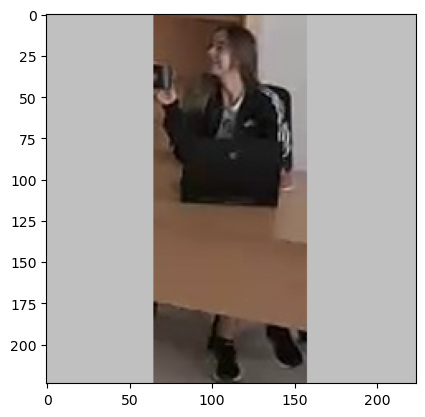

1/1 [==============================] - 0s 113ms/step
Shape of the flattened feature vector: (1, 100352) [[0.         0.         0.         ... 0.30857337 0.         0.        ]]
[array([3.52257776, 3.02389216, 2.62278056, 0.76487547, 4.05032635]), array([4.0581522 , 3.40842772, 0.3549628 , 2.86220026, 4.48180676])]
[[3.52257776 3.02389216 2.62278056 0.76487547 4.05032635]
 [4.0581522  3.40842772 0.3549628  2.86220026 4.48180676]]
user: (1, 2) 0.3549627959728241


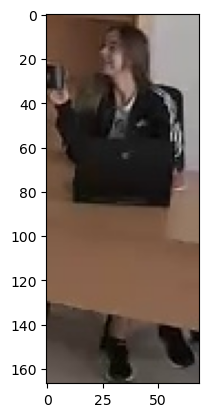

hs- [[3.52257776e+00 3.02389216e+00 1.00000000e+05 7.64875472e-01
  4.05032635e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]]
user: (0, 3) 0.7648754715919495


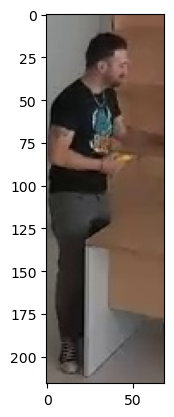

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446297 ['./out/office/raw_cam2/img3D\\1687446297_11.jpg', './out/office/raw_cam2/img3D\\1687446297_2.jpg', './out/office/raw_cam2/img3D\\1687446297_5.jpg']
./out/office/raw_cam2/img/1687446297*11_person.jpg
img.shape 0: (214, 64, 3) 3.34375
./out/office/raw_cam2/img/1687446297*2_person.jpg
img.shape 0: (165, 62, 3) 2.661290322580645
./out/office/raw_cam2/img/1687446297*5_person.jpg
img.shape 0: (66, 59, 3) 1.11864406779661
bad image size: 1.11864406779661
new users: -2
img.shape 1: (224, 224, 3)


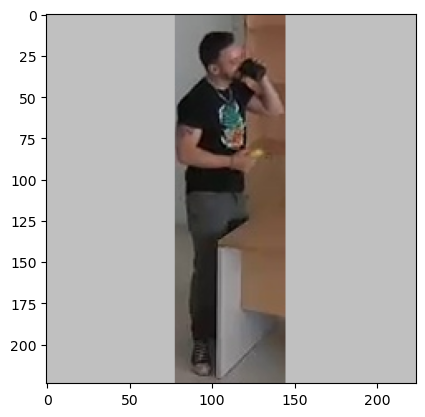

1/1 [==============================] - 0s 107ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.44303894, 3.055372  , 2.78883076, 0.6058771 , 3.97205615])]
img.shape 1: (224, 224, 3)


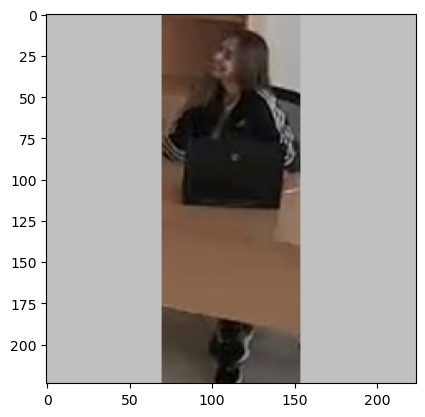

1/1 [==============================] - 0s 96ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.44303894, 3.055372  , 2.78883076, 0.6058771 , 3.97205615]), array([3.82631564, 3.30068874, 1.00130987, 2.67538643, 4.26020193])]
img.shape 1: (224, 224, 3)


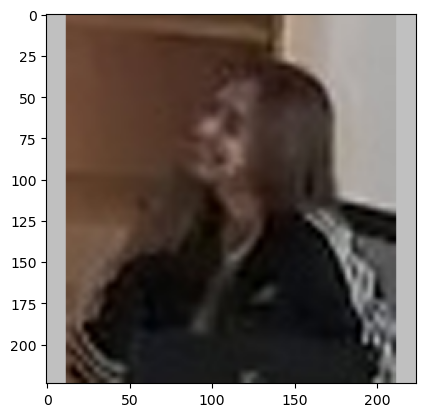

1/1 [==============================] - 0s 113ms/step
Shape of the flattened feature vector: (1, 100352) [[0.        0.        0.        ... 0.        0.        0.9220481]]
[array([3.44303894, 3.055372  , 2.78883076, 0.6058771 , 3.97205615]), array([3.82631564, 3.30068874, 1.00130987, 2.67538643, 4.26020193]), array([2.17656255, 3.70462823, 4.1090126 , 3.6748569 , 1.89304399])]
[[3.44303894 3.055372   2.78883076 0.6058771  3.97205615]
 [3.82631564 3.30068874 1.00130987 2.67538643 4.26020193]
 [2.17656255 3.70462823 4.1090126  3.6748569  1.89304399]]
user: (0, 3) 0.6058771014213562


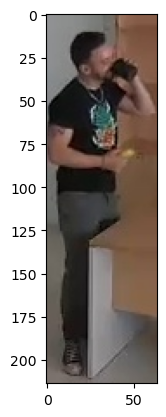

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]
 [3.82631564e+00 3.30068874e+00 1.00130987e+00 1.00000000e+05
  4.26020193e+00]
 [2.17656255e+00 3.70462823e+00 4.10901260e+00 1.00000000e+05
  1.89304399e+00]]
user: (1, 2) 1.001309871673584


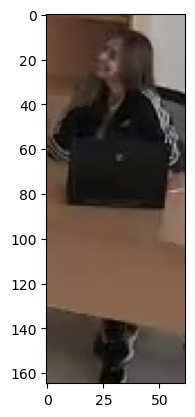

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]
 [2.17656255e+00 3.70462823e+00 1.00000000e+05 1.00000000e+05
  1.89304399e+00]]
user: (2, 4) 1.8930439949035645


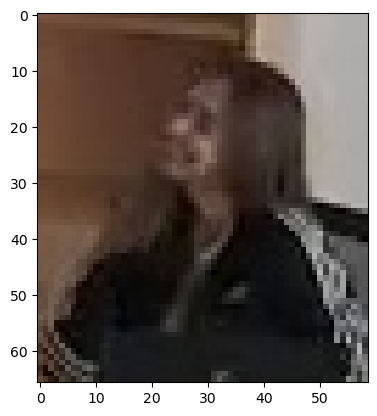

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446298 ['./out/office/raw_cam2/img3D\\1687446298_10.jpg']
./out/office/raw_cam2/img/1687446298*10_person.jpg
img.shape 0: (215, 54, 3) 3.9814814814814814
new users: -4
img.shape 1: (224, 224, 3)


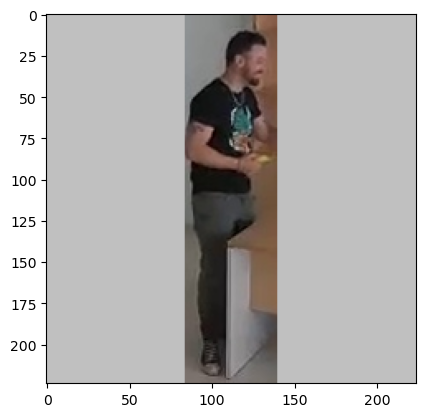

1/1 [==============================] - 0s 113ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.1409514 , 2.82969785, 2.38500738, 0.62145847, 3.22223902])]
[[3.1409514  2.82969785 2.38500738 0.62145847 3.22223902]]
user: (0, 3) 0.6214584708213806


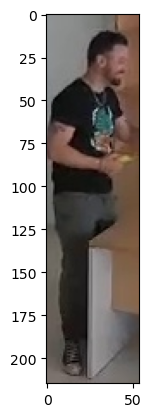

hs- [[100000. 100000. 100000. 100000. 100000.]]
1687446299 ['./out/office/raw_cam2/img3D\\1687446299_10.jpg']
./out/office/raw_cam2/img/1687446299*10_person.jpg
img.shape 0: (215, 83, 3) 2.5903614457831323
new users: -4
img.shape 1: (224, 224, 3)


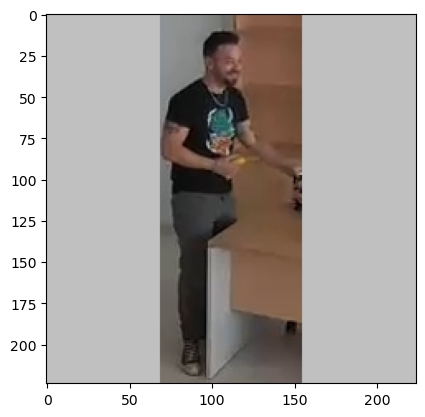

1/1 [==============================] - 0s 124ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.65124035, 2.94241858, 2.41578603, 1.17283034, 3.69166446])]
[[3.65124035 2.94241858 2.41578603 1.17283034 3.69166446]]
user: (0, 3) 1.17283034324646


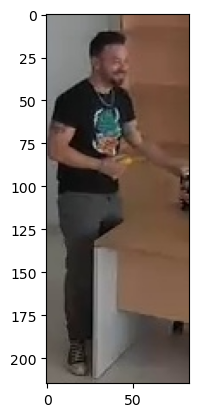

hs- [[100000. 100000. 100000. 100000. 100000.]]
1687446300 ['./out/office/raw_cam2/img3D\\1687446300_10.jpg', './out/office/raw_cam2/img3D\\1687446300_11.jpg']
./out/office/raw_cam2/img/1687446300*10_person.jpg
img.shape 0: (68, 62, 3) 1.096774193548387
bad image size: 1.096774193548387
./out/office/raw_cam2/img/1687446300*11_person.jpg
img.shape 0: (191, 52, 3) 3.673076923076923
new users: -3
img.shape 1: (224, 224, 3)


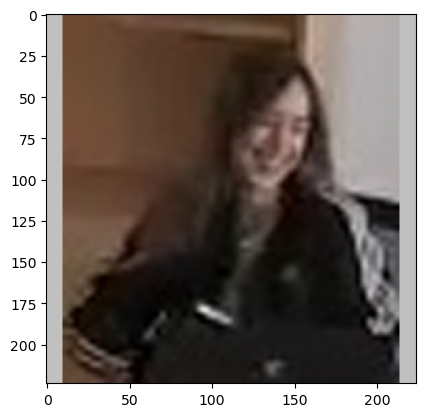

1/1 [==============================] - 0s 94ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.42046833, 3.77623701, 3.98556042, 3.81109095, 1.65143931])]
img.shape 1: (224, 224, 3)


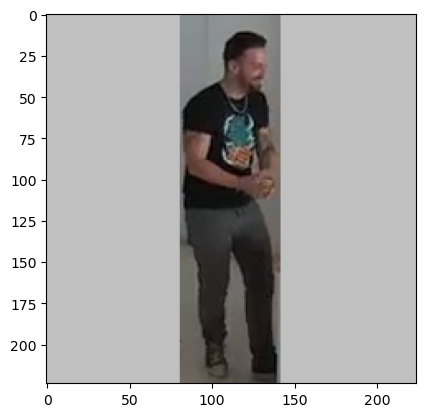

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.42046833, 3.77623701, 3.98556042, 3.81109095, 1.65143931]), array([3.07929754, 2.87166047, 2.63312197, 1.49484825, 3.12253499])]
[[2.42046833 3.77623701 3.98556042 3.81109095 1.65143931]
 [3.07929754 2.87166047 2.63312197 1.49484825 3.12253499]]
user: (1, 3) 1.4948482513427734


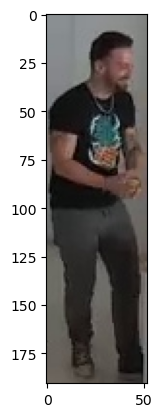

hs- [[2.42046833e+00 3.77623701e+00 3.98556042e+00 1.00000000e+05
  1.65143931e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]]
user: (0, 4) 1.6514393091201782


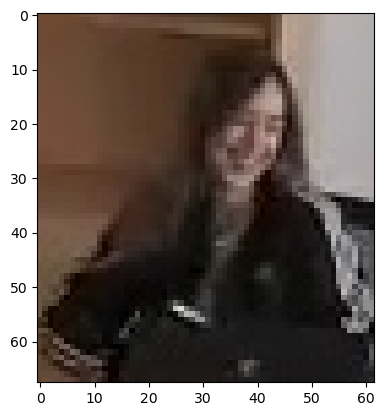

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446301 ['./out/office/raw_cam2/img3D\\1687446301_8.jpg']
./out/office/raw_cam2/img/1687446301*8_person.jpg
img.shape 0: (194, 53, 3) 3.660377358490566
new users: -4
img.shape 1: (224, 224, 3)


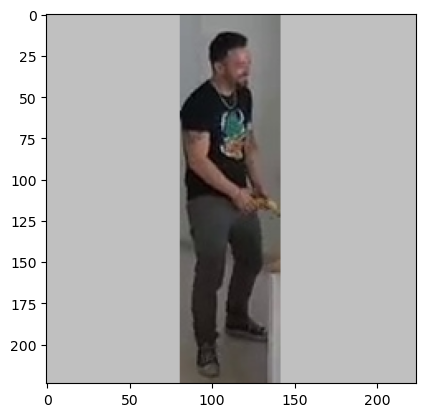

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([3.0286715 , 2.67627883, 2.57641482, 0.61383337, 3.19541764])]
[[3.0286715  2.67627883 2.57641482 0.61383337 3.19541764]]
user: (0, 3) 0.6138333678245544


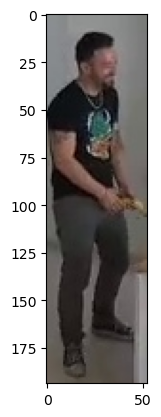

hs- [[100000. 100000. 100000. 100000. 100000.]]
1687446302 ['./out/office/raw_cam2/img3D\\1687446302_13.jpg', './out/office/raw_cam2/img3D\\1687446302_5.jpg']
./out/office/raw_cam2/img/1687446302*13_person.jpg
img.shape 0: (179, 56, 3) 3.1964285714285716
./out/office/raw_cam2/img/1687446302*5_person.jpg
img.shape 0: (175, 75, 3) 2.3333333333333335
new users: -3
img.shape 1: (224, 224, 3)


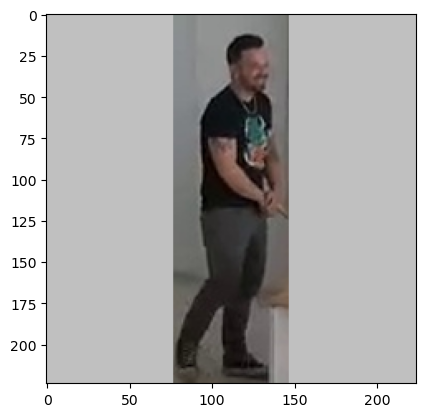

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.78504944, 2.5882256 , 2.34240389, 0.60112613, 2.91408992])]
img.shape 1: (224, 224, 3)


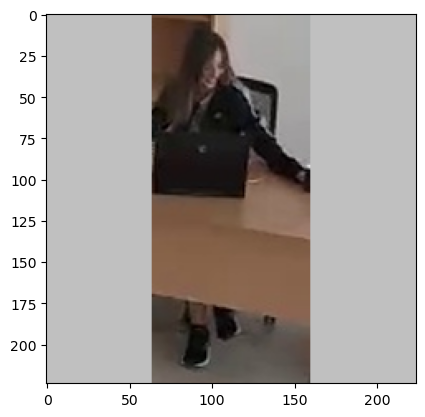

1/1 [==============================] - 0s 94ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.78504944, 2.5882256 , 2.34240389, 0.60112613, 2.91408992]), array([4.23166084, 3.69385386, 1.76090956, 3.25903511, 4.24356413])]
[[2.78504944 2.5882256  2.34240389 0.60112613 2.91408992]
 [4.23166084 3.69385386 1.76090956 3.25903511 4.24356413]]
user: (0, 3) 0.6011261343955994


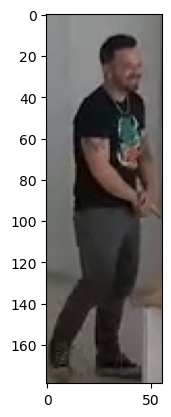

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]
 [4.23166084e+00 3.69385386e+00 1.76090956e+00 1.00000000e+05
  4.24356413e+00]]
user: (1, 2) 1.7609095573425293


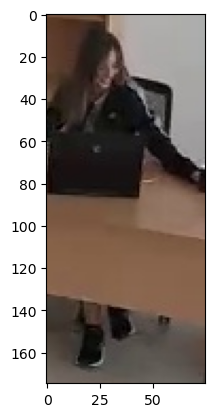

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446303 ['./out/office/raw_cam2/img3D\\1687446303_10.jpg']
./out/office/raw_cam2/img/1687446303*10_person.jpg
img.shape 0: (177, 54, 3) 3.2777777777777777
new users: -4
img.shape 1: (224, 224, 3)


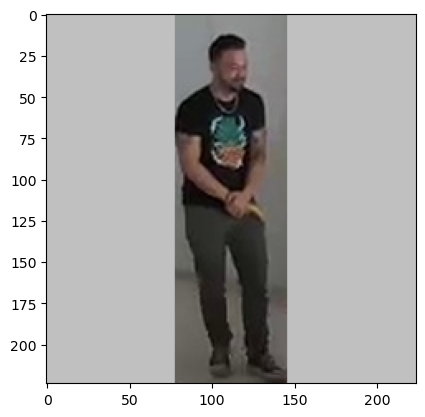

1/1 [==============================] - 0s 118ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.75545931, 2.63030624, 2.82756996, 0.58451545, 2.9537518 ])]
[[2.75545931 2.63030624 2.82756996 0.58451545 2.9537518 ]]
user: (0, 3) 0.5845154523849487


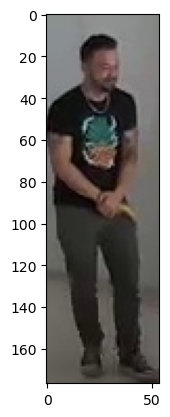

hs- [[100000. 100000. 100000. 100000. 100000.]]
1687446304 ['./out/office/raw_cam2/img3D\\1687446304_12.jpg', './out/office/raw_cam2/img3D\\1687446304_8.jpg']
./out/office/raw_cam2/img/1687446304*12_person.jpg
img.shape 0: (178, 54, 3) 3.2962962962962963
./out/office/raw_cam2/img/1687446304*8_person.jpg
img.shape 0: (80, 66, 3) 1.2121212121212122
bad image size: 1.2121212121212122
new users: -3
img.shape 1: (224, 224, 3)


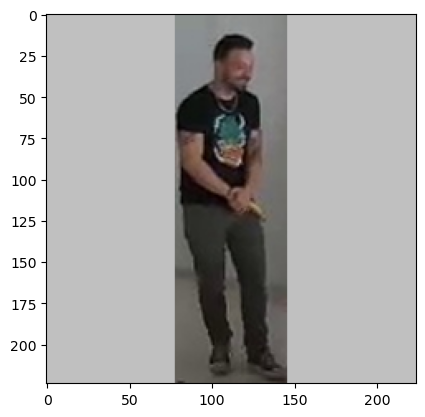

1/1 [==============================] - 0s 110ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.78867173, 2.63947487, 2.77685666, 0.15000889, 2.93953514])]
img.shape 1: (224, 224, 3)


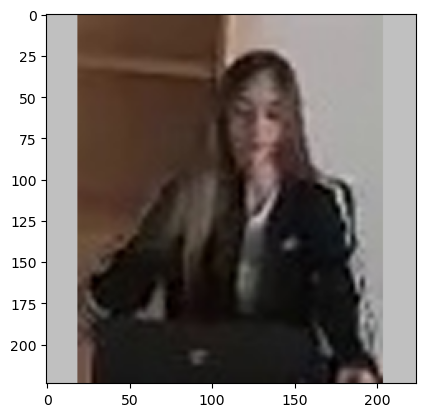

1/1 [==============================] - 0s 105ms/step
Shape of the flattened feature vector: (1, 100352) [[0.         0.         0.         ... 0.08689988 0.         0.        ]]
[array([2.78867173, 2.63947487, 2.77685666, 0.15000889, 2.93953514]), array([2.34026623, 4.00062943, 4.41342878, 3.32962227, 1.97813606])]
[[2.78867173 2.63947487 2.77685666 0.15000889 2.93953514]
 [2.34026623 4.00062943 4.41342878 3.32962227 1.97813606]]
user: (0, 3) 0.150008887052536


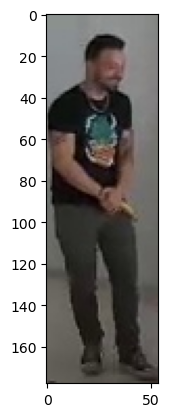

hs- [[1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]
 [2.34026623e+00 4.00062943e+00 4.41342878e+00 1.00000000e+05
  1.97813606e+00]]
user: (1, 4) 1.9781360626220703


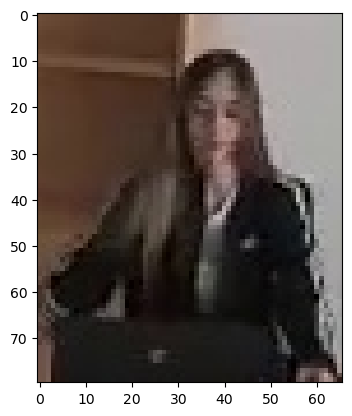

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446305 ['./out/office/raw_cam2/img3D\\1687446305_9.jpg']
./out/office/raw_cam2/img/1687446305*9_person.jpg
img.shape 0: (178, 53, 3) 3.358490566037736
new users: -4
img.shape 1: (224, 224, 3)


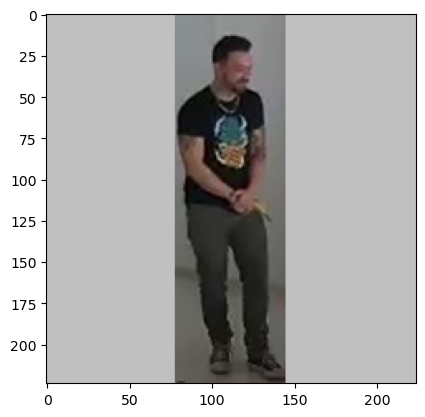

1/1 [==============================] - 0s 111ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.87709951, 2.66476154, 2.89612699, 0.19519816, 3.08078599])]
[[2.87709951 2.66476154 2.89612699 0.19519816 3.08078599]]
user: (0, 3) 0.1951981633901596


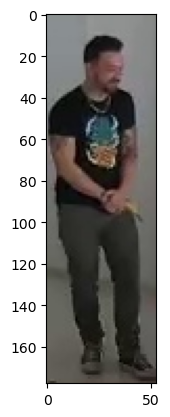

hs- [[100000. 100000. 100000. 100000. 100000.]]
1687446306 ['./out/office/raw_cam2/img3D\\1687446306_6.jpg', './out/office/raw_cam2/img3D\\1687446306_8.jpg']
./out/office/raw_cam2/img/1687446306*6_person.jpg
img.shape 0: (110, 59, 3) 1.8644067796610169
./out/office/raw_cam2/img/1687446306*8_person.jpg
img.shape 0: (183, 48, 3) 3.8125
new users: -3
img.shape 1: (224, 224, 3)


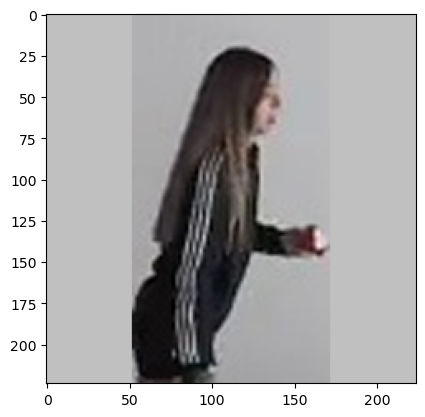

1/1 [==============================] - 0s 114ms/step
Shape of the flattened feature vector: (1, 100352) [[0.         0.         0.         ... 0.36422157 0.         0.        ]]
[array([2.72215796, 2.99127674, 3.52131081, 2.62691307, 2.75603628])]
img.shape 1: (224, 224, 3)


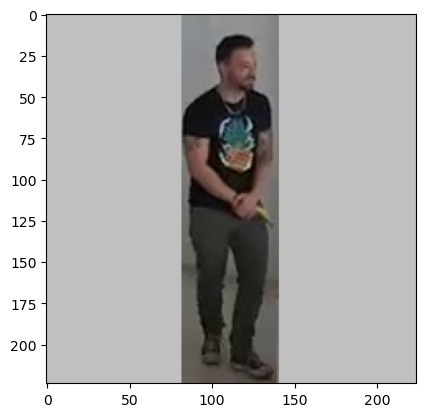

1/1 [==============================] - 0s 105ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([2.72215796, 2.99127674, 3.52131081, 2.62691307, 2.75603628]), array([2.83703732, 2.70893264, 2.8579762 , 0.24301842, 2.98905039])]
[[2.72215796 2.99127674 3.52131081 2.62691307 2.75603628]
 [2.83703732 2.70893264 2.8579762  0.24301842 2.98905039]]
user: (1, 3) 0.24301841855049133


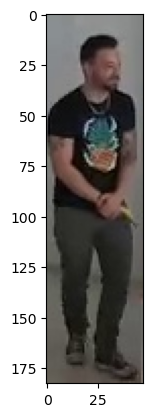

hs- [[2.72215796e+00 2.99127674e+00 3.52131081e+00 1.00000000e+05
  2.75603628e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]]
user: (0, 0) 2.7221579551696777


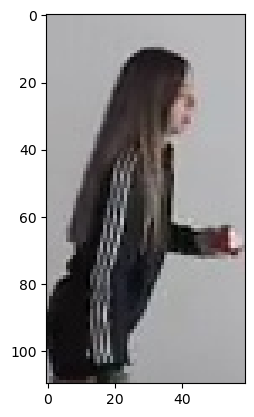

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446307 ['./out/office/raw_cam2/img3D\\1687446307_5.jpg', './out/office/raw_cam2/img3D\\1687446307_7.jpg']
./out/office/raw_cam2/img/1687446307*5_person.jpg
img.shape 0: (182, 62, 3) 2.935483870967742
./out/office/raw_cam2/img/1687446307*7_person.jpg
img.shape 0: (199, 51, 3) 3.9019607843137254
new users: -3
img.shape 1: (224, 224, 3)


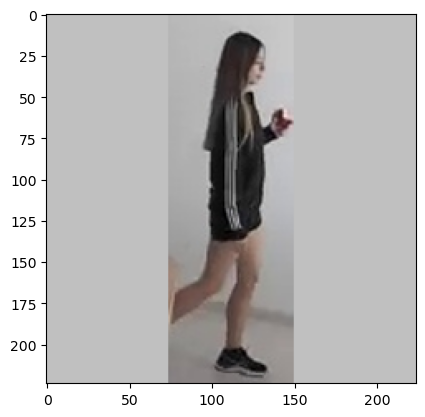

1/1 [==============================] - 0s 116ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.83989048, 2.8581841 , 2.85490537, 1.84838021, 3.03115273])]
img.shape 1: (224, 224, 3)


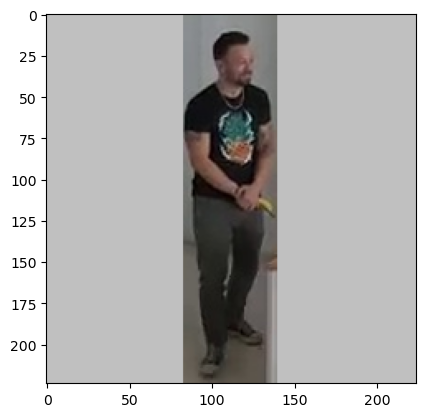

1/1 [==============================] - 0s 98ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.83989048, 2.8581841 , 2.85490537, 1.84838021, 3.03115273]), array([2.27168107, 2.8033278 , 2.93416119, 0.40414628, 3.1714468 ])]
[[1.83989048 2.8581841  2.85490537 1.84838021 3.03115273]
 [2.27168107 2.8033278  2.93416119 0.40414628 3.1714468 ]]
user: (1, 3) 0.404146283864975


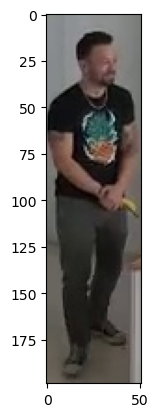

hs- [[1.83989048e+00 2.85818410e+00 2.85490537e+00 1.00000000e+05
  3.03115273e+00]
 [1.00000000e+05 1.00000000e+05 1.00000000e+05 1.00000000e+05
  1.00000000e+05]]
user: (0, 0) 1.839890480041504


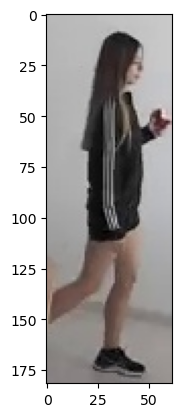

hs- [[100000. 100000. 100000. 100000. 100000.]
 [100000. 100000. 100000. 100000. 100000.]]
1687446308 ['./out/office/raw_cam2/img3D\\1687446308_5.jpg']
./out/office/raw_cam2/img/1687446308*5_person.jpg
img.shape 0: (214, 56, 3) 3.8214285714285716
new users: -4
img.shape 1: (224, 224, 3)


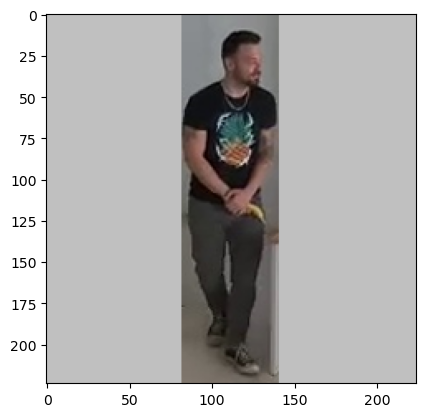

1/1 [==============================] - 0s 106ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.8106612 , 2.73502207, 2.80079746, 0.36885011, 3.14893866])]
[[1.8106612  2.73502207 2.80079746 0.36885011 3.14893866]]
user: (0, 3) 0.36885011196136475


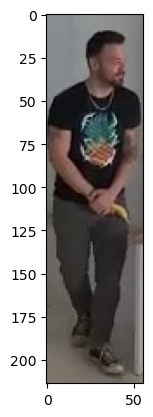

hs- [[100000. 100000. 100000. 100000. 100000.]]
1687446309 ['./out/office/raw_cam2/img3D\\1687446309_7.jpg']
./out/office/raw_cam2/img/1687446309*7_person.jpg
img.shape 0: (224, 59, 3) 3.7966101694915255
new users: -4
img.shape 1: (224, 224, 3)


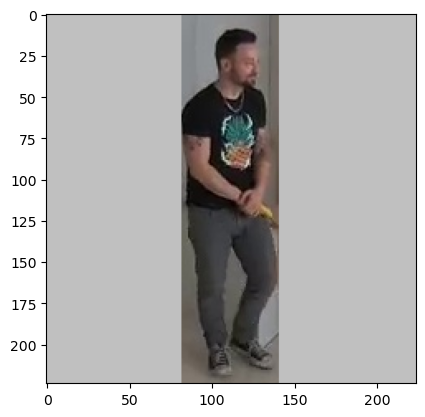

1/1 [==============================] - 0s 111ms/step
Shape of the flattened feature vector: (1, 100352) [[0. 0. 0. ... 0. 0. 0.]]
[array([1.73145819, 2.83947659, 2.93592715, 0.44061583, 3.13380837])]
[[1.73145819 2.83947659 2.93592715 0.44061583 3.13380837]]
user: (0, 3) 0.44061583280563354


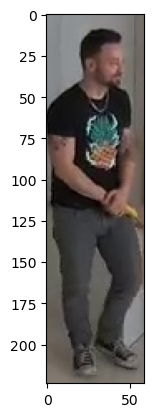

hs- [[100000. 100000. 100000. 100000. 100000.]]


In [5]:
import glob


file = open(path0+"tracking.txt", "w")


import shutil
if os.path.exists(path0+"users") and os.path.isdir(path0+"users"):
    shutil.rmtree(path0+"users")
os.makedirs(path0+"users", exist_ok=True)

usersH=[]

for time in times:
    
    jpgFilenamesList = glob.glob(dir_path+time+"*.jpg")

    print(time,str(jpgFilenamesList))
    
    if not jpgFilenamesList:
        continue
    hs=[]
    hv=[]
    img_src=[]
    listf0=[]
    for f in jpgFilenamesList:
        f0=f[f.rfind("_")+len("_"):f.rfind(".")]
        print(dir_path0+time+"*"+f0+"_person.jpg")
        listf0.append(f0)
        jpg0 = glob.glob(dir_path0+time+"*"+f0+"_person.jpg")[0]
        img = cv2.imread(jpg0)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
         #plt.imshow(img)
        ih,iw,_=img.shape
        print("img.shape 0:",str(img.shape),float(ih)/float(iw))
        if(float(ih)/float(iw)<1.75):
            print("bad image size:",float(ih)/float(iw))
            #continue
        img_src.append(img)
    
        
    new_users=len(img_src)-len(usersH)
    print("new users:",new_users)
    if(new_users<0):
        new_users=0
    padding_new=np.ones(new_users)*(alphaH+1.0)
    for img in img_src:
        h=getH(img)
        
        hs.append(np.append(closerH(usersH,h),padding_new))
        hv.append(h)
        print(hs)
    hs=np.array(hs)
    print(hs)
    file.write(time)
    while hs.size:
 #       if(not hs.size):
 #           i=len(usersH)-1
 #           if len(hv)>0:
 #               usersH.append(hv[0])
 #               print("New user!")
 #           break
 #       else:
        ij_min = np.unravel_index(hs.argmin(), hs.shape)
        
        i=ij_min[0]
        j=ij_min[1]
        print("user:",ij_min, hs[ij_min])
        new_user=j
        plt.imshow(img_src[i])
        plt.show()
        if (hs[np.unravel_index(hs.argmin(), hs.shape)]>alphaH):
            usersH.append(hv[i])
            new_user=len(usersH)-1
            print("New user!")
        
        #print("usersH[j]:",usersH[j])
        usersH[j]=usersH[j]*0.25+hv[i]*0.75
        
        os.makedirs(path0+"users/"+str(new_user), exist_ok=True)
        cv2.imwrite(path0+"users/"+str(new_user)+"/"+time+"_"+str(listf0[i])+ '.jpg', cv2.cvtColor(img_src[i], cv2.COLOR_RGB2BGR))
        
        #print("usersH[j]:",usersH[j])
        file.write("\t"+str(ij_min))
        hs[i]=100000
        hs[:,j]=100000
        print("hs-",hs)
        if(hs.min()==100000):
            break
            

        
    file.write("\n")

        
        
file.close()    